- Author (except cells that contain prompt): Amirhossein Kiani

In [ ]:
# prompt: give me a code that connects to my drive

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pickle
import json
import geopandas as gpd
from shapely.wkt import loads
from pyproj import Proj, Transformer
from tqdm import tqdm

In [2]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import pandas as pd

data = pd.read_csv("20181024_d1_0830_0900_segmented_cell_20.csv")

<Axes: xlabel='time'>

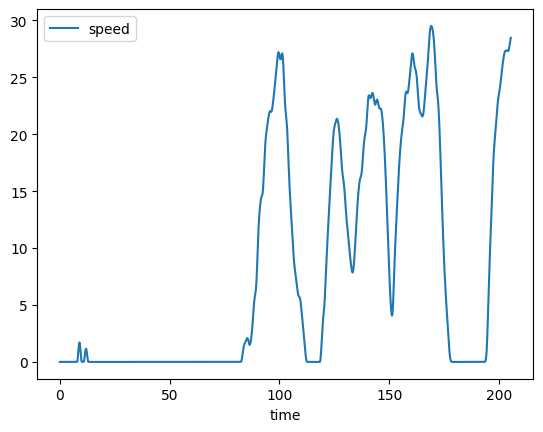

In [43]:
data[data['veh_id'] == 64].plot(x="time", y="speed")

In [44]:
import json
traffic_light_states_path = "20181024_d1_0830_0900_traffic_light_states.json"
with open(traffic_light_states_path, "r") as f:
  traffic_light_states = json.load(f)

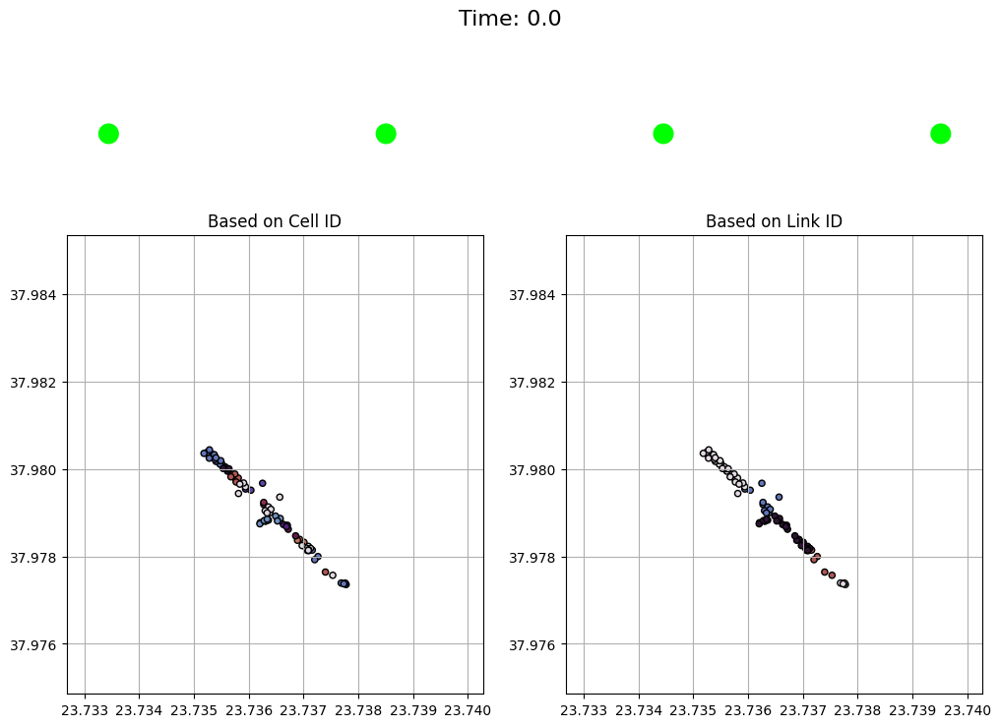

In [5]:
grouped = data.groupby('time')
grouped_dict = {}
for time, group in grouped:
  grouped_dict[time] = group
from os import times
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

import hashlib
max_link_id = data["link_id"].values.max()
max_cell_id = {link_id:pd.to_numeric(data[data["link_id"] == link_id]["closest_cell"].str.extract(r'(\d+)')[0], errors='coerce').max() for link_id in data["link_id"].unique()}
first_df = grouped_dict[list(grouped_dict.keys())[0]]

def color_finder_link(link_id):
    # Convert hash to an integer
    return link_id / max_link_id  # Normalize to range [0,1]

def color_finder_cell(cell_id, link_id):
  cell_id = int(cell_id.split("_")[1])
  return cell_id / max_cell_id[link_id]  # Normalize to range [0,1]

fig = plt.figure(figsize=(12, 8))

# Create GridSpec to control layout
gs = fig.add_gridspec(2, 2, height_ratios=[1, 5])  # 1 row for legend, 5 for plots

# Create legend axis spanning both columns
legend_ax = fig.add_subplot(gs[0, :])  # Full-width top row

# Create the main plots below
ax = fig.add_subplot(gs[1, 0])  # Left plot
ax2 = fig.add_subplot(gs[1, 1])  # Right plot

scatter = ax.scatter([], [], c=[], s=20, cmap="twilight", edgecolor="k", vmin=0, vmax=1)
scatter2 = ax2.scatter([], [], c=[], s=20, cmap="twilight", edgecolor="k", vmin=0, vmax=1)
x_min = min(first_df["lon"].values)
x_max = max(first_df["lon"].values)
y_min = min(first_df["lat"].values)
y_max = min(first_df["lat"].values)
ax.axis([x_min-0.0025, x_max + 0.0025, y_min-0.0025, y_max+0.008])
ax2.axis([x_min-0.0025, x_max + 0.0025, y_min-0.0025, y_max+0.008])


# Traffic Light Indicator Positions
traffic_light_labels = ["1", "2", "3", "4"]
traffic_light_positions = np.linspace(0.2, 0.8, 4)  # Evenly spaced

# Create traffic light legend (scatter plot)
traffic_light_legend = legend_ax.scatter(
    traffic_light_positions, [0.5] * 4,  # Fixed y-position
    s=200, edgecolor="black", zorder=3
)
traffic_light_labels = list(traffic_light_states.keys())
# Add Text Labels
# for i, (pos, label) in enumerate(zip(traffic_light_positions, traffic_light_labels)):
#     legend_ax.text(pos, 0.7, label, ha="center", fontsize=12, fontweight="bold")

# Hide axes for cleaner display
legend_ax.set_xticks([])
legend_ax.set_yticks([])
legend_ax.set_frame_on(False)



# Function to generate random data
def generate_data(frame):
    timestamp = list(grouped_dict.keys())[frame]

    dataframe = grouped_dict[timestamp]
    x = dataframe["lon"].values
    y = dataframe["lat"].values
    colors = [color_finder_cell(row["closest_cell"], row["link_id"]) for index, row in dataframe[["closest_cell", "link_id"]].iterrows()]
    colors2 = [color_finder_link(link_id) for link_id in dataframe["link_id"].values]
    fig.suptitle(f"Time: {timestamp}", fontsize=16)

    tl_states = [traffic_light_states[tl][str(timestamp)] for tl in traffic_light_labels]

    return x, y, colors, colors2, tl_states

# Animation update function
def update(frame):
    x, y, colors, colors2, tl_states = generate_data(frame)
    # print(x, y)
    scatter.set_offsets(np.column_stack((x, y)))
    scatter2.set_offsets(np.column_stack((x, y)))
    scatter.set_array(colors)
    scatter2.set_array(colors2)


    # Traffic Light Colors Mapping
    color_map = {"red": "red", "yellow": "yellow", "green": "lime"}
    tl_colors = [color_map[state] for state in tl_states]

    # Update legend colors dynamically
    traffic_light_legend.set_color(tl_colors)


    if frame % 100 == 0:
      pass
      # print(f"Frame: {frame}")
    return scatter, scatter2



ani = animation.FuncAnimation(fig, update, frames=range(0, 2000, 10), interval=100, blit=False)
ax.grid()
ax.set_title("Based on Cell ID")
ax2.grid()
ax2.set_title("Based on Link ID")
ani.save("first_animation.gif", writer="pillow")

Things that should be done here now: Vehicles that do not move for more than a threshold of a time, they should be removed (These are the vehicles that are just stopped there). Vehicles that are in the network for a short period of time should be removed (These are the vehicels that are on the minor roads).

## Removing stopped vehicles for a long time

In [45]:
modified_data = data.copy()
modified_data["stopped"] = modified_data["speed"] <0.5

In [6]:
print(modified_data["stopped"].shape)

(1115523,)


In [7]:
# prompt: modified_data["stopped"] is either true or false. If a vehicles is stopped more than 50 seconds (THRESHOLD) I want it all rows for tat amount of time to be eliminated

THRESHOLD = 25  # seconds

# Group by 'veh_id' and 'link_id'
grouped_vehicles = modified_data.groupby(['veh_id', 'link_id'])

# Initialize an empty list to store the indices of rows to remove
indices_to_remove = []

for (veh_id, link_id), group in grouped_vehicles:
    # Find consecutive stopped periods
    stopped_periods = []
    current_period_start = None
    for index, row in group.iterrows():
        if row['stopped']:
            if current_period_start is None:
                current_period_start = index
        elif current_period_start is not None:
            stopped_periods.append((current_period_start, index - 1))  # Store the start and end indices
            current_period_start = None
    if current_period_start is not None:
        stopped_periods.append((current_period_start, group.index[-1])) # Handling case where vehicle is stopped at end of its trajectory

    # Identify and store indices of long stopped periods to remove
    for start_index, end_index in stopped_periods:
        duration = (group.loc[end_index, 'time'] - group.loc[start_index, 'time'])
        if duration > THRESHOLD:
            indices_to_remove.extend(range(start_index, end_index+1))

# Remove the identified rows from the DataFrame
# modified_data = modified_data.drop(index=indices_to_remove)


In [8]:
remvoed_long_stopped_data = modified_data.drop(index=indices_to_remove)

In [46]:
print(modified_data.shape)

(1115523, 13)


## Remove vehilces that appear on minor road

In [52]:
import numpy as np

def calculate_bearing(lat1, lon1, lat2, lon2):
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    delta_lon = lon2 - lon1

    x = np.sin(delta_lon) * np.cos(lat2)
    y = np.cos(lat1) * np.sin(lat2) - np.sin(lat1) * np.cos(lat2) * np.cos(delta_lon)

    bearing = np.degrees(np.arctan2(x, y))
    return (bearing + 360) % 360

# Example:
lat1, lon1 = 44.9727, -93.2354  # Point 1
lat2, lon2 = 44.9730, -93.2360  # Point 2
direction = calculate_bearing(lat1, lon1, lat2, lon2)
print(f"Bearing: {direction:.2f}°")

Bearing: 305.25°


In [53]:
fully_modified_data = modified_data.copy().sort_values(by=["veh_id", "time"])
fully_modified_data[["lat_shifted", "shifted_lon", "veh_id_shifted"]] = fully_modified_data.shift(1)[["lat", "lon", "veh_id"]]
bearings = []

for index, row in fully_modified_data.iterrows():
  bearing = 0
  if row["veh_id"] == row["veh_id_shifted"]:
    bearing = calculate_bearing(row["lat"], row["lon"], row["lat_shifted"], row["shifted_lon"])
  bearings.append(bearing)
fully_modified_data["bearing"] = bearings

<Axes: xlabel='lat'>

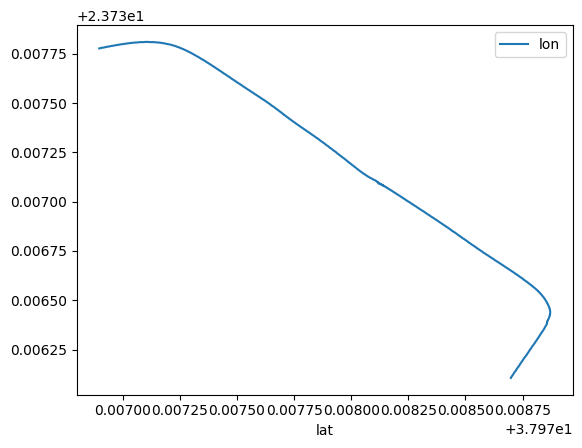

In [55]:
fully_modified_data[fully_modified_data["veh_id"] == 200].plot(x="lat", y="lon")


In [63]:
c = fully_modified_data[fully_modified_data["veh_id"] == 884]
c[(c["bearing"] != 0) & (c["bearing"] > 90)].shape

(0, 17)

## Filtering with bearing

In [ ]:
to_be_removed = []
for veh_id, group in fully_modified_data.groupby("veh_id"):
    length = group[(group["bearing"] != 0) & (group["bearing"] > 90)].shape[0]
    if length == 0:
      to_be_removed.append(index)

,Unnamed: 0,lat,lon,speed,lon_acc,lat_acc,time,veh_id,link_id,link_distance,one_axis_trajectory,closest_cell,stopped,lat_shifted,shifted_lon,veh_id_shifted,bearing
0,0,37.977391,23.737688,4.9178,0.0518,-0.0299,0.00,1,4,1.328747,2.642467e+06,cell_1,False,NaN,NaN,NaN,0.0
1,1,37.977391,23.737688,4.9207,-0.0124,-0.0354,0.04,1,4,1.328747,2.642467e+06,cell_1,False,37.977391,23.737688,1.0,0.0
2,2,37.977391,23.737688,4.9160,-0.0519,-0.0413,0.08,1,4,1.328747,2.642467e+06,cell_1,False,37.977391,23.737688,1.0,0.0
3,3,37.977390,23.737688,4.9057,-0.0914,-0.0478,0.12,1,4,1.328747,2.642467e+06,cell_1,False,37.977391,23.737688,1.0,0.0
4,4,37.977390,23.737689,4.8871,-0.1679,-0.0550,0.16,1,4,1.218022,2.642467e+06,cell_1,False,37.977390,23.737688,1.0,270.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1115509,1446306,37.979330,23.735617,3.6136,1.2912,0.2090,813.92,919,0,49.791297,2.642237e+06,cell_4,False,37.979330,23.735617,919.0,0.0
1115510,1446307,37.979329,23.735617,3.8031,1.3412,0.2268,813.96,919,0,49.860756,2.642237e+06,cell_4,False,37.979330,23.735617,919.0,0.0
1115512,1446309,37.979329,23.735616,4.2025,1.4266,0.2642,814.04,919,0,49.941793,2.642237e+06,cell_4,False,37.979329,23.735616,919.0,0.0
1115513,1446310,37.979329,23.735616,4.4106,1.4643,0.2835,814.08,919,0,49.941793,2.642237e+06,cell_4,False,37.979329,23.735616,919.0,0.0


## Filter with the slope sign

In [14]:
from sklearn.linear_model import LinearRegression
fully_modified_data_temp = fully_modified_data.copy()
veh_ids_to_be_removed = []

for veh_id, group in fully_modified_data_temp.groupby("veh_id"):
  model = LinearRegression()
  model.fit(group["lat"].values.reshape(-1, 1), group["lon"])
  slope = model.coef_[0]
  if slope > 0:
    veh_ids_to_be_removed.append(veh_id)

In [15]:
fully_modified_data_temp_with_slope = fully_modified_data_temp[~fully_modified_data_temp["veh_id"].isin(veh_ids_to_be_removed)]
fully_modified_data_temp_with_slope

,Unnamed: 0,lat,lon,speed,lon_acc,lat_acc,time,veh_id,link_id,link_distance,one_axis_trajectory,closest_cell,stopped
0,0,37.977391,23.737688,4.9178,0.0518,-0.0299,0.00,1,4,1.328747,2.642467e+06,cell_1,False
1,1,37.977391,23.737688,4.9207,-0.0124,-0.0354,0.04,1,4,1.328747,2.642467e+06,cell_1,False
2,2,37.977391,23.737688,4.9160,-0.0519,-0.0413,0.08,1,4,1.328747,2.642467e+06,cell_1,False
3,3,37.977390,23.737688,4.9057,-0.0914,-0.0478,0.12,1,4,1.328747,2.642467e+06,cell_1,False
4,4,37.977390,23.737689,4.8871,-0.1679,-0.0550,0.16,1,4,1.218022,2.642467e+06,cell_1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1115509,1446306,37.979330,23.735617,3.6136,1.2912,0.2090,813.92,919,0,49.791297,2.642237e+06,cell_4,False
1115510,1446307,37.979329,23.735617,3.8031,1.3412,0.2268,813.96,919,0,49.860756,2.642237e+06,cell_4,False
1115511,1446308,37.979329,23.735616,3.9997,1.3898,0.2452,814.00,919,0,49.941793,2.642237e+06,cell_4,False
1115512,1446309,37.979329,23.735616,4.2025,1.4266,0.2642,814.04,919,0,49.941793,2.642237e+06,cell_4,False


In [16]:
# summation = fully_modified_data_temp_with_slope.groupby("veh_id")['bearing'].sum().reset_index()
# ans = summation[summation["bearing"] == 0]
# filtered_df = fully_modified_data_temp_with_slope[~fully_modified_data_temp_with_slope["veh_id"].isin(ans["veh_id"].values)]
filtered_df = fully_modified_data_temp_with_slope.copy()

In [19]:
import numpy as np
import pandas as pd

def remove_positive_slope_segments(group, min_consecutive=10):
    lat = group['lat'].values
    lon = group['lon'].values
    
    # Calculate slope between consecutive points
    slopes = np.diff(lon) / np.diff(lat)
    
    # Identify positive slopes
    positive_slope_flags = slopes > 0
    
    # Find consecutive positive slope segments
    remove_indices = set()
    count = 0
    start_idx = None
    
    for i, is_positive in enumerate(positive_slope_flags):
        if is_positive:
            if count == 0:
                start_idx = i
            count += 1
        else:
            if count >= min_consecutive:
                # Mark indices for removal (start_idx to start_idx + count)
                remove_indices.update(range(start_idx, start_idx + count + 1))
            count = 0
    
    # Handle case where positive slope continues till end
    if count >= min_consecutive:
        remove_indices.update(range(start_idx, start_idx + count + 1))
    
    # Drop marked indices
    filtered_group = group.drop(group.index[list(remove_indices)])
    
    return filtered_group

# Apply this function for each veh_id group
filtered_data = fully_modified_data_temp_with_slope.groupby("veh_id", group_keys=False).apply(remove_positive_slope_segments)

filtered_data.reset_index(drop=True, inplace=True)


/var/folders/h2/pgb40qs97rzcqqdfpbylw7xm0000gn/T/ipykernel_7900/1238513942.py:9: RuntimeWarning: divide by zero encountered in divide
  slopes = np.diff(lon) / np.diff(lat)
/var/folders/h2/pgb40qs97rzcqqdfpbylw7xm0000gn/T/ipykernel_7900/1238513942.py:9: RuntimeWarning: invalid value encountered in divide
  slopes = np.diff(lon) / np.diff(lat)
/var/folders/h2/pgb40qs97rzcqqdfpbylw7xm0000gn/T/ipykernel_7900/1238513942.py:40: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  filtered_data = fully_modified_data_temp_with_slope.groupby("veh_id", group_keys=False).apply(remove_positive_slope_segments)


In [20]:
fully_modified_data_temp_with_slope.shape

(843435, 13)

# Recreating the animation

In [40]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import rc

rc('animation', html='jshtml')

def create_trajectory_animation(filtered_df, traffic_light_states, filename="animation.gif", frames=None):
    if frames is None:
        frames = len(grouped_dict)

    grouped_dict = dict(tuple(filtered_df.groupby('time')))

    max_link_id = filtered_df["link_id"].max()
    max_cell_id = {
        link_id: pd.to_numeric(filtered_df[filtered_df["link_id"] == link_id]["closest_cell"].str.extract(r'(\d+)')[0], errors='coerce').max()
        for link_id in filtered_df["link_id"].unique()
    }

    def color_finder_link(link_id):
        return link_id / max_link_id

    def color_finder_cell(cell_id, link_id):
        cell_num = int(cell_id.split("_")[1])
        return cell_num / max_cell_id[link_id]

    fig = plt.figure(figsize=(12, 8))
    gs = fig.add_gridspec(2, 2, height_ratios=[1, 5])

    legend_ax = fig.add_subplot(gs[0, :])
    ax = fig.add_subplot(gs[1, 0])
    ax2 = fig.add_subplot(gs[1, 1])

    scatter = ax.scatter([], [], c=[], s=20, cmap="twilight", edgecolor="k", vmin=0, vmax=1)
    scatter2 = ax2.scatter([], [], c=[], s=20, cmap="twilight", edgecolor="k", vmin=0, vmax=1)

    first_df = grouped_dict[next(iter(grouped_dict))]

    margin = 0.0025
    x_min, x_max = first_df["lon"].min() - margin, first_df["lon"].max() + margin
    y_min, y_max = first_df["lat"].min() - margin, first_df["lat"].max() + margin

    ax.axis([x_min, x_max, y_min, y_max])
    ax2.axis([x_min, x_max, y_min, y_max])

    traffic_light_labels = list(traffic_light_states.keys())
    traffic_light_positions = np.linspace(0.2, 0.8, len(traffic_light_labels))

    traffic_light_legend = legend_ax.scatter(
        traffic_light_positions, [0.5] * len(traffic_light_labels), s=200, edgecolor="black", zorder=3
    )

    legend_ax.set_xticks([])
    legend_ax.set_yticks([])
    legend_ax.set_frame_on(False)

    def generate_data(frame):
        timestamp = list(grouped_dict.keys())[frame]
        dataframe = grouped_dict[timestamp]
        x = dataframe["lon"].values
        y = dataframe["lat"].values
        colors = [color_finder_cell(row["closest_cell"], row["link_id"]) for _, row in dataframe.iterrows()]
        colors2 = [color_finder_link(link_id) for link_id in dataframe["link_id"].values]

        tl_states = [traffic_light_states[tl][str(timestamp)] for tl in traffic_light_labels]

        fig.suptitle(f"Time: {timestamp}", fontsize=16)
        return x, y, colors, colors2, tl_states

    def update(frame):
        x, y, colors, colors2, tl_states = generate_data(frame)
        scatter.set_offsets(np.column_stack((x, y)))
        scatter2.set_offsets(np.column_stack((x, y)))
        scatter.set_array(colors)
        scatter2.set_array(colors2)

        color_map = {"red": "red", "yellow": "yellow", "green": "lime"}
        tl_colors = [color_map[state] for state in tl_states]
        traffic_light_legend.set_color(tl_colors)

        return scatter, scatter2, traffic_light_legend

    ani = animation.FuncAnimation(fig, update, frames=range(0, frames, 10), interval=100, blit=False)

    ax.grid()
    ax.set_title("Based on Cell ID")
    ax2.grid()
    ax2.set_title("Based on Link ID")

    ani.save(filename, writer="pillow")


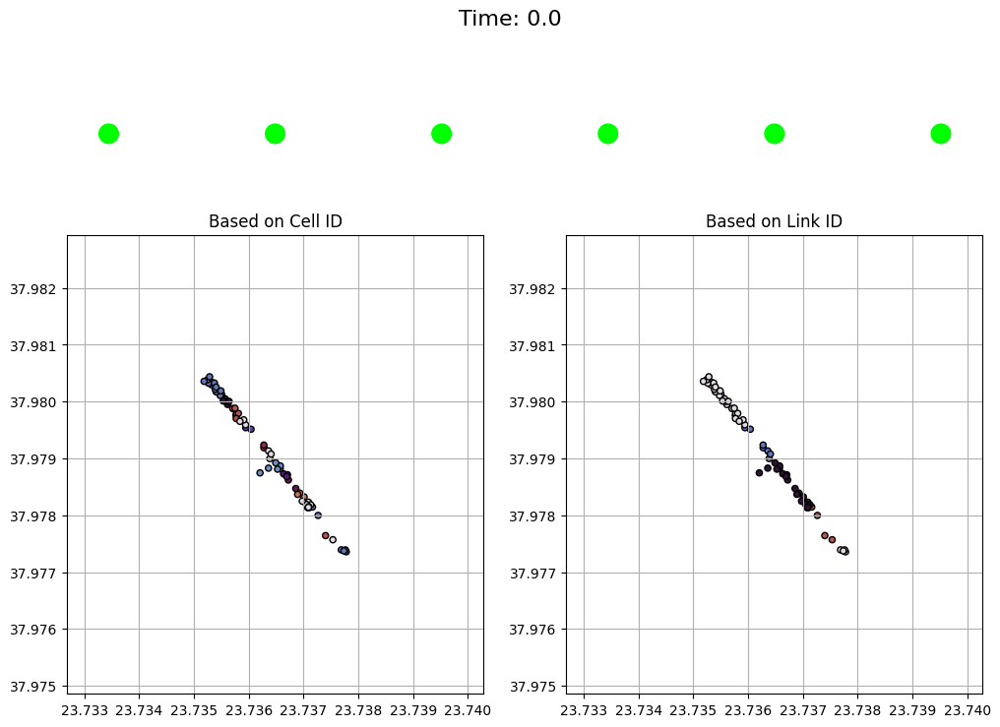

In [36]:
create_trajectory_animation(fully_modified_data_temp_with_slope, traffic_light_states, "filtered_animation.gif", frames=100)

# Check exit enter

In [25]:
from geopy.distance import geodesic

from shapely.wkt import loads
segments_gdf_exploded = pd.read_csv("20181024_d1_0830_0900_segments_gdf_exploded.csv")
segments_gdf_exploded["geometry"] = segments_gdf_exploded["geometry"].apply(loads)
for column in segments_gdf_exploded.columns[segments_gdf_exploded.columns.str.contains("cell_")]:
  segments_gdf_exploded[column] = segments_gdf_exploded[column].apply(lambda x: loads(x) if pd.notna(x) else None)
segments_gdf_exploded

veh_counts = filtered_df.groupby(["time", "link_id","closest_cell"]).size().reset_index(name="count")
segments_gdf_exploded_lengths = segments_gdf_exploded.copy()

def get_cell_length_meters(line_string):
  pt1 = line_string.coords[0]
  pt2 = line_string.coords[-1]
  return geodesic(pt1, pt2).meters

for index, row in segments_gdf_exploded_lengths.iterrows():
  for column in segments_gdf_exploded_lengths.columns[segments_gdf_exploded_lengths.columns.str.contains("cell_")]:
    if row[column] is not None:
      segments_gdf_exploded_lengths.at[index, column] = get_cell_length_meters(row[column])

densities = []


for index, row in veh_counts.iterrows():
  cell_id = row["closest_cell"]
  link_id = row["link_id"]
  count = row["count"]
  cell_length = segments_gdf_exploded_lengths[segments_gdf_exploded_lengths["link_id"] == link_id][cell_id].iloc[0]
  density = count/cell_length
  densities.append(density)

veh_counts["density"] = densities

veh_list = filtered_df.groupby(["time", "link_id", "closest_cell"])["veh_id"].agg(list).reset_index(name="veh_ids")
veh_list = veh_list.sort_values(by=["link_id", "closest_cell", "time"])

veh_list_with_flow = veh_list.copy()
veh_list_groups = veh_list_with_flow.groupby(["link_id", "closest_cell"])
for name, group in veh_list_groups:
  group["previous_veh_ids"] = group["veh_ids"].shift(1)
  group["previous_veh_ids"] = group["previous_veh_ids"].apply(lambda x: x if isinstance(x, list) else [])

  group["next_veh_ids"] = group["veh_ids"].shift(-1)
  group["next_veh_ids"] = group["next_veh_ids"].apply(lambda x: x if isinstance(x, list) else [])

  group["exit"] = group.apply(lambda x: len(set(x["previous_veh_ids"]) - set(x["veh_ids"])), axis=1)
  group["entry"] = group.apply(lambda x: len(set(x["veh_ids"]) - set(x["next_veh_ids"])), axis=1)

  veh_list_with_flow.loc[group.index, ["previous_veh_ids", "next_veh_ids", "exit", "entry"]] = group[["previous_veh_ids", "next_veh_ids", "exit", "entry"]]

veh_density_flow = veh_list_with_flow.join(
    veh_counts.set_index(["link_id", "closest_cell", "time"])[["density"]],
    on=["link_id", "closest_cell", "time"]
)

In [30]:
veh_density_flow_check = veh_density_flow[(veh_density_flow["time"] > 0) & (veh_density_flow["time"] < 800)]
veh_density_flow_check.groupby(["link_id", "closest_cell"])[["exit", "entry"]].sum()

exit  entry
link_id closest_cell              
0       cell_1        444.0  444.0
        cell_2        394.0  394.0
        cell_3        399.0  399.0
        cell_4        401.0  401.0
1       cell_1        360.0  361.0
        cell_2        356.0  357.0
        cell_3        487.0  487.0
2       cell_1        511.0  511.0
        cell_2        466.0  466.0
        cell_3        464.0  463.0
        cell_4        467.0  468.0
        cell_5        458.0  459.0
3       cell_1        481.0  481.0
        cell_2        499.0  499.0
        cell_3        531.0  531.0
        cell_4        529.0  530.0
4       cell_1        499.0  499.0
        cell_2        496.0  496.0
        cell_3        285.0  286.0
        cell_4          0.0    1.0

In [38]:
# Get the vehicle IDs in link_id = 0, closest_cell = "cell_1"
check_df = fully_modified_data_temp_with_slope[fully_modified_data_temp_with_slope["time"] <100]
veh_ids_cell_1 = set(check_df[(check_df['link_id'] == 0) & (check_df['closest_cell'] == 'cell_1')]['veh_id'])

# Get the vehicle IDs in link_id = 0, closest_cell = "cell_4"
veh_ids_cell_4 = set(check_df[(check_df['link_id'] == 0) & (check_df['closest_cell'] == 'cell_4')]['veh_id'])

# Find the vehicle IDs that are in cell_1 but not in cell_4
veh_ids_in_cell_1_not_in_cell_4 = veh_ids_cell_1 - veh_ids_cell_4

veh_ids_in_cell_1_not_in_cell_4

{64, 103, 166, 173, 184, 185}

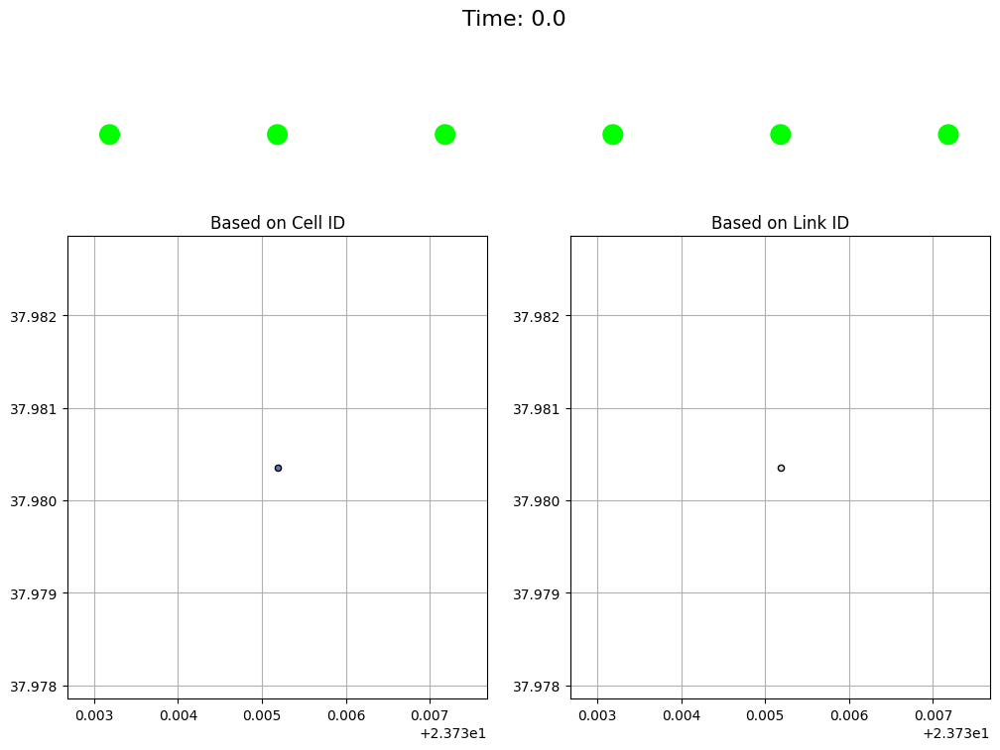

In [ ]:
create_trajectory_animation(fully_modified_data_temp_with_slope[fully_modified_data_temp_with_slope['veh_id'] == 64], traffic_light_states, "veh_64.gif", frames=2000)
64; Bus; 456.09; 7.993864; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.000000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.040000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.080000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.120000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.160000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.200000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.240000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.280000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.320000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.360000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.400000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.440000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.480000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.520000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.560000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.600000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.640000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.680000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.720000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.760000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.800000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.840000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.880000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.920000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 0.960000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.000000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.040000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.080000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.120000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.160000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.200000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.240000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.280000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.320000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.360000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.400000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.440000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.480000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.520000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.560000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.600000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.640000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.680000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.720000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.760000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.800000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.840000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.880000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.920000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 1.960000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.000000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.040000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.080000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.120000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.160000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.200000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.240000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.280000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.320000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.360000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.400000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.440000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.480000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.520000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.560000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.600000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.640000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.680000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.720000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.760000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.800000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.840000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.880000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.920000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 2.960000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.000000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.040000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.080000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.120000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.160000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.200000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.240000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.280000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.320000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.360000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.400000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.440000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.480000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.520000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.560000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.600000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.640000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.680000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.720000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.760000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.800000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.840000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.880000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.920000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 3.960000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.000000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.040000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.080000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.120000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.160000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.200000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.240000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.280000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.320000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.360000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.400000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.440000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.480000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.520000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.560000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.600000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.640000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.680000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.720000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.760000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.800000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.840000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.880000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.920000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 4.960000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.000000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.040000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.080000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.120000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.160000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.200000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.240000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.280000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.320000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.360000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.400000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.440000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.480000; 37.980357; 23.735184; 0.0000; 0.0000; 0.0000; 5.520000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.560000; 37.980357; 23.735184; 0.0000; -0.0000; -0.0000; 5.600000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.640000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.680000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.720000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.760000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.800000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.840000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.880000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.920000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 5.960000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.000000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.040000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.080000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.120000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.160000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.200000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.240000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.280000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.320000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.360000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.400000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.440000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.480000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.520000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.560000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.600000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.640000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.680000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.720000; 37.980357; 23.735184; 0.0000; 0.0000; -0.0000; 6.760000; 37.980357; 23.735184; 0.0000; 0.0001; -0.0000; 6.800000; 37.980357; 23.735184; 0.0000; 0.0002; -0.0000; 6.840000; 37.980357; 23.735184; 0.0000; 0.0002; -0.0000; 6.880000; 37.980357; 23.735184; 0.0001; 0.0002; -0.0000; 6.920000; 37.980357; 23.735184; 0.0001; 0.0000; -0.0000; 6.960000; 37.980357; 23.735184; 0.0001; 0.0002; -0.0000; 7.000000; 37.980357; 23.735184; 0.0001; 0.0003; -0.0000; 7.040000; 37.980357; 23.735184; 0.0002; 0.0004; -0.0000; 7.080000; 37.980357; 23.735184; 0.0003; 0.0004; 0.0000; 7.120000; 37.980357; 23.735184; 0.0003; 0.0005; 0.0000; 7.160000; 37.980357; 23.735184; 0.0004; 0.0008; 0.0000; 7.200000; 37.980357; 23.735184; 0.0006; 0.0011; 0.0000; 7.240000; 37.980357; 23.735184; 0.0007; -0.0003; -0.0000; 7.280000; 37.980357; 23.735184; 0.0008; 0.0012; 0.0000; 7.320000; 37.980357; 23.735184; 0.0010; 0.0017; 0.0000; 7.360000; 37.980357; 23.735184; 0.0013; 0.0027; 0.0000; 7.400000; 37.980357; 23.735184; 0.0018; 0.0042; -0.0000; 7.440000; 37.980357; 23.735184; 0.0025; 0.0047; -0.0000; 7.480000; 37.980357; 23.735184; 0.0032; 0.0048; -0.0000; 7.520000; 37.980357; 23.735184; 0.0040; 0.0065; -0.0000; 7.560000; 37.980357; 23.735184; 0.0052; 0.0097; 0.0000; 7.600000; 37.980357; 23.735184; 0.0054; -0.0068; 0.0000; 7.640000; 37.980357; 23.735184; 0.0061; -0.0105; 0.0000; 7.680000; 37.980357; 23.735184; 0.0061; -0.0044; 0.0000; 7.720000; 37.980357; 23.735184; 0.0064; -0.0077; 0.0000; 7.760000; 37.980357; 23.735184; 0.0088; 0.0265; 0.0000; 7.800000; 37.980357; 23.735184; 0.0112; 0.1272; 0.0000; 7.840000; 37.980357; 23.735184; 0.0269; 0.2131; 0.0000; 7.880000; 37.980357; 23.735184; 0.0514; 0.2488; 0.0000; 7.920000; 37.980357; 23.735184; 0.0821; 0.2982; 0.0000; 7.960000; 37.980357; 23.735184; 0.1208; 0.3609; 0.0000; 8.000000; 37.980357; 23.735184; 0.1695; 0.4372; 0.0000; 8.040000; 37.980357; 23.735184; 0.2305; 0.5312; 0.0000; 8.080000; 37.980357; 23.735184; 0.3044; 0.6163; 0.0000; 8.120000; 37.980357; 23.735184; 0.3885; 0.6744; 0.0000; 8.160000; 37.980357; 23.735184; 0.4791; 0.7056; 0.0000; 8.200000; 37.980357; 23.735184; 0.5723; 0.7097; 0.0000; 8.240000; 37.980357; 23.735184; 0.6673; 0.7317; 0.0000; 8.280000; 37.980357; 23.735184; 0.7668; 0.7716; 0.0000; 8.320000; 37.980357; 23.735184; 0.8702; 0.7863; 0.0000; 8.360000; 37.980357; 23.735184; 0.9735; 0.7709; 0.0000; 8.400000; 37.980357; 23.735184; 1.0728; 0.7296; 0.0000; 8.440000; 37.980357; 23.735184; 1.1674; 0.7058; 0.0000; 8.480000; 37.980357; 23.735184; 1.2598; 0.6995; 0.0000; 8.520000; 37.980357; 23.735184; 1.3494; 0.6673; 0.0000; 8.560000; 37.980357; 23.735184; 1.4325; 0.6084; 0.0000; 8.600000; 37.980357; 23.735184; 1.5051; 0.5210; 0.0000; 8.640000; 37.980357; 23.735183; 1.5642; 0.4223; 0.0000; 8.680000; 37.980358; 23.735183; 1.6119; 0.3614; 0.0000; 8.720000; 37.980358; 23.735183; 1.6490; 0.3022; 0.0000; 8.760000; 37.980358; 23.735183; 1.6787; 0.2477; -0.0000; 8.800000; 37.980358; 23.735183; 1.7024; 0.2170; -0.0000; 8.840000; 37.980358; 23.735182; 1.7137; 0.0775; 0.0000; 8.880000; 37.980359; 23.735182; 1.7117; -0.1060; -0.0000; 8.920000; 37.980359; 23.735182; 1.6990; -0.2275; -0.0000; 8.960000; 37.980359; 23.735182; 1.6746; -0.2548; -0.0000; 9.000000; 37.980359; 23.735182; 1.6442; -0.3094; -0.0000; 9.040000; 37.980360; 23.735182; 1.6065; -0.3582; -0.0000; 9.080000; 37.980360; 23.735181; 1.5586; -0.4515; 0.0000; 9.120000; 37.980360; 23.735181; 1.4983; -0.5429; 0.0000; 9.160000; 37.980360; 23.735181; 1.4250; -0.6297; 0.0000; 9.200000; 37.980360; 23.735181; 1.3414; -0.6879; 0.0000; 9.240000; 37.980360; 23.735181; 1.2513; -0.7193; 0.0000; 9.280000; 37.980360; 23.735181; 1.1584; -0.7263; 0.0000; 9.320000; 37.980360; 23.735181; 1.0633; -0.7460; 0.0000; 9.360000; 37.980361; 23.735181; 0.9639; -0.7867; 0.0000; 9.400000; 37.980361; 23.735181; 0.8606; -0.7999; 0.0000; 9.440000; 37.980361; 23.735181; 0.7573; -0.7862; 0.0000; 9.480000; 37.980361; 23.735181; 0.6578; -0.7469; 0.0000; 9.520000; 37.980361; 23.735181; 0.5630; -0.7242; 0.0000; 9.560000; 37.980361; 23.735181; 0.4701; -0.7195; 0.0000; 9.600000; 37.980361; 23.735181; 0.3798; -0.6877; 0.0000; 9.640000; 37.980361; 23.735181; 0.2961; -0.6290; 0.0000; 9.680000; 37.980361; 23.735181; 0.2227; -0.5433; 0.0000; 9.720000; 37.980361; 23.735181; 0.1624; -0.4482; 0.0001; 9.760000; 37.980361; 23.735181; 0.1145; -0.3708; 0.0001; 9.800000; 37.980361; 23.735181; 0.0767; -0.3078; 0.0001; 9.840000; 37.980361; 23.735181; 0.0470; -0.2594; 0.0001; 9.880000; 37.980361; 23.735181; 0.0232; -0.2256; 0.0001; 9.920000; 37.980361; 23.735181; 0.0094; -0.1200; 0.0001; 9.960000; 37.980361; 23.735181; 0.0091; -0.0372; 0.0001; 10.000000; 37.980361; 23.735181; 0.0060; -0.0014; 0.0001; 10.040000; 37.980361; 23.735181; 0.0060; -0.0100; 0.0001; 10.080000; 37.980361; 23.735181; 0.0058; -0.0047; 0.0001; 10.120000; 37.980361; 23.735181; 0.0048; -0.0184; 0.0001; 10.160000; 37.980361; 23.735181; 0.0041; -0.0010; 0.0001; 10.200000; 37.980361; 23.735181; 0.0036; -0.0036; 0.0001; 10.240000; 37.980361; 23.735181; 0.0030; -0.0019; 0.0001; 10.280000; 37.980361; 23.735181; 0.0026; -0.0019; 0.0001; 10.320000; 37.980361; 23.735181; 0.0022; -0.0013; 0.0001; 10.360000; 37.980361; 23.735181; 0.0021; 0.0022; 0.0001; 10.400000; 37.980361; 23.735181; 0.0025; 0.0006; 0.0001; 10.440000; 37.980361; 23.735181; 0.0028; 0.0014; 0.0001; 10.480000; 37.980361; 23.735181; 0.0032; 0.0015; 0.0001; 10.520000; 37.980361; 23.735181; 0.0036; 0.0027; 0.0001; 10.560000; 37.980361; 23.735181; 0.0044; 0.0063; 0.0001; 10.600000; 37.980361; 23.735181; 0.0048; -0.0017; 0.0001; 10.640000; 37.980361; 23.735181; 0.0049; -0.0011; 0.0001; 10.680000; 37.980361; 23.735181; 0.0049; 0.0028; 0.0001; 10.720000; 37.980361; 23.735181; 0.0050; 0.0007; 0.0001; 10.760000; 37.980361; 23.735181; 0.0066; 0.0227; 0.0001; 10.800000; 37.980361; 23.735181; 0.0087; 0.0960; 0.0000; 10.840000; 37.980361; 23.735181; 0.0198; 0.1484; 0.0000; 10.880000; 37.980361; 23.735181; 0.0365; 0.1731; 0.0000; 10.920000; 37.980361; 23.735181; 0.0573; 0.2065; 0.0000; 10.960000; 37.980361; 23.735181; 0.0836; 0.2488; 0.0000; 11.000000; 37.980361; 23.735181; 0.1166; 0.2995; 0.0000; 11.040000; 37.980361; 23.735181; 0.1578; 0.3625; 0.0000; 11.080000; 37.980361; 23.735181; 0.2077; 0.4195; 0.0000; 11.120000; 37.980361; 23.735181; 0.2645; 0.4585; 0.0000; 11.160000; 37.980361; 23.735181; 0.3255; 0.4794; 0.0000; 11.200000; 37.980361; 23.735181; 0.3883; 0.4821; 0.0000; 11.240000; 37.980361; 23.735181; 0.4523; 0.4968; -0.0000; 11.280000; 37.980361; 23.735181; 0.5193; 0.5235; -0.0000; 11.320000; 37.980361; 23.735181; 0.5889; 0.5323; 0.0000; 11.360000; 37.980361; 23.735181; 0.6584; 0.5229; 0.0000; 11.400000; 37.980361; 23.735181; 0.7252; 0.4950; 0.0000; 11.440000; 37.980361; 23.735181; 0.7889; 0.4790; 0.0000; 11.480000; 37.980361; 23.735181; 0.8511; 0.4747; 0.0000; 11.520000; 37.980361; 23.735181; 0.9114; 0.4529; 0.0000; 11.560000; 37.980361; 23.735181; 0.9673; 0.4132; 0.0000; 11.600000; 37.980361; 23.735181; 1.0161; 0.3544; 0.0000; 11.640000; 37.980361; 23.735181; 1.0559; 0.2881; 0.0000; 11.680000; 37.980361; 23.735180; 1.0878; 0.2441; 0.0000; 11.720000; 37.980361; 23.735180; 1.1131; 0.2012; -0.0000; 11.760000; 37.980362; 23.735180; 1.1331; 0.1647; -0.0000; 11.800000; 37.980362; 23.735180; 1.1490; 0.1439; -0.0000; 11.840000; 37.980362; 23.735180; 1.1568; 0.0518; -0.0000; 11.880000; 37.980362; 23.735180; 1.1550; -0.0776; 0.0000; 11.920000; 37.980362; 23.735180; 1.1459; -0.1542; 0.0000; 11.960000; 37.980362; 23.735180; 1.1293; -0.1729; -0.0000; 12.000000; 37.980363; 23.735180; 1.1086; -0.2101; -0.0000; 12.040000; 37.980363; 23.735180; 1.0830; -0.2431; -0.0000; 12.080000; 37.980363; 23.735180; 1.0505; -0.3060; -0.0000; 12.120000; 37.980363; 23.735179; 1.0097; -0.3676; -0.0000; 12.160000; 37.980363; 23.735179; 0.9603; -0.4260; -0.0000; 12.200000; 37.980363; 23.735179; 0.9039; -0.4650; 0.0000; 12.240000; 37.980363; 23.735179; 0.8431; -0.4861; 0.0000; 12.280000; 37.980363; 23.735179; 0.7805; -0.4905; -0.0000; 12.320000; 37.980363; 23.735179; 0.7164; -0.5034; -0.0000; 12.360000; 37.980363; 23.735179; 0.6494; -0.5307; -0.0000; 12.400000; 37.980363; 23.735179; 0.5798; -0.5395; -0.0000; 12.440000; 37.980363; 23.735179; 0.5102; -0.5302; -0.0000; 12.480000; 37.980363; 23.735179; 0.4432; -0.5038; -0.0000; 12.520000; 37.980363; 23.735179; 0.3793; -0.4886; -0.0000; 12.560000; 37.980363; 23.735179; 0.3168; -0.4854; -0.0000; 12.600000; 37.980363; 23.735179; 0.2560; -0.4639; -0.0000; 12.640000; 37.980363; 23.735179; 0.1996; -0.4244; -0.0000; 12.680000; 37.980363; 23.735179; 0.1502; -0.3668; -0.0000; 12.720000; 37.980363; 23.735179; 0.1096; -0.3024; -0.0000; 12.760000; 37.980363; 23.735179; 0.0773; -0.2504; -0.0000; 12.800000; 37.980363; 23.735179; 0.0518; -0.2080; -0.0000; 12.840000; 37.980363; 23.735179; 0.0318; -0.1754; -0.0000; 12.880000; 37.980363; 23.735179; 0.0157; -0.1526; -0.0000; 12.920000; 37.980363; 23.735179; 0.0064; -0.0823; -0.0000; 12.960000; 37.980363; 23.735179; 0.0061; -0.0258; -0.0000; 13.000000; 37.980363; 23.735179; 0.0040; -0.0018; -0.0000; 13.040000; 37.980363; 23.735179; 0.0040; -0.0077; -0.0000; 13.080000; 37.980363; 23.735179; 0.0037; -0.0040; -0.0000; 13.120000; 37.980363; 23.735179; 0.0030; -0.0132; -0.0000; 13.160000; 37.980363; 23.735179; 0.0025; -0.0012; -0.0000; 13.200000; 37.980363; 23.735179; 0.0021; -0.0026; -0.0000; 13.240000; 37.980363; 23.735179; 0.0016; -0.0015; -0.0000; 13.280000; 37.980363; 23.735179; 0.0012; -0.0015; -0.0000; 13.320000; 37.980363; 23.735179; 0.0008; -0.0014; -0.0000; 13.360000; 37.980363; 23.735179; 0.0005; 0.0002; -0.0000; 13.400000; 37.980363; 23.735179; 0.0005; -0.0017; 0.0000; 13.440000; 37.980363; 23.735179; 0.0004; -0.0014; 0.0000; 13.480000; 37.980363; 23.735179; 0.0003; -0.0015; 0.0000; 13.520000; 37.980363; 23.735179; 0.0002; -0.0014; 0.0000; 13.560000; 37.980363; 23.735179; 0.0002; -0.0003; 0.0000; 13.600000; 37.980363; 23.735179; 0.0001; -0.0001; 0.0000; 13.640000; 37.980363; 23.735179; 0.0001; -0.0001; 0.0000; 13.680000; 37.980363; 23.735179; 0.0001; -0.0001; 0.0000; 13.720000; 37.980363; 23.735179; 0.0001; -0.0001; 0.0000; 13.760000; 37.980363; 23.735179; 0.0000; 0.0001; 0.0000; 13.800000; 37.980363; 23.735179; 0.0000; -0.0001; -0.0000; 13.840000; 37.980363; 23.735179; 0.0000; -0.0001; -0.0000; 13.880000; 37.980363; 23.735179; 0.0000; -0.0001; -0.0000; 13.920000; 37.980363; 23.735179; 0.0000; -0.0001; -0.0000; 13.960000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.000000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.040000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.080000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.120000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.160000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.200000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.240000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.280000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.320000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.360000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.400000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.440000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.480000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.520000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.560000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.600000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.640000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.680000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 14.720000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.760000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.800000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 14.840000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 14.880000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 14.920000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 14.960000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.000000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.040000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.080000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.120000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.160000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.200000; 37.980363; 23.735179; 0.0000; -0.0000; -0.0000; 15.240000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 15.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.320000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 15.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.480000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 15.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.720000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 15.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.800000; 37.980363; 23.735179; 0.0000; -0.0000; 0.0000; 15.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 15.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 16.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 17.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 18.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 19.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 20.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 21.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 22.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 23.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 24.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 25.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 26.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 27.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 28.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 29.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 30.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 31.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 32.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 33.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 34.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 35.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 36.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 37.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 38.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 39.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 40.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 41.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 42.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 43.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 44.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 45.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 46.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 47.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 48.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 49.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 50.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 51.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 52.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.520000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 53.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.120000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 54.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.240000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 54.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.520000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 54.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.640000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 54.680000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.840000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 54.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.000000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.080000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.160000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.200000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.240000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.280000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.400000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.440000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.520000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.560000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.680000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.840000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 55.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 55.960000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.000000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.080000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.160000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.200000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.280000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.360000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.480000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.520000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.560000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.640000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.680000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.720000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.800000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.840000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 56.880000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 56.960000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.000000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.080000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.120000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.160000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.200000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.240000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.280000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.320000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.360000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.400000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.440000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.480000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.520000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.560000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.600000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.640000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.680000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.720000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.760000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.800000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.840000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.880000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 57.920000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 57.960000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.000000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.040000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 58.080000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.120000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 58.160000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.200000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.240000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 58.280000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.320000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 58.360000; 37.980363; 23.735179; 0.0000; 0.0000; -0.0000; 58.400000; 37.980363; 23.735179; 0.0000; 0.0000; 0.0000; 58.440000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 58.480000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.520000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 58.560000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.600000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 58.640000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.680000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.720000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 58.760000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.800000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.840000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 58.880000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 58.920000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 58.960000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.000000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.040000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.080000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.120000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.160000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.200000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.240000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.280000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.320000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.360000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.400000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.440000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.480000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.520000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.560000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.600000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.640000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.680000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.720000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.760000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.800000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.840000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.880000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 59.920000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 59.960000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.000000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.040000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.080000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.120000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.160000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.200000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.240000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.280000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.320000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.360000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.400000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.440000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.480000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.520000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.560000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.600000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.640000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.680000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.720000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.760000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.800000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.840000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.880000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 60.920000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 60.960000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 61.000000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 61.040000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 61.080000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 61.120000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 61.160000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 61.200000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 61.240000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 61.280000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 61.320000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 61.360000; 37.980363; 23.735179; 0.0001; 0.0000; -0.0000; 61.400000; 37.980363; 23.735179; 0.0001; 0.0000; 0.0000; 61.440000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.480000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.520000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 61.560000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.600000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 61.640000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.680000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 61.720000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.760000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 61.800000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.840000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.880000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 61.920000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 61.960000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.000000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.040000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.080000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.120000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.160000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.200000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.240000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.280000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.320000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.360000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.400000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.440000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.480000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.520000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.560000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.600000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.640000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.680000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.720000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.760000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.800000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.840000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.880000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 62.920000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 62.960000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.000000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 63.040000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.080000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 63.120000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.160000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.200000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.240000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 63.280000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.320000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 63.360000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 63.400000; 37.980363; 23.735179; 0.0002; 0.0000; -0.0000; 63.440000; 37.980363; 23.735179; 0.0002; 0.0000; 0.0000; 63.480000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.520000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.560000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 63.600000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 63.640000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.680000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.720000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 63.760000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.800000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 63.840000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.880000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 63.920000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 63.960000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.000000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.040000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.080000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.120000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.160000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.200000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.240000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.280000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.320000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.360000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.400000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.440000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.480000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.520000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.560000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.600000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.640000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.680000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.720000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.760000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.800000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.840000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 64.880000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.920000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 64.960000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 65.000000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 65.040000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 65.080000; 37.980363; 23.735179; 0.0003; 0.0000; -0.0000; 65.120000; 37.980363; 23.735179; 0.0003; 0.0000; 0.0000; 65.160000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.200000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.240000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.280000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.320000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.360000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.400000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.440000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.480000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.520000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.560000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.600000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.640000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.680000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.720000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.760000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.800000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.840000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.880000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 65.920000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 65.960000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.000000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.040000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.080000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.120000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.160000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.200000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.240000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.280000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.320000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.360000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.400000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.440000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.480000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.520000; 37.980363; 23.735179; 0.0004; 0.0000; 0.0000; 66.560000; 37.980363; 23.735179; 0.0004; 0.0000; -0.0000; 66.600000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 66.640000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 66.680000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 66.720000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 66.760000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 66.800000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 66.840000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 66.880000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 66.920000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 66.960000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.000000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.040000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.080000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.120000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.160000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.200000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.240000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.280000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.320000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.360000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.400000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.440000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.480000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.520000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.560000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.600000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.640000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.680000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.720000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.760000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.800000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.840000; 37.980363; 23.735179; 0.0005; 0.0000; 0.0000; 67.880000; 37.980363; 23.735179; 0.0005; 0.0000; -0.0000; 67.920000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 67.960000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.000000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.040000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.080000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.120000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.160000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.200000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.240000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.280000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.320000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.360000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.400000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.440000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.480000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.520000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.560000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.600000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.640000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.680000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.720000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.760000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.800000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.840000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 68.880000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.920000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 68.960000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 69.000000; 37.980363; 23.735179; 0.0006; 0.0000; -0.0000; 69.040000; 37.980363; 23.735179; 0.0006; 0.0000; 0.0000; 69.080000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.120000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.160000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.200000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.240000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.280000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.320000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.360000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.400000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.440000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.480000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.520000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.560000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.600000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.640000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.680000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.720000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.760000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.800000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.840000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 69.880000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.920000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 69.960000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 70.000000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 70.040000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 70.080000; 37.980363; 23.735179; 0.0007; 0.0000; 0.0000; 70.120000; 37.980363; 23.735179; 0.0007; 0.0000; -0.0000; 70.160000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.200000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.240000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.280000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.320000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.360000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.400000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.440000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.480000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.520000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.560000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.600000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.640000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.680000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.720000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.760000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.800000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.840000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 70.880000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.920000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 70.960000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 71.000000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 71.040000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 71.080000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 71.120000; 37.980363; 23.735179; 0.0008; 0.0000; -0.0000; 71.160000; 37.980363; 23.735179; 0.0008; 0.0000; 0.0000; 71.200000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.240000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.280000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.320000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.360000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.400000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.440000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.480000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.520000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.560000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.600000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.640000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.680000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.720000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.760000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.800000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.840000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.880000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 71.920000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 71.960000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 72.000000; 37.980363; 23.735179; 0.0009; 0.0000; 0.0000; 72.040000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 72.080000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 72.120000; 37.980363; 23.735179; 0.0009; 0.0000; -0.0000; 72.160000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.200000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.240000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.280000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.320000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.360000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.400000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.440000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.480000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.520000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.560000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.600000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.640000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.680000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.720000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.760000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.800000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.840000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.880000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 72.920000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 72.960000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 73.000000; 37.980363; 23.735179; 0.0010; 0.0000; 0.0000; 73.040000; 37.980363; 23.735179; 0.0010; 0.0000; -0.0000; 73.080000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.120000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.160000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.200000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.240000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.280000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.320000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.360000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.400000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.440000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.480000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.520000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.560000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.600000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.640000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.680000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.720000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.760000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.800000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.840000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.880000; 37.980363; 23.735179; 0.0011; 0.0000; 0.0000; 73.920000; 37.980363; 23.735179; 0.0011; 0.0000; -0.0000; 73.960000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.000000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.040000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.080000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.120000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.160000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.200000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.240000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.280000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.320000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.360000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.400000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.440000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.480000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.520000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.560000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.600000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.640000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.680000; 37.980363; 23.735179; 0.0012; 0.0000; -0.0000; 74.720000; 37.980363; 23.735179; 0.0012; 0.0000; 0.0000; 74.760000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 74.800000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 74.840000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 74.880000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 74.920000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 74.960000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.000000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 75.040000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.080000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 75.120000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.160000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 75.200000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.240000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.280000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 75.320000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.360000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.400000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 75.440000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.480000; 37.980363; 23.735179; 0.0013; 0.0000; -0.0000; 75.520000; 37.980363; 23.735179; 0.0013; 0.0000; 0.0000; 75.560000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 75.600000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 75.640000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 75.680000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 75.720000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 75.760000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 75.800000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 75.840000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 75.880000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 75.920000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 75.960000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.000000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 76.040000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.080000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 76.120000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.160000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.200000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.240000; 37.980363; 23.735179; 0.0014; 0.0000; -0.0000; 76.280000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.320000; 37.980363; 23.735179; 0.0014; 0.0000; 0.0000; 76.360000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.400000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 76.440000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 76.480000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.520000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 76.560000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.600000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.640000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 76.680000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 76.720000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.760000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.800000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.840000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.880000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 76.920000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 76.960000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 77.000000; 37.980363; 23.735179; 0.0015; 0.0000; -0.0000; 77.040000; 37.980363; 23.735179; 0.0015; 0.0000; 0.0000; 77.080000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.120000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.160000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.200000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.240000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.280000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.320000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.360000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.400000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.440000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.480000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.520000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.560000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.600000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.640000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.680000; 37.980363; 23.735179; 0.0016; 0.0000; 0.0000; 77.720000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.760000; 37.980363; 23.735179; 0.0016; 0.0000; -0.0000; 77.800000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 77.840000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 77.880000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 77.920000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 77.960000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.000000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.040000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.080000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 78.120000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.160000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 78.200000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.240000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 78.280000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 78.320000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.360000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 78.400000; 37.980363; 23.735179; 0.0017; 0.0000; 0.0000; 78.440000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.480000; 37.980363; 23.735179; 0.0017; 0.0000; -0.0000; 78.520000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 78.560000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 78.600000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 78.640000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 78.680000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 78.720000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 78.760000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 78.800000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 78.840000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 78.880000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 78.920000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 78.960000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 79.000000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 79.040000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 79.080000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 79.120000; 37.980363; 23.735179; 0.0018; 0.0000; 0.0000; 79.160000; 37.980363; 23.735179; 0.0018; 0.0000; -0.0000; 79.200000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.240000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.280000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.320000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.360000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.400000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.440000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.480000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.520000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.560000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.600000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.640000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.680000; 37.980363; 23.735179; 0.0019; 0.0000; 0.0000; 79.720000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.760000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.800000; 37.980363; 23.735179; 0.0019; 0.0000; -0.0000; 79.840000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 79.880000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 79.920000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 79.960000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.000000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 80.040000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.080000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 80.120000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.160000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 80.200000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.240000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 80.280000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.320000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.360000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 80.400000; 37.980363; 23.735179; 0.0020; 0.0000; 0.0000; 80.440000; 37.980363; 23.735179; 0.0020; 0.0000; -0.0000; 80.480000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.520000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.560000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.600000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.640000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 80.680000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.720000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 80.760000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.800000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 80.840000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 80.880000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 80.920000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 80.960000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 81.000000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 81.040000; 37.980363; 23.735179; 0.0021; 0.0000; -0.0000; 81.080000; 37.980363; 23.735179; 0.0021; 0.0000; 0.0000; 81.120000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.160000; 37.980363; 23.735179; 0.0022; 0.0000; 0.0000; 81.200000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.240000; 37.980363; 23.735179; 0.0022; 0.0000; 0.0000; 81.280000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.320000; 37.980363; 23.735179; 0.0022; 0.0000; 0.0000; 81.360000; 37.980363; 23.735179; 0.0022; 0.0000; 0.0000; 81.400000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.440000; 37.980363; 23.735179; 0.0022; 0.0000; 0.0000; 81.480000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.520000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.560000; 37.980363; 23.735179; 0.0022; 0.0000; 0.0000; 81.600000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.640000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.680000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.720000; 37.980363; 23.735179; 0.0022; 0.0000; -0.0000; 81.760000; 37.980363; 23.735179; 0.0023; 0.0000; -0.0000; 81.800000; 37.980363; 23.735179; 0.0023; 0.0001; 0.0000; 81.840000; 37.980363; 23.735179; 0.0022; -0.0003; 0.0000; 81.880000; 37.980363; 23.735179; 0.0022; -0.0002; 0.0000; 81.920000; 37.980363; 23.735179; 0.0022; -0.0001; 0.0000; 81.960000; 37.980363; 23.735179; 0.0022; 0.0002; 0.0000; 82.000000; 37.980363; 23.735179; 0.0023; 0.0007; 0.0000; 82.040000; 37.980363; 23.735179; 0.0024; 0.0009; 0.0000; 82.080000; 37.980363; 23.735179; 0.0025; 0.0010; 0.0000; 82.120000; 37.980363; 23.735179; 0.0027; 0.0016; 0.0000; 82.160000; 37.980363; 23.735179; 0.0030; 0.0020; 0.0000; 82.200000; 37.980363; 23.735179; 0.0030; 0.0095; 0.0000; 82.240000; 37.980363; 23.735179; 0.0034; 0.0054; 0.0000; 82.280000; 37.980363; 23.735179; 0.0034; 0.0083; 0.0000; 82.320000; 37.980363; 23.735179; 0.0034; 0.0061; 0.0000; 82.360000; 37.980363; 23.735179; 0.0042; 0.0183; 0.0000; 82.400000; 37.980363; 23.735179; 0.0043; 0.0452; -0.0000; 82.440000; 37.980363; 23.735179; 0.0090; 0.0814; -0.0000; 82.480000; 37.980363; 23.735179; 0.0170; 0.0919; -0.0000; 82.520000; 37.980363; 23.735179; 0.0270; 0.1100; -0.0000; 82.560000; 37.980363; 23.735179; 0.0402; 0.1358; -0.0000; 82.600000; 37.980363; 23.735179; 0.0577; 0.1693; -0.0000; 82.640000; 37.980363; 23.735179; 0.0803; 0.2065; -0.0000; 82.680000; 37.980363; 23.735179; 0.1079; 0.2386; -0.0001; 82.720000; 37.980363; 23.735179; 0.1396; 0.2651; -0.0001; 82.760000; 37.980363; 23.735179; 0.1749; 0.2862; -0.0002; 82.800000; 37.980363; 23.735179; 0.2127; 0.3017; -0.0004; 82.840000; 37.980363; 23.735179; 0.2531; 0.3210; -0.0005; 82.880000; 37.980363; 23.735179; 0.2964; 0.3439; -0.0007; 82.920000; 37.980363; 23.735179; 0.3428; 0.3616; -0.0010; 82.960000; 37.980363; 23.735179; 0.3912; 0.3734; -0.0013; 83.000000; 37.980363; 23.735179; 0.4409; 0.3796; -0.0016; 83.040000; 37.980363; 23.735179; 0.4918; 0.3892; -0.0020; 83.080000; 37.980363; 23.735179; 0.5443; 0.4023; -0.0024; 83.120000; 37.980363; 23.735179; 0.5983; 0.4103; -0.0029; 83.160000; 37.980363; 23.735179; 0.6531; 0.4128; -0.0033; 83.200000; 37.980363; 23.735180; 0.7078; 0.4094; -0.0038; 83.240000; 37.980363; 23.735180; 0.7620; 0.4055; -0.0043; 83.280000; 37.980363; 23.735180; 0.8162; 0.3983; -0.0048; 83.320000; 37.980363; 23.735180; 0.8701; 0.4035; -0.0052; 83.360000; 37.980363; 23.735180; 0.9247; 0.4024; -0.0056; 83.400000; 37.980363; 23.735180; 0.9794; 0.4073; -0.0060; 83.440000; 37.980363; 23.735180; 1.0337; 0.3953; -0.0063; 83.480000; 37.980363; 23.735180; 1.0887; 0.3681; -0.0065; 83.520000; 37.980363; 23.735180; 1.1393; 0.3353; -0.0064; 83.560000; 37.980363; 23.735181; 1.1874; 0.3319; -0.0062; 83.600000; 37.980363; 23.735181; 1.2346; 0.3244; -0.0057; 83.640000; 37.980362; 23.735181; 1.2803; 0.3101; -0.0051; 83.680000; 37.980362; 23.735181; 1.3232; 0.2857; -0.0043; 83.720000; 37.980362; 23.735181; 1.3622; 0.2563; -0.0033; 83.760000; 37.980362; 23.735181; 1.3973; 0.2309; -0.0022; 83.800000; 37.980362; 23.735182; 1.4290; 0.2098; -0.0008; 83.840000; 37.980362; 23.735182; 1.4582; 0.1950; 0.0008; 83.880000; 37.980362; 23.735182; 1.4856; 0.1865; 0.0026; 83.920000; 37.980362; 23.735182; 1.5115; 0.1731; 0.0046; 83.960000; 37.980362; 23.735182; 1.5352; 0.1548; 0.0068; 84.000000; 37.980362; 23.735182; 1.5564; 0.1408; 0.0091; 84.040000; 37.980362; 23.735182; 1.5762; 0.1332; 0.0117; 84.080000; 37.980362; 23.735183; 1.5953; 0.1319; 0.0143; 84.120000; 37.980361; 23.735183; 1.6138; 0.1258; 0.0171; 84.160000; 37.980361; 23.735183; 1.6311; 0.1147; 0.0200; 84.200000; 37.980361; 23.735183; 1.6472; 0.1079; 0.0230; 84.240000; 37.980361; 23.735183; 1.6625; 0.1051; 0.0261; 84.280000; 37.980361; 23.735183; 1.6779; 0.1085; 0.0294; 84.320000; 37.980361; 23.735184; 1.6940; 0.1149; 0.0327; 84.360000; 37.980361; 23.735184; 1.7109; 0.1201; 0.0361; 84.400000; 37.980361; 23.735184; 1.7287; 0.1268; 0.0395; 84.440000; 37.980361; 23.735184; 1.7473; 0.1321; 0.0429; 84.480000; 37.980361; 23.735184; 1.7665; 0.1351; 0.0465; 84.520000; 37.980360; 23.735184; 1.7864; 0.1413; 0.0501; 84.560000; 37.980360; 23.735185; 1.8073; 0.1488; 0.0536; 84.600000; 37.980360; 23.735185; 1.8291; 0.1535; 0.0572; 84.640000; 37.980360; 23.735185; 1.8514; 0.1569; 0.0606; 84.680000; 37.980360; 23.735185; 1.8740; 0.1562; 0.0641; 84.720000; 37.980360; 23.735185; 1.8961; 0.1510; 0.0677; 84.760000; 37.980360; 23.735186; 1.9174; 0.1446; 0.0713; 84.800000; 37.980360; 23.735186; 1.9376; 0.1359; 0.0749; 84.840000; 37.980360; 23.735186; 1.9568; 0.1308; 0.0786; 84.880000; 37.980359; 23.735186; 1.9755; 0.1293; 0.0823; 84.920000; 37.980359; 23.735186; 1.9937; 0.1234; 0.0862; 84.960000; 37.980359; 23.735187; 2.0107; 0.1130; 0.0901; 85.000000; 37.980359; 23.735187; 2.0261; 0.1003; 0.0942; 85.040000; 37.980359; 23.735187; 2.0399; 0.0912; 0.0983; 85.080000; 37.980359; 23.735187; 2.0526; 0.0858; 0.1028; 85.120000; 37.980359; 23.735187; 2.0642; 0.0759; 0.1077; 85.160000; 37.980358; 23.735188; 2.0741; 0.0616; 0.1131; 85.200000; 37.980358; 23.735188; 2.0818; 0.0449; 0.1187; 85.240000; 37.980358; 23.735188; 2.0874; 0.0324; 0.1247; 85.280000; 37.980358; 23.735188; 2.0914; 0.0235; 0.1309; 85.320000; 37.980358; 23.735188; 2.0939; 0.0117; 0.1373; 85.360000; 37.980358; 23.735189; 2.0944; -0.0054; 0.1440; 85.400000; 37.980358; 23.735189; 2.0919; -0.0294; 0.1511; 85.440000; 37.980357; 23.735189; 2.0856; -0.0574; 0.1583; 85.480000; 37.980357; 23.735189; 2.0754; -0.0848; 0.1647; 85.520000; 37.980357; 23.735189; 2.0614; -0.1093; 0.1701; 85.560000; 37.980357; 23.735190; 2.0442; -0.1298; 0.1742; 85.600000; 37.980357; 23.735190; 2.0241; -0.1486; 0.1772; 85.640000; 37.980357; 23.735190; 2.0010; -0.1729; 0.1788; 85.680000; 37.980356; 23.735190; 1.9742; -0.1995; 0.1794; 85.720000; 37.980356; 23.735190; 1.9438; -0.2217; 0.1789; 85.760000; 37.980356; 23.735190; 1.9108; -0.2366; 0.1775; 85.800000; 37.980356; 23.735191; 1.8765; -0.2410; 0.1750; 85.840000; 37.980356; 23.735191; 1.8414; -0.2465; 0.1713; 85.880000; 37.980356; 23.735191; 1.8054; -0.2529; 0.1667; 85.920000; 37.980356; 23.735191; 1.7689; -0.2548; 0.1612; 85.960000; 37.980355; 23.735191; 1.7323; -0.2523; 0.1547; 86.000000; 37.980355; 23.735191; 1.6970; -0.2394; 0.1472; 86.040000; 37.980355; 23.735191; 1.6634; -0.2273; 0.1383; 86.080000; 37.980355; 23.735192; 1.6314; -0.2162; 0.1268; 86.120000; 37.980355; 23.735192; 1.6014; -0.2008; 0.1124; 86.160000; 37.980355; 23.735192; 1.5739; -0.1810; 0.0953; 86.200000; 37.980355; 23.735192; 1.5500; -0.1508; 0.0754; 86.240000; 37.980354; 23.735192; 1.5309; -0.1148; 0.0529; 86.280000; 37.980354; 23.735192; 1.5169; -0.0796; 0.0285; 86.320000; 37.980354; 23.735192; 1.5075; -0.0509; 0.0021; 86.360000; 37.980354; 23.735192; 1.5018; -0.0280; -0.0261; 86.400000; 37.980354; 23.735192; 1.4994; -0.0041; -0.0563; 86.440000; 37.980354; 23.735192; 1.5011; 0.0274; -0.0878; 86.480000; 37.980354; 23.735192; 1.5078; 0.0657; -0.1184; 86.520000; 37.980354; 23.735192; 1.5198; 0.1011; -0.1472; 86.560000; 37.980354; 23.735192; 1.5363; 0.1289; -0.1733; 86.600000; 37.980353; 23.735193; 1.5564; 0.1499; -0.1965; 86.640000; 37.980353; 23.735193; 1.5790; 0.1650; -0.2171; 86.680000; 37.980353; 23.735193; 1.6039; 0.1806; -0.2353; 86.720000; 37.980353; 23.735193; 1.6318; 0.2061; -0.2511; 86.760000; 37.980353; 23.735193; 1.6637; 0.2383; -0.2647; 86.800000; 37.980353; 23.735193; 1.7003; 0.2689; -0.2762; 86.840000; 37.980353; 23.735193; 1.7404; 0.2892; -0.2856; 86.880000; 37.980353; 23.735193; 1.7828; 0.2993; -0.2935; 86.920000; 37.980352; 23.735193; 1.8273; 0.3191; -0.2999; 86.960000; 37.980352; 23.735194; 1.8754; 0.3488; -0.3052; 87.000000; 37.980352; 23.735194; 1.9276; 0.3768; -0.3093; 87.040000; 37.980352; 23.735194; 1.9832; 0.3946; -0.3123; 87.080000; 37.980352; 23.735194; 2.0405; 0.4020; -0.3142; 87.120000; 37.980352; 23.735194; 2.0996; 0.4191; -0.3145; 87.160000; 37.980352; 23.735195; 2.1619; 0.4460; -0.3119; 87.200000; 37.980352; 23.735195; 2.2280; 0.4715; -0.3065; 87.240000; 37.980351; 23.735195; 2.2971; 0.4884; -0.2984; 87.280000; 37.980351; 23.735195; 2.3679; 0.4951; -0.2877; 87.320000; 37.980351; 23.735196; 2.4397; 0.5021; -0.2747; 87.360000; 37.980351; 23.735196; 2.5130; 0.5162; -0.2597; 87.400000; 37.980351; 23.735196; 2.5888; 0.5364; -0.2430; 87.440000; 37.980351; 23.735196; 2.6679; 0.5624; -0.2245; 87.480000; 37.980351; 23.735197; 2.7509; 0.5900; -0.2045; 87.520000; 37.980351; 23.735197; 2.8374; 0.6112; -0.1837; 87.560000; 37.980350; 23.735197; 2.9266; 0.6265; -0.1643; 87.600000; 37.980350; 23.735198; 3.0180; 0.6429; -0.1471; 87.640000; 37.980350; 23.735198; 3.1123; 0.6664; -0.1320; 87.680000; 37.980350; 23.735198; 3.2104; 0.6968; -0.1189; 87.720000; 37.980350; 23.735199; 3.3129; 0.7267; -0.1078; 87.760000; 37.980350; 23.735199; 3.4192; 0.7496; -0.0981; 87.800000; 37.980350; 23.735199; 3.5282; 0.7634; -0.0899; 87.840000; 37.980349; 23.735200; 3.6389; 0.7746; -0.0831; 87.880000; 37.980349; 23.735200; 3.7511; 0.7833; -0.0778; 87.920000; 37.980349; 23.735201; 3.8645; 0.7915; -0.0739; 87.960000; 37.980349; 23.735201; 3.9790; 0.7992; -0.0710; 88.000000; 37.980349; 23.735201; 4.0940; 0.7978; -0.0688; 88.040000; 37.980349; 23.735202; 4.2086; 0.7937; -0.0673; 88.080000; 37.980348; 23.735202; 4.3224; 0.7870; -0.0666; 88.120000; 37.980348; 23.735203; 4.4352; 0.7798; -0.0666; 88.160000; 37.980348; 23.735203; 4.5469; 0.7722; -0.0675; 88.200000; 37.980348; 23.735204; 4.6569; 0.7554; -0.0691; 88.240000; 37.980348; 23.735205; 4.7645; 0.7388; -0.0713; 88.280000; 37.980347; 23.735205; 4.8695; 0.7197; -0.0740; 88.320000; 37.980347; 23.735206; 4.9713; 0.6940; -0.0773; 88.360000; 37.980347; 23.735206; 5.0690; 0.6635; -0.0810; 88.400000; 37.980347; 23.735207; 5.1616; 0.6220; -0.0851; 88.440000; 37.980347; 23.735208; 5.2478; 0.5761; -0.0892; 88.480000; 37.980346; 23.735208; 5.3277; 0.5332; -0.0916; 88.520000; 37.980346; 23.735209; 5.4014; 0.4906; -0.0918; 88.560000; 37.980346; 23.735209; 5.4693; 0.4523; -0.0893; 88.600000; 37.980346; 23.735210; 5.5321; 0.4202; -0.0841; 88.640000; 37.980345; 23.735211; 5.5900; 0.3831; -0.0763; 88.680000; 37.980345; 23.735211; 5.6426; 0.3478; -0.0660; 88.720000; 37.980345; 23.735212; 5.6909; 0.3225; -0.0533; 88.760000; 37.980345; 23.735213; 5.7362; 0.3073; -0.0382; 88.800000; 37.980345; 23.735214; 5.7805; 0.3085; -0.0206; 88.840000; 37.980344; 23.735214; 5.8247; 0.3054; -0.0006; 88.880000; 37.980344; 23.735215; 5.8681; 0.2978; 0.0216; 88.920000; 37.980344; 23.735216; 5.9112; 0.3002; 0.0459; 88.960000; 37.980344; 23.735216; 5.9553; 0.3125; 0.0724; 89.000000; 37.980343; 23.735217; 6.0024; 0.3413; 0.1012; 89.040000; 37.980343; 23.735218; 6.0533; 0.3656; 0.1321; 89.080000; 37.980343; 23.735218; 6.1073; 0.3856; 0.1652; 89.120000; 37.980343; 23.735219; 6.1650; 0.4154; 0.2001; 89.160000; 37.980343; 23.735220; 6.2277; 0.4551; 0.2371; 89.200000; 37.980342; 23.735221; 6.2972; 0.5114; 0.2764; 89.240000; 37.980342; 23.735221; 6.3749; 0.5674; 0.3177; 89.280000; 37.980342; 23.735222; 6.4603; 0.6190; 0.3604; 89.320000; 37.980342; 23.735223; 6.5532; 0.6714; 0.4043; 89.360000; 37.980341; 23.735223; 6.6539; 0.7274; 0.4492; 89.400000; 37.980341; 23.735224; 6.7637; 0.7980; 0.4952; 89.440000; 37.980341; 23.735225; 6.8847; 0.8826; 0.5416; 89.480000; 37.980341; 23.735226; 7.0182; 0.9713; 0.5860; 89.520000; 37.980340; 23.735226; 7.1639; 1.0534; 0.6275; 89.560000; 37.980340; 23.735227; 7.3205; 1.1216; 0.6645; 89.600000; 37.980340; 23.735228; 7.4861; 1.1788; 0.6966; 89.640000; 37.980339; 23.735229; 7.6602; 1.2398; 0.7240; 89.680000; 37.980339; 23.735229; 7.8434; 1.3037; 0.7468; 89.720000; 37.980338; 23.735230; 8.0356; 1.3665; 0.7649; 89.760000; 37.980338; 23.735231; 8.2363; 1.4215; 0.7785; 89.800000; 37.980338; 23.735232; 8.4434; 1.4546; 0.7877; 89.840000; 37.980337; 23.735233; 8.6548; 1.4814; 0.7928; 89.880000; 37.980337; 23.735234; 8.8696; 1.5020; 0.7940; 89.920000; 37.980336; 23.735235; 9.0873; 1.5216; 0.7914; 89.960000; 37.980336; 23.735235; 9.3077; 1.5400; 0.7852; 90.000000; 37.980335; 23.735236; 9.5292; 1.5363; 0.7755; 90.040000; 37.980334; 23.735237; 9.7497; 1.5265; 0.7624; 90.080000; 37.980334; 23.735238; 9.9684; 1.5103; 0.7457; 90.120000; 37.980333; 23.735239; 10.1846; 1.4931; 0.7258; 90.160000; 37.980332; 23.735240; 10.3983; 1.4749; 0.7026; 90.200000; 37.980332; 23.735241; 10.6078; 1.4346; 0.6764; 90.240000; 37.980331; 23.735242; 10.8104; 1.3793; 0.6472; 90.280000; 37.980330; 23.735243; 11.0046; 1.3177; 0.6151; 90.320000; 37.980329; 23.735244; 11.1905; 1.2641; 0.5803; 90.360000; 37.980328; 23.735246; 11.3696; 1.2228; 0.5434; 90.400000; 37.980328; 23.735247; 11.5425; 1.1790; 0.5047; 90.440000; 37.980327; 23.735248; 11.7084; 1.1248; 0.4645; 90.480000; 37.980326; 23.735249; 11.8658; 1.0616; 0.4238; 90.520000; 37.980325; 23.735250; 12.0142; 0.9992; 0.3837; 90.560000; 37.980324; 23.735251; 12.1544; 0.9473; 0.3465; 90.600000; 37.980323; 23.735252; 12.2881; 0.9100; 0.3127; 90.640000; 37.980322; 23.735253; 12.4173; 0.8848; 0.2823; 90.680000; 37.980321; 23.735254; 12.5432; 0.8638; 0.2553; 90.720000; 37.980321; 23.735255; 12.6653; 0.8307; 0.2317; 90.760000; 37.980320; 23.735257; 12.7817; 0.7863; 0.2112; 90.800000; 37.980319; 23.735258; 12.8920; 0.7455; 0.1940; 90.840000; 37.980318; 23.735259; 12.9973; 0.7181; 0.1801; 90.880000; 37.980317; 23.735260; 13.0997; 0.7040; 0.1694; 90.920000; 37.980316; 23.735261; 13.1992; 0.6778; 0.1619; 90.960000; 37.980315; 23.735262; 13.2941; 0.6394; 0.1571; 91.000000; 37.980314; 23.735263; 13.3836; 0.6047; 0.1551; 91.040000; 37.980313; 23.735265; 13.4692; 0.5833; 0.1557; 91.080000; 37.980312; 23.735266; 13.5526; 0.5753; 0.1592; 91.120000; 37.980311; 23.735267; 13.6340; 0.5552; 0.1656; 91.160000; 37.980310; 23.735268; 13.7116; 0.5229; 0.1747; 91.200000; 37.980309; 23.735269; 13.7849; 0.4942; 0.1864; 91.240000; 37.980308; 23.735270; 13.8550; 0.4801; 0.2007; 91.280000; 37.980307; 23.735272; 13.9241; 0.4793; 0.2174; 91.320000; 37.980306; 23.735273; 13.9927; 0.4734; 0.2364; 91.360000; 37.980305; 23.735274; 14.0594; 0.4535; 0.2576; 91.400000; 37.980304; 23.735275; 14.1224; 0.4219; 0.2809; 91.440000; 37.980303; 23.735277; 14.1805; 0.3839; 0.3057; 91.480000; 37.980302; 23.735278; 14.2331; 0.3473; 0.3303; 91.520000; 37.980301; 23.735279; 14.2810; 0.3186; 0.3538; 91.560000; 37.980300; 23.735280; 14.3253; 0.2965; 0.3751; 91.600000; 37.980299; 23.735282; 14.3662; 0.2719; 0.3939; 91.640000; 37.980297; 23.735283; 14.4026; 0.2333; 0.4100; 91.680000; 37.980296; 23.735284; 14.4328; 0.1858; 0.4234; 91.720000; 37.980295; 23.735285; 14.4567; 0.1461; 0.4340; 91.760000; 37.980294; 23.735287; 14.4760; 0.1222; 0.4416; 91.800000; 37.980293; 23.735288; 14.4931; 0.1157; 0.4463; 91.840000; 37.980292; 23.735289; 14.5092; 0.1073; 0.4480; 91.880000; 37.980291; 23.735290; 14.5239; 0.0969; 0.4467; 91.920000; 37.980290; 23.735291; 14.5377; 0.0943; 0.4426; 91.960000; 37.980289; 23.735293; 14.5516; 0.0994; 0.4356; 92.000000; 37.980287; 23.735294; 14.5675; 0.1220; 0.4257; 92.040000; 37.980286; 23.735295; 14.5866; 0.1427; 0.4130; 92.080000; 37.980285; 23.735296; 14.6085; 0.1615; 0.3974; 92.120000; 37.980284; 23.735297; 14.6337; 0.1880; 0.3789; 92.160000; 37.980283; 23.735298; 14.6632; 0.2222; 0.3574; 92.200000; 37.980282; 23.735299; 14.6989; 0.2739; 0.3328; 92.240000; 37.980281; 23.735300; 14.7422; 0.3278; 0.3053; 92.280000; 37.980279; 23.735302; 14.7932; 0.3798; 0.2749; 92.320000; 37.980278; 23.735303; 14.8517; 0.4321; 0.2417; 92.360000; 37.980277; 23.735304; 14.9178; 0.4860; 0.2060; 92.400000; 37.980276; 23.735305; 14.9926; 0.5531; 0.1677; 92.440000; 37.980275; 23.735306; 15.0780; 0.6330; 0.1273; 92.480000; 37.980274; 23.735307; 15.1752; 0.7170; 0.0860; 92.520000; 37.980272; 23.735308; 15.2841; 0.7959; 0.0446; 92.560000; 37.980271; 23.735309; 15.4035; 0.8619; 0.0049; 92.600000; 37.980270; 23.735310; 15.5315; 0.9163; -0.0325; 92.640000; 37.980269; 23.735311; 15.6675; 0.9723; -0.0677; 92.680000; 37.980268; 23.735313; 15.8116; 1.0295; -0.1005; 92.720000; 37.980266; 23.735314; 15.9640; 1.0863; -0.1310; 92.760000; 37.980265; 23.735315; 16.1241; 1.1375; -0.1589; 92.800000; 37.980264; 23.735316; 16.2901; 1.1688; -0.1842; 92.840000; 37.980262; 23.735317; 16.4603; 1.1940; -0.2071; 92.880000; 37.980261; 23.735319; 16.6336; 1.2130; -0.2276; 92.920000; 37.980260; 23.735320; 16.8096; 1.2316; -0.2457; 92.960000; 37.980259; 23.735321; 16.9882; 1.2497; -0.2616; 93.000000; 37.980257; 23.735323; 17.1681; 1.2479; -0.2752; 93.040000; 37.980256; 23.735324; 17.3472; 1.2400; -0.2865; 93.080000; 37.980254; 23.735325; 17.5247; 1.2259; -0.2957; 93.120000; 37.980253; 23.735327; 17.7002; 1.2114; -0.3027; 93.160000; 37.980252; 23.735328; 17.8736; 1.1964; -0.3075; 93.200000; 37.980250; 23.735330; 18.0433; 1.1616; -0.3101; 93.240000; 37.980249; 23.735331; 18.2072; 1.1143; -0.3105; 93.280000; 37.980247; 23.735332; 18.3638; 1.0608; -0.3088; 93.320000; 37.980246; 23.735334; 18.5131; 1.0123; -0.3050; 93.360000; 37.980244; 23.735335; 18.6560; 0.9729; -0.2993; 93.400000; 37.980243; 23.735337; 18.7930; 0.9294; -0.2917; 93.440000; 37.980241; 23.735339; 18.9230; 0.8767; -0.2822; 93.480000; 37.980240; 23.735340; 19.0450; 0.8178; -0.2709; 93.520000; 37.980238; 23.735342; 19.1585; 0.7591; -0.2582; 93.560000; 37.980237; 23.735343; 19.2643; 0.7095; -0.2453; 93.600000; 37.980235; 23.735345; 19.3638; 0.6731; -0.2327; 93.640000; 37.980234; 23.735346; 19.4588; 0.6458; -0.2203; 93.680000; 37.980232; 23.735348; 19.5501; 0.6225; -0.2080; 93.720000; 37.980231; 23.735350; 19.6375; 0.5918; -0.1959; 93.760000; 37.980229; 23.735351; 19.7200; 0.5539; -0.1841; 93.800000; 37.980228; 23.735353; 19.7975; 0.5222; -0.1725; 93.840000; 37.980226; 23.735355; 19.8711; 0.5001; -0.1612; 93.880000; 37.980225; 23.735356; 19.9423; 0.4876; -0.1502; 93.920000; 37.980223; 23.735358; 20.0110; 0.4676; -0.1394; 93.960000; 37.980222; 23.735359; 20.0764; 0.4400; -0.1288; 94.000000; 37.980220; 23.735361; 20.1382; 0.4186; -0.1182; 94.040000; 37.980219; 23.735363; 20.1976; 0.4068; -0.1079; 94.080000; 37.980217; 23.735364; 20.2560; 0.4045; -0.0976; 94.120000; 37.980216; 23.735366; 20.3136; 0.3948; -0.0875; 94.160000; 37.980214; 23.735368; 20.3692; 0.3775; -0.0775; 94.200000; 37.980213; 23.735369; 20.4227; 0.3665; -0.0676; 94.240000; 37.980211; 23.735371; 20.4752; 0.3618; -0.0578; 94.280000; 37.980210; 23.735373; 20.5276; 0.3666; -0.0481; 94.320000; 37.980208; 23.735375; 20.5810; 0.3751; -0.0385; 94.360000; 37.980206; 23.735376; 20.6355; 0.3809; -0.0290; 94.400000; 37.980205; 23.735378; 20.6908; 0.3883; -0.0196; 94.440000; 37.980203; 23.735380; 20.7471; 0.3933; -0.0101; 94.480000; 37.980202; 23.735381; 20.8039; 0.3952; -0.0006; 94.520000; 37.980200; 23.735383; 20.8613; 0.4020; 0.0089; 94.560000; 37.980199; 23.735385; 20.9198; 0.4111; 0.0185; 94.600000; 37.980197; 23.735387; 20.9794; 0.4161; 0.0283; 94.640000; 37.980195; 23.735388; 21.0395; 0.4184; 0.0381; 94.680000; 37.980194; 23.735390; 21.0995; 0.4144; 0.0481; 94.720000; 37.980192; 23.735392; 21.1584; 0.4049; 0.0583; 94.760000; 37.980191; 23.735394; 21.2160; 0.3947; 0.0685; 94.800000; 37.980189; 23.735395; 21.2720; 0.3824; 0.0789; 94.840000; 37.980187; 23.735397; 21.3265; 0.3748; 0.0893; 94.880000; 37.980186; 23.735399; 21.3803; 0.3721; 0.0999; 94.920000; 37.980184; 23.735401; 21.4333; 0.3638; 0.1107; 94.960000; 37.980182; 23.735402; 21.4846; 0.3500; 0.1215; 95.000000; 37.980181; 23.735404; 21.5339; 0.3339; 0.1325; 95.040000; 37.980179; 23.735406; 21.5812; 0.3227; 0.1435; 95.080000; 37.980178; 23.735408; 21.6272; 0.3164; 0.1547; 95.120000; 37.980176; 23.735410; 21.6719; 0.3044; 0.1661; 95.160000; 37.980174; 23.735411; 21.7144; 0.2869; 0.1777; 95.200000; 37.980173; 23.735413; 21.7543; 0.2672; 0.1894; 95.240000; 37.980171; 23.735415; 21.7917; 0.2518; 0.2013; 95.280000; 37.980169; 23.735417; 21.8272; 0.2412; 0.2132; 95.320000; 37.980168; 23.735419; 21.8611; 0.2291; 0.2252; 95.360000; 37.980166; 23.735420; 21.8929; 0.2122; 0.2373; 95.400000; 37.980164; 23.735422; 21.9217; 0.1890; 0.2494; 95.440000; 37.980163; 23.735424; 21.9469; 0.1611; 0.2613; 95.480000; 37.980161; 23.735426; 21.9681; 0.1327; 0.2721; 95.520000; 37.980159; 23.735427; 21.9854; 0.1081; 0.2813; 95.560000; 37.980157; 23.735429; 21.9996; 0.0881; 0.2889; 95.600000; 37.980156; 23.735431; 22.0109; 0.0696; 0.2949; 95.640000; 37.980154; 23.735433; 22.0192; 0.0462; 0.2993; 95.680000; 37.980152; 23.735435; 22.0240; 0.0197; 0.3020; 95.720000; 37.980151; 23.735436; 22.0251; -0.0045; 0.3029; 95.760000; 37.980149; 23.735438; 22.0231; -0.0226; 0.3020; 95.800000; 37.980147; 23.735440; 22.0193; -0.0313; 0.2994; 95.840000; 37.980145; 23.735442; 22.0142; -0.0392; 0.2949; 95.880000; 37.980144; 23.735443; 22.0080; -0.0464; 0.2888; 95.920000; 37.980142; 23.735445; 22.0010; -0.0511; 0.2809; 95.960000; 37.980140; 23.735447; 21.9935; -0.0536; 0.2713; 96.000000; 37.980138; 23.735449; 21.9863; -0.0465; 0.2599; 96.040000; 37.980137; 23.735450; 21.9801; -0.0387; 0.2468; 96.080000; 37.980135; 23.735452; 21.9752; -0.0302; 0.2319; 96.120000; 37.980133; 23.735454; 21.9716; -0.0193; 0.2152; 96.160000; 37.980132; 23.735455; 21.9698; -0.0060; 0.1966; 96.200000; 37.980130; 23.735457; 21.9706; 0.0167; 0.1762; 96.240000; 37.980128; 23.735459; 21.9750; 0.0444; 0.1540; 96.280000; 37.980126; 23.735460; 21.9834; 0.0729; 0.1301; 96.320000; 37.980125; 23.735462; 21.9957; 0.0979; 0.1045; 96.360000; 37.980123; 23.735464; 22.0113; 0.1189; 0.0773; 96.400000; 37.980121; 23.735465; 22.0301; 0.1421; 0.0485; 96.440000; 37.980119; 23.735467; 22.0526; 0.1711; 0.0186; 96.480000; 37.980118; 23.735469; 22.0797; 0.2043; -0.0114; 96.520000; 37.980116; 23.735470; 22.1114; 0.2359; -0.0408; 96.560000; 37.980114; 23.735472; 22.1472; 0.2618; -0.0685; 96.600000; 37.980112; 23.735474; 22.1863; 0.2815; -0.0944; 96.640000; 37.980111; 23.735475; 22.2280; 0.2971; -0.1184; 96.680000; 37.980109; 23.735477; 22.2718; 0.3122; -0.1403; 96.720000; 37.980107; 23.735479; 22.3183; 0.3326; -0.1603; 96.760000; 37.980105; 23.735481; 22.3679; 0.3566; -0.1781; 96.800000; 37.980104; 23.735482; 22.4207; 0.3773; -0.1937; 96.840000; 37.980102; 23.735484; 22.4761; 0.3916; -0.2072; 96.880000; 37.980100; 23.735486; 22.5330; 0.3994; -0.2186; 96.920000; 37.980098; 23.735488; 22.5915; 0.4126; -0.2280; 96.960000; 37.980096; 23.735489; 22.6522; 0.4310; -0.2353; 97.000000; 37.980095; 23.735491; 22.7154; 0.4461; -0.2406; 97.040000; 37.980093; 23.735493; 22.7802; 0.4547; -0.2439; 97.080000; 37.980091; 23.735495; 22.8459; 0.4569; -0.2451; 97.120000; 37.980089; 23.735496; 22.9122; 0.4644; -0.2443; 97.160000; 37.980087; 23.735498; 22.9800; 0.4772; -0.2413; 97.200000; 37.980086; 23.735500; 23.0494; 0.4866; -0.2363; 97.240000; 37.980084; 23.735502; 23.1198; 0.4906; -0.2292; 97.280000; 37.980082; 23.735504; 23.1902; 0.4881; -0.2201; 97.320000; 37.980080; 23.735506; 23.2603; 0.4853; -0.2089; 97.360000; 37.980079; 23.735508; 23.3303; 0.4864; -0.1958; 97.400000; 37.980077; 23.735509; 23.4005; 0.4891; -0.1809; 97.440000; 37.980075; 23.735511; 23.4713; 0.4938; -0.1641; 97.480000; 37.980073; 23.735513; 23.5428; 0.4995; -0.1460; 97.520000; 37.980071; 23.735515; 23.6149; 0.5016; -0.1271; 97.560000; 37.980069; 23.735517; 23.6871; 0.5017; -0.1083; 97.600000; 37.980068; 23.735519; 23.7596; 0.5041; -0.0903; 97.640000; 37.980066; 23.735521; 23.8326; 0.5103; -0.0729; 97.680000; 37.980064; 23.735523; 23.9068; 0.5208; -0.0561; 97.720000; 37.980062; 23.735525; 23.9826; 0.5318; -0.0401; 97.760000; 37.980060; 23.735527; 24.0598; 0.5399; -0.0249; 97.800000; 37.980058; 23.735528; 24.1379; 0.5455; -0.0105; 97.840000; 37.980057; 23.735530; 24.2168; 0.5498; 0.0031; 97.880000; 37.980055; 23.735532; 24.2962; 0.5527; 0.0159; 97.920000; 37.980053; 23.735534; 24.3760; 0.5562; 0.0279; 97.960000; 37.980051; 23.735536; 24.4564; 0.5602; 0.0391; 98.000000; 37.980049; 23.735538; 24.5372; 0.5617; 0.0496; 98.040000; 37.980047; 23.735540; 24.6181; 0.5619; 0.0594; 98.080000; 37.980045; 23.735542; 24.6989; 0.5606; 0.0685; 98.120000; 37.980043; 23.735544; 24.7796; 0.5600; 0.0768; 98.160000; 37.980041; 23.735546; 24.8602; 0.5599; 0.0844; 98.200000; 37.980039; 23.735548; 24.9406; 0.5574; 0.0912; 98.240000; 37.980038; 23.735550; 25.0203; 0.5490; 0.0973; 98.280000; 37.980036; 23.735552; 25.0987; 0.5392; 0.1026; 98.320000; 37.980034; 23.735554; 25.1761; 0.5358; 0.1071; 98.360000; 37.980032; 23.735556; 25.2535; 0.5396; 0.1110; 98.400000; 37.980030; 23.735558; 25.3319; 0.5491; 0.1141; 98.440000; 37.980028; 23.735560; 25.4116; 0.5578; 0.1164; 98.480000; 37.980026; 23.735562; 25.4922; 0.5621; 0.1177; 98.520000; 37.980024; 23.735564; 25.5734; 0.5660; 0.1182; 98.560000; 37.980022; 23.735566; 25.6553; 0.5706; 0.1182; 98.600000; 37.980020; 23.735568; 25.7379; 0.5768; 0.1178; 98.640000; 37.980018; 23.735570; 25.8219; 0.5903; 0.1170; 98.680000; 37.980016; 23.735573; 25.9079; 0.6047; 0.1158; 98.720000; 37.980014; 23.735575; 25.9954; 0.6096; 0.1142; 98.760000; 37.980012; 23.735577; 26.0828; 0.6046; 0.1122; 98.800000; 37.980010; 23.735579; 26.1689; 0.5912; 0.1099; 98.840000; 37.980008; 23.735581; 26.2536; 0.5845; 0.1072; 98.880000; 37.980006; 23.735583; 26.3377; 0.5845; 0.1042; 98.920000; 37.980004; 23.735585; 26.4212; 0.5750; 0.1009; 98.960000; 37.980001; 23.735587; 26.5026; 0.5559; 0.0972; 99.000000; 37.979999; 23.735589; 26.5807; 0.5283; 0.0931; 99.040000; 37.979997; 23.735591; 26.6553; 0.5075; 0.0888; 99.080000; 37.979995; 23.735593; 26.7273; 0.4934; 0.0840; 99.120000; 37.979993; 23.735595; 26.7967; 0.4698; 0.0789; 99.160000; 37.979991; 23.735598; 26.8619; 0.4366; 0.0734; 99.200000; 37.979989; 23.735600; 26.9218; 0.3950; 0.0676; 99.240000; 37.979987; 23.735602; 26.9759; 0.3558; 0.0615; 99.280000; 37.979985; 23.735604; 27.0248; 0.3234; 0.0550; 99.320000; 37.979982; 23.735606; 27.0691; 0.2922; 0.0483; 99.360000; 37.979980; 23.735608; 27.1087; 0.2579; 0.0413; 99.400000; 37.979978; 23.735610; 27.1428; 0.2148; 0.0340; 99.440000; 37.979976; 23.735613; 27.1699; 0.1617; 0.0268; 99.480000; 37.979974; 23.735615; 27.1890; 0.1043; 0.0201; 99.520000; 37.979972; 23.735617; 27.2004; 0.0532; 0.0142; 99.560000; 37.979970; 23.735619; 27.2051; 0.0123; 0.0095; 99.600000; 37.979967; 23.735621; 27.2043; -0.0231; 0.0058; 99.640000; 37.979965; 23.735623; 27.1982; -0.0616; 0.0033; 99.680000; 37.979963; 23.735625; 27.1862; -0.1046; 0.0019; 99.720000; 37.979961; 23.735628; 27.1679; -0.1495; 0.0018; 99.760000; 37.979959; 23.735630; 27.1435; -0.1901; 0.0028; 99.800000; 37.979957; 23.735632; 27.1141; -0.2174; 0.0051; 99.840000; 37.979954; 23.735634; 27.0813; -0.2384; 0.0086; 99.880000; 37.979952; 23.735636; 27.0459; -0.2530; 0.0133; 99.920000; 37.979950; 23.735638; 27.0083; -0.2697; 0.0192; 99.960000; 37.979948; 23.735640; 26.9681; -0.2882; 0.0262; 100.000000; 37.979946; 23.735643; 26.9262; -0.2936; 0.0345; 100.040000; 37.979944; 23.735645; 26.8840; -0.2927; 0.0438; 100.080000; 37.979942; 23.735647; 26.8424; -0.2853; 0.0543; 100.120000; 37.979940; 23.735649; 26.8017; -0.2799; 0.0659; 100.160000; 37.979938; 23.735651; 26.7617; -0.2764; 0.0786; 100.200000; 37.979936; 23.735653; 26.7231; -0.2597; 0.0924; 100.240000; 37.979933; 23.735655; 26.6870; -0.2414; 0.1073; 100.280000; 37.979931; 23.735657; 26.6540; -0.2167; 0.1233; 100.320000; 37.979929; 23.735659; 26.6252; -0.1827; 0.1403; 100.360000; 37.979927; 23.735661; 26.6018; -0.1435; 0.1581; 100.400000; 37.979925; 23.735663; 26.5849; -0.0905; 0.1768; 100.440000; 37.979923; 23.735665; 26.5760; -0.0329; 0.1962; 100.480000; 37.979921; 23.735668; 26.5751; 0.0199; 0.2159; 100.520000; 37.979919; 23.735670; 26.5818; 0.0741; 0.2353; 100.560000; 37.979917; 23.735672; 26.5961; 0.1237; 0.2540; 100.600000; 37.979915; 23.735674; 26.6168; 0.1645; 0.2717; 100.640000; 37.979913; 23.735676; 26.6438; 0.2105; 0.2884; 100.680000; 37.979911; 23.735678; 26.6771; 0.2522; 0.3041; 100.720000; 37.979908; 23.735680; 26.7155; 0.2799; 0.3188; 100.760000; 37.979906; 23.735682; 26.7568; 0.2949; 0.3324; 100.800000; 37.979904; 23.735684; 26.7989; 0.2889; 0.3449; 100.840000; 37.979902; 23.735686; 26.8406; 0.2901; 0.3564; 100.880000; 37.979900; 23.735688; 26.8829; 0.2983; 0.3667; 100.920000; 37.979898; 23.735690; 26.9255; 0.2925; 0.3761; 100.960000; 37.979896; 23.735692; 26.9662; 0.2725; 0.3845; 101.000000; 37.979894; 23.735694; 27.0025; 0.2317; 0.3919; 101.040000; 37.979891; 23.735696; 27.0334; 0.1979; 0.3983; 101.080000; 37.979889; 23.735698; 27.0600; 0.1713; 0.4038; 101.120000; 37.979887; 23.735700; 27.0817; 0.1307; 0.4083; 101.160000; 37.979885; 23.735702; 27.0966; 0.0759; 0.4120; 101.200000; 37.979883; 23.735704; 27.1021; 0.0003; 0.4148; 101.240000; 37.979880; 23.735706; 27.0966; -0.0764; 0.4168; 101.280000; 37.979878; 23.735708; 27.0806; -0.1461; 0.4179; 101.320000; 37.979876; 23.735710; 27.0548; -0.2129; 0.4182; 101.360000; 37.979874; 23.735712; 27.0192; -0.2814; 0.4178; 101.400000; 37.979871; 23.735714; 26.9726; -0.3657; 0.4168; 101.440000; 37.979869; 23.735717; 26.9125; -0.4685; 0.4151; 101.480000; 37.979867; 23.735719; 26.8371; -0.5795; 0.4126; 101.520000; 37.979865; 23.735721; 26.7463; -0.6812; 0.4094; 101.560000; 37.979862; 23.735722; 26.6422; -0.7642; 0.4059; 101.600000; 37.979860; 23.735724; 26.5272; -0.8334; 0.4024; 101.640000; 37.979858; 23.735726; 26.4021; -0.9044; 0.3988; 101.680000; 37.979856; 23.735728; 26.2664; -0.9801; 0.3951; 101.720000; 37.979854; 23.735730; 26.1195; -1.0601; 0.3912; 101.760000; 37.979851; 23.735732; 25.9614; -1.1352; 0.3871; 101.800000; 37.979849; 23.735734; 25.7943; -1.1865; 0.3829; 101.840000; 37.979847; 23.735736; 25.6206; -1.2257; 0.3786; 101.880000; 37.979845; 23.735738; 25.4422; -1.2526; 0.3740; 101.920000; 37.979843; 23.735739; 25.2595; -1.2840; 0.3692; 101.960000; 37.979841; 23.735741; 25.0721; -1.3197; 0.3640; 102.000000; 37.979839; 23.735743; 24.8812; -1.3317; 0.3585; 102.040000; 37.979837; 23.735745; 24.6894; -1.3315; 0.3527; 102.080000; 37.979835; 23.735746; 24.4986; -1.3190; 0.3466; 102.120000; 37.979832; 23.735748; 24.3092; -1.3108; 0.3401; 102.160000; 37.979830; 23.735750; 24.1207; -1.3071; 0.3331; 102.200000; 37.979828; 23.735751; 23.9345; -1.2797; 0.3258; 102.240000; 37.979827; 23.735753; 23.7531; -1.2396; 0.3180; 102.280000; 37.979825; 23.735754; 23.5784; -1.1872; 0.3097; 102.320000; 37.979823; 23.735756; 23.4114; -1.1318; 0.3010; 102.360000; 37.979821; 23.735758; 23.2521; -1.0816; 0.2917; 102.400000; 37.979819; 23.735759; 23.1007; -1.0209; 0.2819; 102.440000; 37.979817; 23.735761; 22.9586; -0.9526; 0.2716; 102.480000; 37.979815; 23.735762; 22.8264; -0.8837; 0.2606; 102.520000; 37.979813; 23.735764; 22.7043; -0.8120; 0.2492; 102.560000; 37.979811; 23.735765; 22.5920; -0.7478; 0.2373; 102.600000; 37.979809; 23.735767; 22.4878; -0.6993; 0.2251; 102.640000; 37.979807; 23.735768; 22.3902; -0.6560; 0.2126; 102.680000; 37.979805; 23.735770; 22.2983; -0.6208; 0.1997; 102.720000; 37.979804; 23.735771; 22.2111; -0.5901; 0.1865; 102.760000; 37.979802; 23.735773; 22.1282; -0.5609; 0.1730; 102.800000; 37.979800; 23.735774; 22.0484; -0.5477; 0.1593; 102.840000; 37.979798; 23.735775; 21.9704; -0.5353; 0.1454; 102.880000; 37.979796; 23.735777; 21.8942; -0.5237; 0.1311; 102.920000; 37.979794; 23.735778; 21.8193; -0.5166; 0.1166; 102.960000; 37.979792; 23.735780; 21.7451; -0.5139; 0.1019; 103.000000; 37.979790; 23.735781; 21.6701; -0.5272; 0.0871; 103.040000; 37.979789; 23.735783; 21.5932; -0.5412; 0.0720; 103.080000; 37.979787; 23.735784; 21.5142; -0.5560; 0.0567; 103.120000; 37.979785; 23.735785; 21.4328; -0.5753; 0.0412; 103.160000; 37.979783; 23.735787; 21.3482; -0.5991; 0.0256; 103.200000; 37.979781; 23.735788; 21.2591; -0.6388; 0.0098; 103.240000; 37.979779; 23.735790; 21.1639; -0.6832; -0.0062; 103.280000; 37.979778; 23.735791; 21.0622; -0.7285; -0.0223; 103.320000; 37.979776; 23.735792; 20.9541; -0.7728; -0.0386; 103.360000; 37.979774; 23.735794; 20.8398; -0.8157; -0.0550; 103.400000; 37.979772; 23.735795; 20.7186; -0.8676; -0.0716; 103.440000; 37.979770; 23.735797; 20.5892; -0.9295; -0.0882; 103.480000; 37.979769; 23.735798; 20.4506; -0.9954; -0.1045; 103.520000; 37.979767; 23.735799; 20.3027; -1.0583; -0.1204; 103.560000; 37.979765; 23.735801; 20.1465; -1.1112; -0.1358; 103.600000; 37.979763; 23.735802; 19.9835; -1.1535; -0.1508; 103.640000; 37.979762; 23.735803; 19.8144; -1.1944; -0.1653; 103.680000; 37.979760; 23.735805; 19.6395; -1.2348; -0.1794; 103.720000; 37.979758; 23.735806; 19.4587; -1.2765; -0.1929; 103.760000; 37.979756; 23.735807; 19.2720; -1.3167; -0.2059; 103.800000; 37.979755; 23.735809; 19.0805; -1.3432; -0.2184; 103.840000; 37.979753; 23.735810; 18.8856; -1.3637; -0.2304; 103.880000; 37.979752; 23.735811; 18.6882; -1.3783; -0.2419; 103.920000; 37.979750; 23.735812; 18.4885; -1.3943; -0.2528; 103.960000; 37.979748; 23.735814; 18.2865; -1.4117; -0.2631; 104.000000; 37.979747; 23.735815; 18.0829; -1.4154; -0.2729; 104.040000; 37.979745; 23.735816; 17.8793; -1.4132; -0.2821; 104.080000; 37.979744; 23.735817; 17.6764; -1.4050; -0.2908; 104.120000; 37.979742; 23.735818; 17.4745; -1.3982; -0.2989; 104.160000; 37.979741; 23.735820; 17.2736; -1.3928; -0.3064; 104.200000; 37.979740; 23.735821; 17.0744; -1.3738; -0.3132; 104.240000; 37.979738; 23.735822; 16.8786; -1.3454; -0.3195; 104.280000; 37.979737; 23.735823; 16.6873; -1.3110; -0.3249; 104.320000; 37.979735; 23.735824; 16.5008; -1.2792; -0.3296; 104.360000; 37.979734; 23.735825; 16.3184; -1.2541; -0.3336; 104.400000; 37.979733; 23.735827; 16.1398; -1.2265; -0.3368; 104.440000; 37.979731; 23.735828; 15.9656; -1.1938; -0.3390; 104.480000; 37.979730; 23.735829; 15.7963; -1.1576; -0.3397; 104.520000; 37.979729; 23.735830; 15.6322; -1.1205; -0.3389; 104.560000; 37.979728; 23.735831; 15.4732; -1.0885; -0.3368; 104.600000; 37.979726; 23.735832; 15.3181; -1.0656; -0.3335; 104.640000; 37.979725; 23.735833; 15.1658; -1.0493; -0.3291; 104.680000; 37.979724; 23.735834; 15.0156; -1.0369; -0.3235; 104.720000; 37.979723; 23.735835; 14.8675; -1.0206; -0.3167; 104.760000; 37.979721; 23.735836; 14.7220; -0.9993; -0.3089; 104.800000; 37.979720; 23.735838; 14.5794; -0.9818; -0.2998; 104.840000; 37.979719; 23.735839; 14.4389; -0.9695; -0.2897; 104.880000; 37.979718; 23.735840; 14.2998; -0.9624; -0.2784; 104.920000; 37.979717; 23.735841; 14.1620; -0.9513; -0.2660; 104.960000; 37.979716; 23.735842; 14.0261; -0.9362; -0.2526; 105.000000; 37.979715; 23.735843; 13.8921; -0.9249; -0.2381; 105.040000; 37.979713; 23.735844; 13.7594; -0.9187; -0.2224; 105.080000; 37.979712; 23.735845; 13.6272; -0.9178; -0.2056; 105.120000; 37.979711; 23.735846; 13.4954; -0.9129; -0.1876; 105.160000; 37.979710; 23.735847; 13.3646; -0.9040; -0.1684; 105.200000; 37.979709; 23.735848; 13.2348; -0.8988; -0.1480; 105.240000; 37.979708; 23.735849; 13.1055; -0.8958; -0.1263; 105.280000; 37.979707; 23.735850; 12.9764; -0.8980; -0.1035; 105.320000; 37.979706; 23.735851; 12.8466; -0.9043; -0.0794; 105.360000; 37.979705; 23.735852; 12.7159; -0.9111; -0.0543; 105.400000; 37.979704; 23.735853; 12.5840; -0.9209; -0.0280; 105.440000; 37.979703; 23.735854; 12.4508; -0.9298; -0.0008; 105.480000; 37.979702; 23.735855; 12.3165; -0.9356; 0.0264; 105.520000; 37.979701; 23.735856; 12.1811; -0.9440; 0.0531; 105.560000; 37.979700; 23.735857; 12.0445; -0.9535; 0.0789; 105.600000; 37.979699; 23.735858; 11.9067; -0.9605; 0.1035; 105.640000; 37.979698; 23.735859; 11.7679; -0.9681; 0.1269; 105.680000; 37.979697; 23.735860; 11.6282; -0.9722; 0.1490; 105.720000; 37.979696; 23.735861; 11.4883; -0.9702; 0.1698; 105.760000; 37.979696; 23.735862; 11.3490; -0.9649; 0.1892; 105.800000; 37.979695; 23.735862; 11.2107; -0.9549; 0.2072; 105.840000; 37.979694; 23.735863; 11.0736; -0.9495; 0.2239; 105.880000; 37.979693; 23.735864; 10.9370; -0.9487; 0.2391; 105.920000; 37.979692; 23.735865; 10.8008; -0.9418; 0.2530; 105.960000; 37.979691; 23.735866; 10.6662; -0.9288; 0.2655; 106.000000; 37.979690; 23.735867; 10.5337; -0.9112; 0.2767; 106.040000; 37.979689; 23.735867; 10.4034; -0.8981; 0.2865; 106.080000; 37.979689; 23.735868; 10.2747; -0.8897; 0.2950; 106.120000; 37.979688; 23.735869; 10.1476; -0.8752; 0.3020; 106.160000; 37.979687; 23.735870; 10.0231; -0.8546; 0.3076; 106.200000; 37.979686; 23.735870; 9.9018; -0.8294; 0.3116; 106.240000; 37.979685; 23.735871; 9.7842; -0.8048; 0.3142; 106.280000; 37.979684; 23.735872; 9.6697; -0.7847; 0.3151; 106.320000; 37.979684; 23.735872; 9.5580; -0.7676; 0.3144; 106.360000; 37.979683; 23.735873; 9.4487; -0.7505; 0.3121; 106.400000; 37.979682; 23.735874; 9.3420; -0.7304; 0.3082; 106.440000; 37.979681; 23.735874; 9.2387; -0.7042; 0.3026; 106.480000; 37.979681; 23.735875; 9.1395; -0.6740; 0.2953; 106.520000; 37.979680; 23.735875; 9.0443; -0.6478; 0.2864; 106.560000; 37.979679; 23.735876; 8.9525; -0.6277; 0.2769; 106.600000; 37.979678; 23.735877; 8.8633; -0.6106; 0.2671; 106.640000; 37.979678; 23.735877; 8.7766; -0.5936; 0.2568; 106.680000; 37.979677; 23.735878; 8.6926; -0.5735; 0.2461; 106.720000; 37.979676; 23.735878; 8.6118; -0.5488; 0.2352; 106.760000; 37.979675; 23.735879; 8.5346; -0.5236; 0.2240; 106.800000; 37.979675; 23.735879; 8.4607; -0.5031; 0.2126; 106.840000; 37.979674; 23.735880; 8.3893; -0.4886; 0.2011; 106.880000; 37.979673; 23.735880; 8.3195; -0.4801; 0.1893; 106.920000; 37.979673; 23.735881; 8.2513; -0.4671; 0.1774; 106.960000; 37.979672; 23.735881; 8.1853; -0.4495; 0.1654; 107.000000; 37.979671; 23.735882; 8.1215; -0.4365; 0.1532; 107.040000; 37.979670; 23.735882; 8.0592; -0.4296; 0.1408; 107.080000; 37.979670; 23.735883; 7.9974; -0.4288; 0.1282; 107.120000; 37.979669; 23.735883; 7.9360; -0.4234; 0.1153; 107.160000; 37.979668; 23.735884; 7.8758; -0.4135; 0.1022; 107.200000; 37.979668; 23.735884; 7.8166; -0.4081; 0.0889; 107.240000; 37.979667; 23.735885; 7.7579; -0.4065; 0.0753; 107.280000; 37.979666; 23.735885; 7.6991; -0.4109; 0.0616; 107.320000; 37.979666; 23.735886; 7.6394; -0.4184; 0.0476; 107.360000; 37.979665; 23.735886; 7.5787; -0.4248; 0.0334; 107.400000; 37.979664; 23.735887; 7.5169; -0.4333; 0.0190; 107.440000; 37.979664; 23.735887; 7.4540; -0.4408; 0.0046; 107.480000; 37.979663; 23.735888; 7.3901; -0.4459; -0.0096; 107.520000; 37.979662; 23.735888; 7.3253; -0.4540; -0.0232; 107.560000; 37.979662; 23.735888; 7.2593; -0.4631; -0.0364; 107.600000; 37.979661; 23.735889; 7.1922; -0.4692; -0.0491; 107.640000; 37.979660; 23.735889; 7.1242; -0.4743; -0.0612; 107.680000; 37.979660; 23.735890; 7.0558; -0.4754; -0.0727; 107.720000; 37.979659; 23.735890; 6.9876; -0.4719; -0.0835; 107.760000; 37.979659; 23.735891; 6.9201; -0.4669; -0.0937; 107.800000; 37.979658; 23.735891; 6.8534; -0.4588; -0.1033; 107.840000; 37.979657; 23.735891; 6.7877; -0.4543; -0.1123; 107.880000; 37.979657; 23.735892; 6.7223; -0.4533; -0.1206; 107.920000; 37.979656; 23.735892; 6.6574; -0.4477; -0.1282; 107.960000; 37.979656; 23.735893; 6.5937; -0.4376; -0.1352; 108.000000; 37.979655; 23.735893; 6.5316; -0.4244; -0.1416; 108.040000; 37.979654; 23.735894; 6.4712; -0.4148; -0.1474; 108.080000; 37.979654; 23.735894; 6.4119; -0.4088; -0.1525; 108.120000; 37.979653; 23.735894; 6.3538; -0.3982; -0.1569; 108.160000; 37.979653; 23.735895; 6.2976; -0.3830; -0.1606; 108.200000; 37.979652; 23.735895; 6.2437; -0.3647; -0.1635; 108.240000; 37.979652; 23.735896; 6.1923; -0.3498; -0.1658; 108.280000; 37.979651; 23.735896; 6.1427; -0.3385; -0.1672; 108.320000; 37.979651; 23.735896; 6.0949; -0.3252; -0.1679; 108.360000; 37.979650; 23.735897; 6.0494; -0.3077; -0.1678; 108.400000; 37.979650; 23.735897; 6.0068; -0.2838; -0.1669; 108.440000; 37.979649; 23.735898; 5.9680; -0.2555; -0.1651; 108.480000; 37.979649; 23.735898; 5.9332; -0.2270; -0.1623; 108.520000; 37.979648; 23.735898; 5.9024; -0.2016; -0.1586; 108.560000; 37.979648; 23.735899; 5.8748; -0.1806; -0.1543; 108.600000; 37.979647; 23.735899; 5.8502; -0.1616; -0.1495; 108.640000; 37.979647; 23.735900; 5.8286; -0.1383; -0.1444; 108.680000; 37.979646; 23.735900; 5.8105; -0.1126; -0.1387; 108.720000; 37.979646; 23.735900; 5.7960; -0.0899; -0.1327; 108.760000; 37.979645; 23.735901; 5.7842; -0.0731; -0.1263; 108.800000; 37.979645; 23.735901; 5.7742; -0.0659; -0.1195; 108.840000; 37.979645; 23.735902; 5.7652; -0.0588; -0.1124; 108.880000; 37.979644; 23.735902; 5.7573; -0.0520; -0.1049; 108.920000; 37.979644; 23.735902; 5.7500; -0.0482; -0.0971; 108.960000; 37.979643; 23.735903; 5.7432; -0.0472; -0.0890; 109.000000; 37.979643; 23.735903; 5.7358; -0.0558; -0.0805; 109.040000; 37.979642; 23.735904; 5.7271; -0.0647; -0.0717; 109.080000; 37.979642; 23.735904; 5.7171; -0.0738; -0.0626; 109.120000; 37.979641; 23.735905; 5.7056; -0.0858; -0.0530; 109.160000; 37.979641; 23.735905; 5.6922; -0.1007; -0.0432; 109.200000; 37.979640; 23.735905; 5.6759; -0.1252; -0.0330; 109.240000; 37.979640; 23.735906; 5.6558; -0.1537; -0.0225; 109.280000; 37.979639; 23.735906; 5.6316; -0.1825; -0.0117; 109.320000; 37.979639; 23.735907; 5.6035; -0.2086; -0.0006; 109.360000; 37.979638; 23.735907; 5.5718; -0.2319; 0.0108; 109.400000; 37.979638; 23.735908; 5.5364; -0.2587; 0.0224; 109.440000; 37.979637; 23.735908; 5.4968; -0.2917; 0.0342; 109.480000; 37.979637; 23.735908; 5.4521; -0.3285; 0.0457; 109.520000; 37.979637; 23.735909; 5.4023; -0.3633; 0.0569; 109.560000; 37.979636; 23.735909; 5.3480; -0.3920; 0.0674; 109.600000; 37.979636; 23.735910; 5.2899; -0.4143; 0.0774; 109.640000; 37.979635; 23.735910; 5.2288; -0.4339; 0.0867; 109.680000; 37.979635; 23.735911; 5.1650; -0.4533; 0.0953; 109.720000; 37.979634; 23.735911; 5.0980; -0.4766; 0.1032; 109.760000; 37.979634; 23.735911; 5.0275; -0.5020; 0.1103; 109.800000; 37.979634; 23.735912; 4.9538; -0.5221; 0.1167; 109.840000; 37.979633; 23.735912; 4.8776; -0.5365; 0.1223; 109.880000; 37.979633; 23.735912; 4.7997; -0.5451; 0.1271; 109.920000; 37.979632; 23.735913; 4.7203; -0.5577; 0.1311; 109.960000; 37.979632; 23.735913; 4.6388; -0.5743; 0.1342; 110.000000; 37.979632; 23.735913; 4.5553; -0.5857; 0.1364; 110.040000; 37.979631; 23.735914; 4.4705; -0.5913; 0.1377; 110.080000; 37.979631; 23.735914; 4.3854; -0.5912; 0.1381; 110.120000; 37.979630; 23.735914; 4.3000; -0.5950; 0.1375; 110.160000; 37.979630; 23.735915; 4.2138; -0.6028; 0.1359; 110.200000; 37.979630; 23.735915; 4.1268; -0.6054; 0.1334; 110.240000; 37.979629; 23.735915; 4.0397; -0.6041; 0.1299; 110.280000; 37.979629; 23.735915; 3.9532; -0.5970; 0.1254; 110.320000; 37.979629; 23.735916; 3.8679; -0.5873; 0.1199; 110.360000; 37.979628; 23.735916; 3.7840; -0.5787; 0.1136; 110.400000; 37.979628; 23.735916; 3.7014; -0.5678; 0.1063; 110.440000; 37.979628; 23.735916; 3.6204; -0.5572; 0.0982; 110.480000; 37.979627; 23.735917; 3.5408; -0.5485; 0.0895; 110.520000; 37.979627; 23.735917; 3.4627; -0.5371; 0.0805; 110.560000; 37.979627; 23.735917; 3.3862; -0.5254; 0.0716; 110.600000; 37.979627; 23.735917; 3.3111; -0.5172; 0.0630; 110.640000; 37.979626; 23.735917; 3.2371; -0.5102; 0.0546; 110.680000; 37.979626; 23.735918; 3.1639; -0.5069; 0.0464; 110.720000; 37.979626; 23.735918; 3.0908; -0.5077; 0.0385; 110.760000; 37.979625; 23.735918; 3.0176; -0.5099; 0.0311; 110.800000; 37.979625; 23.735918; 2.9437; -0.5156; 0.0240; 110.840000; 37.979625; 23.735918; 2.8693; -0.5185; 0.0173; 110.880000; 37.979625; 23.735918; 2.7946; -0.5185; 0.0109; 110.920000; 37.979624; 23.735919; 2.7197; -0.5226; 0.0050; 110.960000; 37.979624; 23.735919; 2.6438; -0.5308; -0.0006; 111.000000; 37.979624; 23.735919; 2.5666; -0.5425; -0.0056; 111.040000; 37.979624; 23.735919; 2.4878; -0.5513; -0.0102; 111.080000; 37.979624; 23.735919; 2.4080; -0.5573; -0.0142; 111.120000; 37.979623; 23.735919; 2.3270; -0.5673; -0.0177; 111.160000; 37.979623; 23.735920; 2.2443; -0.5813; -0.0207; 111.200000; 37.979623; 23.735920; 2.1593; -0.5989; -0.0230; 111.240000; 37.979623; 23.735920; 2.0714; -0.6224; -0.0248; 111.280000; 37.979623; 23.735920; 1.9803; -0.6431; -0.0260; 111.320000; 37.979622; 23.735920; 1.8870; -0.6527; -0.0267; 111.360000; 37.979622; 23.735920; 1.7930; -0.6531; -0.0269; 111.400000; 37.979622; 23.735920; 1.6994; -0.6468; -0.0266; 111.440000; 37.979622; 23.735920; 1.6060; -0.6501; -0.0257; 111.480000; 37.979622; 23.735921; 1.5105; -0.6765; -0.0243; 111.520000; 37.979622; 23.735921; 1.4139; -0.6655; -0.0225; 111.560000; 37.979622; 23.735921; 1.3193; -0.6491; -0.0207; 111.600000; 37.979621; 23.735921; 1.2272; -0.6325; -0.0190; 111.640000; 37.979621; 23.735921; 1.1374; -0.6153; -0.0173; 111.680000; 37.979621; 23.735921; 1.0501; -0.5989; -0.0157; 111.720000; 37.979621; 23.735921; 0.9649; -0.5861; -0.0141; 111.760000; 37.979621; 23.735921; 0.8816; -0.5724; -0.0127; 111.800000; 37.979621; 23.735921; 0.8006; -0.5547; -0.0113; 111.840000; 37.979621; 23.735921; 0.7225; -0.5319; -0.0100; 111.880000; 37.979621; 23.735921; 0.6480; -0.5046; -0.0087; 111.920000; 37.979621; 23.735921; 0.5771; -0.4815; -0.0076; 111.960000; 37.979621; 23.735921; 0.5093; -0.4615; -0.0065; 112.000000; 37.979621; 23.735921; 0.4446; -0.4382; -0.0055; 112.040000; 37.979621; 23.735921; 0.3836; -0.4111; -0.0046; 112.080000; 37.979621; 23.735921; 0.3268; -0.3798; -0.0037; 112.120000; 37.979621; 23.735921; 0.2743; -0.3509; -0.0029; 112.160000; 37.979621; 23.735921; 0.2258; -0.3245; -0.0023; 112.200000; 37.979621; 23.735921; 0.1814; -0.2941; -0.0017; 112.240000; 37.979621; 23.735921; 0.1416; -0.2600; -0.0012; 112.280000; 37.979621; 23.735921; 0.1070; -0.2221; -0.0009; 112.320000; 37.979621; 23.735921; 0.0783; -0.1779; -0.0006; 112.360000; 37.979621; 23.735921; 0.0558; -0.1362; -0.0004; 112.400000; 37.979621; 23.735921; 0.0387; -0.1037; -0.0002; 112.440000; 37.979621; 23.735921; 0.0255; -0.0806; -0.0000; 112.480000; 37.979621; 23.735921; 0.0151; -0.0669; 0.0001; 112.520000; 37.979621; 23.735921; 0.0070; -0.0461; 0.0001; 112.560000; 37.979621; 23.735921; 0.0035; -0.0047; 0.0000; 112.600000; 37.979621; 23.735921; 0.0033; -0.0005; -0.0000; 112.640000; 37.979621; 23.735921; 0.0033; -0.0001; -0.0000; 112.680000; 37.979621; 23.735921; 0.0033; -0.0001; -0.0000; 112.720000; 37.979621; 23.735921; 0.0032; -0.0009; -0.0000; 112.760000; 37.979621; 23.735921; 0.0031; -0.0010; -0.0000; 112.800000; 37.979621; 23.735921; 0.0030; -0.0001; -0.0000; 112.840000; 37.979621; 23.735921; 0.0030; -0.0001; -0.0000; 112.880000; 37.979621; 23.735921; 0.0030; -0.0001; -0.0000; 112.920000; 37.979621; 23.735921; 0.0029; -0.0014; -0.0000; 112.960000; 37.979621; 23.735921; 0.0026; -0.0034; -0.0000; 113.000000; 37.979621; 23.735921; 0.0021; -0.0037; 0.0000; 113.040000; 37.979621; 23.735921; 0.0016; -0.0035; 0.0000; 113.080000; 37.979621; 23.735921; 0.0012; -0.0027; 0.0000; 113.120000; 37.979621; 23.735921; 0.0008; -0.0019; 0.0000; 113.160000; 37.979621; 23.735921; 0.0006; -0.0015; 0.0000; 113.200000; 37.979621; 23.735921; 0.0004; -0.0011; 0.0000; 113.240000; 37.979621; 23.735921; 0.0003; -0.0009; -0.0000; 113.280000; 37.979621; 23.735921; 0.0002; -0.0007; -0.0000; 113.320000; 37.979621; 23.735921; 0.0001; -0.0006; -0.0000; 113.360000; 37.979621; 23.735921; 0.0000; -0.0003; 0.0000; 113.400000; 37.979621; 23.735921; 0.0000; -0.0001; 0.0000; 113.440000; 37.979621; 23.735921; 0.0000; -0.0001; 0.0000; 113.480000; 37.979621; 23.735921; 0.0000; -0.0001; 0.0000; 113.520000; 37.979621; 23.735921; 0.0000; -0.0001; -0.0000; 113.560000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 113.600000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 113.640000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 113.680000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 113.720000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 113.760000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 113.800000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 113.840000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 113.880000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 113.920000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 113.960000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.000000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.040000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.080000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.120000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.160000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.200000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.240000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.280000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.320000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.360000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.400000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.440000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.480000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.520000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.560000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.600000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 114.640000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.680000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 114.720000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 114.760000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 114.800000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 114.840000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 114.880000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 114.920000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 114.960000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.000000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 115.040000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.080000; 37.979621; 23.735921; 0.0000; -0.0000; 0.0000; 115.120000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.160000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.200000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.240000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.280000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.320000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.360000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.400000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.440000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.480000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.520000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.560000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.600000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.640000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.680000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.720000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.760000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.800000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.840000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.880000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.920000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 115.960000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.000000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.040000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.080000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.120000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.160000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 116.200000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.240000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.280000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.320000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.360000; 37.979621; 23.735921; 0.0000; -0.0000; -0.0000; 116.400000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.440000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.480000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.520000; 37.979621; 23.735921; 0.0000; 0.0000; -0.0000; 116.560000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.600000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.640000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.680000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.720000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.760000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.800000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.840000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.880000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.920000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 116.960000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.000000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.040000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.080000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.120000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.160000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.200000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.240000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.280000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.320000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.360000; 37.979621; 23.735921; 0.0000; 0.0000; 0.0000; 117.400000; 37.979621; 23.735921; 0.0000; 0.0001; 0.0000; 117.440000; 37.979621; 23.735921; 0.0000; 0.0001; 0.0000; 117.480000; 37.979621; 23.735921; 0.0000; 0.0001; 0.0000; 117.520000; 37.979621; 23.735921; 0.0000; 0.0001; 0.0000; 117.560000; 37.979621; 23.735921; 0.0001; 0.0000; 0.0000; 117.600000; 37.979621; 23.735921; 0.0001; 0.0002; 0.0000; 117.640000; 37.979621; 23.735921; 0.0001; 0.0002; 0.0000; 117.680000; 37.979621; 23.735921; 0.0001; 0.0002; 0.0000; 117.720000; 37.979621; 23.735921; 0.0002; 0.0003; 0.0000; 117.760000; 37.979621; 23.735921; 0.0002; 0.0000; 0.0000; 117.800000; 37.979621; 23.735921; 0.0003; 0.0009; 0.0000; 117.840000; 37.979621; 23.735921; 0.0004; 0.0009; 0.0000; 117.880000; 37.979621; 23.735921; 0.0005; 0.0009; 0.0000; 117.920000; 37.979621; 23.735921; 0.0007; 0.0013; 0.0000; 117.960000; 37.979621; 23.735921; 0.0008; 0.0000; 0.0000; 118.000000; 37.979621; 23.735921; 0.0010; 0.0032; 0.0000; 118.040000; 37.979621; 23.735921; 0.0014; 0.0034; 0.0000; 118.080000; 37.979621; 23.735921; 0.0019; 0.0033; 0.0000; 118.120000; 37.979621; 23.735921; 0.0025; 0.0047; 0.0000; 118.160000; 37.979621; 23.735921; 0.0028; 0.0002; 0.0000; 118.200000; 37.979621; 23.735921; 0.0037; 0.0121; 0.0000; 118.240000; 37.979621; 23.735921; 0.0047; 0.0025; 0.0000; 118.280000; 37.979621; 23.735921; 0.0050; 0.0118; 0.0000; 118.320000; 37.979621; 23.735921; 0.0055; 0.0039; 0.0000; 118.360000; 37.979621; 23.735921; 0.0079; 0.0363; 0.0000; 118.400000; 37.979621; 23.735921; 0.0081; -0.0272; -0.0000; 118.440000; 37.979621; 23.735921; 0.0192; 0.0660; 0.0000; 118.480000; 37.979621; 23.735921; 0.0388; 0.0908; 0.0001; 118.520000; 37.979621; 23.735921; 0.0634; 0.1355; 0.0002; 118.560000; 37.979621; 23.735921; 0.0958; 0.2000; 0.0003; 118.600000; 37.979621; 23.735921; 0.1390; 0.2845; 0.0004; 118.640000; 37.979621; 23.735921; 0.1950; 0.3773; 0.0004; 118.680000; 37.979621; 23.735921; 0.2633; 0.4565; -0.0001; 118.720000; 37.979621; 23.735921; 0.3421; 0.5235; -0.0013; 118.760000; 37.979621; 23.735921; 0.4298; 0.5782; -0.0030; 118.800000; 37.979621; 23.735921; 0.5244; 0.6204; -0.0053; 118.840000; 37.979621; 23.735921; 0.6257; 0.6713; -0.0082; 118.880000; 37.979621; 23.735921; 0.7348; 0.7293; -0.0119; 118.920000; 37.979621; 23.735921; 0.8515; 0.7757; -0.0167; 118.960000; 37.979621; 23.735921; 0.9739; 0.8096; -0.0223; 119.000000; 37.979621; 23.735921; 1.1003; 0.8307; -0.0288; 119.040000; 37.979621; 23.735921; 1.2305; 0.8616; -0.0359; 119.080000; 37.979621; 23.735921; 1.3653; 0.8965; -0.0437; 119.120000; 37.979621; 23.735921; 1.5046; 0.9219; -0.0522; 119.160000; 37.979620; 23.735922; 1.6466; 0.9351; -0.0614; 119.200000; 37.979620; 23.735922; 1.7895; 0.9345; -0.0711; 119.240000; 37.979620; 23.735922; 1.9330; 0.9429; -0.0812; 119.280000; 37.979620; 23.735922; 2.0771; 0.9431; -0.0910; 119.320000; 37.979620; 23.735922; 2.2225; 0.9602; -0.1003; 119.360000; 37.979619; 23.735922; 2.3692; 0.9536; -0.1091; 119.400000; 37.979619; 23.735922; 2.5160; 0.9595; -0.1174; 119.440000; 37.979619; 23.735923; 2.6600; 0.9197; -0.1250; 119.480000; 37.979619; 23.735923; 2.8055; 0.9788; -0.1316; 119.520000; 37.979618; 23.735923; 2.9400; 0.8895; -0.1371; 119.560000; 37.979618; 23.735923; 3.0672; 0.8769; -0.1415; 119.600000; 37.979618; 23.735923; 3.1917; 0.8527; -0.1448; 119.640000; 37.979617; 23.735924; 3.3110; 0.8039; -0.1470; 119.680000; 37.979617; 23.735924; 3.4214; 0.7297; -0.1484; 119.720000; 37.979617; 23.735924; 3.5211; 0.6543; -0.1490; 119.760000; 37.979617; 23.735924; 3.6113; 0.5993; -0.1483; 119.800000; 37.979616; 23.735925; 3.6951; 0.5637; -0.1462; 119.840000; 37.979616; 23.735925; 3.7742; 0.5358; -0.1428; 119.880000; 37.979616; 23.735925; 3.8499; 0.5156; -0.1383; 119.920000; 37.979615; 23.735926; 3.9226; 0.4941; -0.1327; 119.960000; 37.979615; 23.735926; 3.9922; 0.4715; -0.1255; 120.000000; 37.979615; 23.735926; 4.0598; 0.4684; -0.1168; 120.040000; 37.979614; 23.735926; 4.1276; 0.4731; -0.1066; 120.080000; 37.979614; 23.735927; 4.1966; 0.4855; -0.0951; 120.120000; 37.979614; 23.735927; 4.2674; 0.4967; -0.0822; 120.160000; 37.979613; 23.735927; 4.3396; 0.5067; -0.0680; 120.200000; 37.979613; 23.735928; 4.4147; 0.5361; -0.0526; 120.240000; 37.979613; 23.735928; 4.4949; 0.5776; -0.0360; 120.280000; 37.979612; 23.735928; 4.5816; 0.6267; -0.0182; 120.320000; 37.979612; 23.735929; 4.6752; 0.6734; 0.0005; 120.360000; 37.979612; 23.735929; 4.7750; 0.7126; 0.0193; 120.400000; 37.979611; 23.735929; 4.8808; 0.7570; 0.0381; 120.440000; 37.979611; 23.735930; 4.9936; 0.8094; 0.0567; 120.480000; 37.979610; 23.735930; 5.1142; 0.8660; 0.0743; 120.520000; 37.979610; 23.735930; 5.2430; 0.9234; 0.0905; 120.560000; 37.979610; 23.735931; 5.3796; 0.9729; 0.1051; 120.600000; 37.979609; 23.735931; 5.5223; 1.0095; 0.1180; 120.640000; 37.979609; 23.735932; 5.6698; 1.0385; 0.1291; 120.680000; 37.979608; 23.735932; 5.8210; 1.0624; 0.1385; 120.720000; 37.979608; 23.735932; 5.9760; 1.0899; 0.1461; 120.760000; 37.979607; 23.735933; 6.1352; 1.1220; 0.1523; 120.800000; 37.979607; 23.735933; 6.2985; 1.1459; 0.1571; 120.840000; 37.979606; 23.735934; 6.4648; 1.1634; 0.1606; 120.880000; 37.979606; 23.735934; 6.6331; 1.1745; 0.1629; 120.920000; 37.979605; 23.735935; 6.8033; 1.1893; 0.1640; 120.960000; 37.979605; 23.735935; 6.9759; 1.2079; 0.1640; 121.000000; 37.979604; 23.735936; 7.1506; 1.2183; 0.1629; 121.040000; 37.979604; 23.735936; 7.3263; 1.2223; 0.1607; 121.080000; 37.979603; 23.735937; 7.5022; 1.2199; 0.1576; 121.120000; 37.979602; 23.735937; 7.6779; 1.2212; 0.1534; 121.160000; 37.979602; 23.735938; 7.8541; 1.2262; 0.1481; 121.200000; 37.979601; 23.735938; 8.0305; 1.2232; 0.1417; 121.240000; 37.979600; 23.735939; 8.2058; 1.2121; 0.1344; 121.280000; 37.979600; 23.735939; 8.3791; 1.1947; 0.1260; 121.320000; 37.979599; 23.735940; 8.5500; 1.1791; 0.1167; 121.360000; 37.979598; 23.735941; 8.7191; 1.1696; 0.1065; 121.400000; 37.979597; 23.735941; 8.8869; 1.1608; 0.0954; 121.440000; 37.979597; 23.735942; 9.0534; 1.1508; 0.0835; 121.480000; 37.979596; 23.735942; 9.2183; 1.1393; 0.0710; 121.520000; 37.979595; 23.735943; 9.3813; 1.1253; 0.0582; 121.560000; 37.979594; 23.735944; 9.5424; 1.1125; 0.0458; 121.600000; 37.979593; 23.735944; 9.7021; 1.1050; 0.0340; 121.640000; 37.979592; 23.735945; 9.8611; 1.1036; 0.0228; 121.680000; 37.979592; 23.735946; 10.0202; 1.1064; 0.0122; 121.720000; 37.979591; 23.735946; 10.1796; 1.1065; 0.0021; 121.760000; 37.979590; 23.735947; 10.3385; 1.1014; -0.0074; 121.800000; 37.979589; 23.735948; 10.4967; 1.0952; -0.0163; 121.840000; 37.979588; 23.735948; 10.6541; 1.0914; -0.0246; 121.880000; 37.979587; 23.735949; 10.8112; 1.0901; -0.0323; 121.920000; 37.979586; 23.735950; 10.9678; 1.0859; -0.0395; 121.960000; 37.979585; 23.735950; 11.1237; 1.0790; -0.0462; 122.000000; 37.979584; 23.735951; 11.2785; 1.0711; -0.0525; 122.040000; 37.979583; 23.735952; 11.4323; 1.0655; -0.0583; 122.080000; 37.979582; 23.735953; 11.5856; 1.0624; -0.0637; 122.120000; 37.979581; 23.735954; 11.7381; 1.0564; -0.0686; 122.160000; 37.979580; 23.735954; 11.8896; 1.0478; -0.0731; 122.200000; 37.979579; 23.735955; 12.0398; 1.0380; -0.0772; 122.240000; 37.979578; 23.735956; 12.1887; 1.0296; -0.0809; 122.280000; 37.979577; 23.735957; 12.3365; 1.0236; -0.0842; 122.320000; 37.979576; 23.735958; 12.4835; 1.0180; -0.0871; 122.360000; 37.979575; 23.735958; 12.6296; 1.0113; -0.0896; 122.400000; 37.979574; 23.735959; 12.7746; 1.0026; -0.0918; 122.440000; 37.979573; 23.735960; 12.9182; 0.9917; -0.0936; 122.480000; 37.979572; 23.735961; 13.0601; 0.9797; -0.0950; 122.520000; 37.979571; 23.735962; 13.2005; 0.9695; -0.0960; 122.560000; 37.979570; 23.735963; 13.3395; 0.9617; -0.0968; 122.600000; 37.979569; 23.735964; 13.4775; 0.9545; -0.0974; 122.640000; 37.979567; 23.735965; 13.6143; 0.9462; -0.0979; 122.680000; 37.979566; 23.735966; 13.7499; 0.9363; -0.0982; 122.720000; 37.979565; 23.735967; 13.8839; 0.9257; -0.0984; 122.760000; 37.979564; 23.735968; 14.0166; 0.9164; -0.0984; 122.800000; 37.979563; 23.735969; 14.1481; 0.9099; -0.0983; 122.840000; 37.979562; 23.735970; 14.2787; 0.9049; -0.0981; 122.880000; 37.979560; 23.735971; 14.4088; 0.9016; -0.0977; 122.920000; 37.979559; 23.735972; 14.5383; 0.8976; -0.0972; 122.960000; 37.979558; 23.735973; 14.6673; 0.8930; -0.0965; 123.000000; 37.979557; 23.735974; 14.7957; 0.8912; -0.0958; 123.040000; 37.979555; 23.735975; 14.9240; 0.8910; -0.0948; 123.080000; 37.979554; 23.735976; 15.0524; 0.8924; -0.0937; 123.120000; 37.979553; 23.735977; 15.1810; 0.8931; -0.0925; 123.160000; 37.979552; 23.735978; 15.3096; 0.8933; -0.0912; 123.200000; 37.979550; 23.735979; 15.4385; 0.8963; -0.0897; 123.240000; 37.979549; 23.735980; 15.5676; 0.8976; -0.0881; 123.280000; 37.979548; 23.735981; 15.6971; 0.9006; -0.0863; 123.320000; 37.979546; 23.735982; 15.8274; 0.9088; -0.0844; 123.360000; 37.979545; 23.735983; 15.9591; 0.9211; -0.0823; 123.400000; 37.979544; 23.735984; 16.0931; 0.9396; -0.0800; 123.440000; 37.979542; 23.735985; 16.2298; 0.9590; -0.0775; 123.480000; 37.979541; 23.735987; 16.3690; 0.9751; -0.0744; 123.520000; 37.979540; 23.735988; 16.5106; 0.9916; -0.0706; 123.560000; 37.979538; 23.735989; 16.6546; 1.0073; -0.0662; 123.600000; 37.979537; 23.735990; 16.8006; 1.0210; -0.0613; 123.640000; 37.979536; 23.735991; 16.9489; 1.0390; -0.0559; 123.680000; 37.979534; 23.735993; 17.0998; 1.0560; -0.0498; 123.720000; 37.979533; 23.735994; 17.2525; 1.0650; -0.0431; 123.760000; 37.979531; 23.735995; 17.4060; 1.0666; -0.0358; 123.800000; 37.979530; 23.735996; 17.5590; 1.0590; -0.0280; 123.840000; 37.979528; 23.735997; 17.7113; 1.0563; -0.0196; 123.880000; 37.979527; 23.735999; 17.8636; 1.0584; -0.0105; 123.920000; 37.979526; 23.736000; 18.0155; 1.0526; -0.0009; 123.960000; 37.979524; 23.736001; 18.1661; 1.0388; 0.0093; 124.000000; 37.979523; 23.736003; 18.3141; 1.0159; 0.0200; 124.040000; 37.979521; 23.736004; 18.4590; 0.9978; 0.0313; 124.080000; 37.979519; 23.736005; 18.6018; 0.9846; 0.0431; 124.120000; 37.979518; 23.736006; 18.7420; 0.9635; 0.0556; 124.160000; 37.979516; 23.736008; 18.8787; 0.9345; 0.0686; 124.200000; 37.979515; 23.736009; 19.0105; 0.8963; 0.0822; 124.240000; 37.979513; 23.736011; 19.1367; 0.8559; 0.0963; 124.280000; 37.979512; 23.736012; 19.2573; 0.8202; 0.1109; 124.320000; 37.979510; 23.736013; 19.3733; 0.7906; 0.1260; 124.360000; 37.979508; 23.736015; 19.4852; 0.7638; 0.1415; 124.400000; 37.979507; 23.736016; 19.5931; 0.7337; 0.1573; 124.440000; 37.979505; 23.736018; 19.6959; 0.6943; 0.1732; 124.480000; 37.979503; 23.736019; 19.7925; 0.6477; 0.1882; 124.520000; 37.979502; 23.736020; 19.8828; 0.6064; 0.2017; 124.560000; 37.979500; 23.736022; 19.9678; 0.5744; 0.2134; 124.600000; 37.979498; 23.736023; 20.0487; 0.5486; 0.2233; 124.640000; 37.979497; 23.736025; 20.1260; 0.5255; 0.2313; 124.680000; 37.979495; 23.736026; 20.1998; 0.4992; 0.2374; 124.720000; 37.979493; 23.736027; 20.2691; 0.4638; 0.2413; 124.760000; 37.979491; 23.736029; 20.3331; 0.4247; 0.2432; 124.800000; 37.979490; 23.736030; 20.3918; 0.3906; 0.2431; 124.840000; 37.979488; 23.736032; 20.4463; 0.3671; 0.2408; 124.880000; 37.979486; 23.736033; 20.4983; 0.3544; 0.2365; 124.920000; 37.979485; 23.736034; 20.5477; 0.3326; 0.2301; 124.960000; 37.979483; 23.736036; 20.5934; 0.3017; 0.2216; 125.000000; 37.979481; 23.736037; 20.6350; 0.2758; 0.2111; 125.040000; 37.979479; 23.736039; 20.6736; 0.2606; 0.1985; 125.080000; 37.979478; 23.736040; 20.7108; 0.2562; 0.1838; 125.120000; 37.979476; 23.736041; 20.7468; 0.2427; 0.1671; 125.160000; 37.979474; 23.736043; 20.7801; 0.2202; 0.1484; 125.200000; 37.979472; 23.736044; 20.8105; 0.2026; 0.1275; 125.240000; 37.979471; 23.736046; 20.8388; 0.1905; 0.1047; 125.280000; 37.979469; 23.736047; 20.8661; 0.1891; 0.0799; 125.320000; 37.979467; 23.736048; 20.8937; 0.1936; 0.0533; 125.360000; 37.979465; 23.736050; 20.9218; 0.1969; 0.0250; 125.400000; 37.979463; 23.736051; 20.9505; 0.2023; -0.0051; 125.440000; 37.979462; 23.736052; 20.9798; 0.2039; -0.0364; 125.480000; 37.979460; 23.736054; 21.0089; 0.2003; -0.0677; 125.520000; 37.979458; 23.736055; 21.0379; 0.2027; -0.0983; 125.560000; 37.979456; 23.736057; 21.0676; 0.2090; -0.1272; 125.600000; 37.979454; 23.736058; 21.0979; 0.2119; -0.1539; 125.640000; 37.979453; 23.736059; 21.1285; 0.2136; -0.1786; 125.680000; 37.979451; 23.736061; 21.1589; 0.2082; -0.2010; 125.720000; 37.979449; 23.736062; 21.1878; 0.1940; -0.2211; 125.760000; 37.979447; 23.736064; 21.2145; 0.1768; -0.2387; 125.800000; 37.979445; 23.736065; 21.2385; 0.1565; -0.2539; 125.840000; 37.979444; 23.736067; 21.2602; 0.1440; -0.2666; 125.880000; 37.979442; 23.736068; 21.2805; 0.1393; -0.2770; 125.920000; 37.979440; 23.736069; 21.2996; 0.1257; -0.2848; 125.960000; 37.979438; 23.736071; 21.3161; 0.1032; -0.2903; 126.000000; 37.979436; 23.736072; 21.3291; 0.0775; -0.2932; 126.040000; 37.979435; 23.736074; 21.3390; 0.0596; -0.2937; 126.080000; 37.979433; 23.736075; 21.3469; 0.0497; -0.2918; 126.120000; 37.979431; 23.736077; 21.3527; 0.0309; -0.2874; 126.160000; 37.979429; 23.736078; 21.3551; 0.0031; -0.2806; 126.200000; 37.979427; 23.736080; 21.3533; -0.0278; -0.2712; 126.240000; 37.979426; 23.736081; 21.3472; -0.0575; -0.2595; 126.280000; 37.979424; 23.736083; 21.3373; -0.0794; -0.2454; 126.320000; 37.979422; 23.736084; 21.3248; -0.0950; -0.2290; 126.360000; 37.979420; 23.736086; 21.3100; -0.1096; -0.2105; 126.400000; 37.979419; 23.736087; 21.2931; -0.1253; -0.1898; 126.440000; 37.979417; 23.736089; 21.2734; -0.1483; -0.1673; 126.480000; 37.979415; 23.736090; 21.2499; -0.1780; -0.1435; 126.520000; 37.979413; 23.736092; 21.2226; -0.2017; -0.1192; 126.560000; 37.979411; 23.736094; 21.1924; -0.2181; -0.0955; 126.600000; 37.979410; 23.736095; 21.1599; -0.2323; -0.0729; 126.640000; 37.979408; 23.736097; 21.1255; -0.2456; -0.0513; 126.680000; 37.979406; 23.736098; 21.0888; -0.2640; -0.0309; 126.720000; 37.979404; 23.736100; 21.0488; -0.2919; -0.0116; 126.760000; 37.979403; 23.736101; 21.0045; -0.3232; 0.0064; 126.800000; 37.979401; 23.736103; 20.9559; -0.3528; 0.0231; 126.840000; 37.979399; 23.736104; 20.9036; -0.3725; 0.0384; 126.880000; 37.979398; 23.736106; 20.8493; -0.3823; 0.0525; 126.920000; 37.979396; 23.736107; 20.7929; -0.4015; 0.0653; 126.960000; 37.979394; 23.736109; 20.7330; -0.4301; 0.0768; 127.000000; 37.979392; 23.736110; 20.6691; -0.4571; 0.0870; 127.040000; 37.979391; 23.736112; 20.6021; -0.4741; 0.0959; 127.080000; 37.979389; 23.736113; 20.5333; -0.4811; 0.1035; 127.120000; 37.979387; 23.736114; 20.4628; -0.4975; 0.1098; 127.160000; 37.979386; 23.736116; 20.3893; -0.5233; 0.1148; 127.200000; 37.979384; 23.736117; 20.3122; -0.5476; 0.1184; 127.240000; 37.979382; 23.736119; 20.2323; -0.5630; 0.1208; 127.280000; 37.979381; 23.736120; 20.1508; -0.5684; 0.1218; 127.320000; 37.979379; 23.736122; 20.0685; -0.5750; 0.1216; 127.360000; 37.979377; 23.736123; 19.9847; -0.5893; 0.1201; 127.400000; 37.979376; 23.736124; 19.8983; -0.6102; 0.1175; 127.440000; 37.979374; 23.736126; 19.8085; -0.6366; 0.1138; 127.480000; 37.979372; 23.736127; 19.7149; -0.6642; 0.1090; 127.520000; 37.979371; 23.736129; 19.6177; -0.6854; 0.1035; 127.560000; 37.979369; 23.736130; 19.5179; -0.7012; 0.0979; 127.600000; 37.979367; 23.736131; 19.4157; -0.7181; 0.0924; 127.640000; 37.979366; 23.736133; 19.3105; -0.7426; 0.0870; 127.680000; 37.979364; 23.736134; 19.2013; -0.7738; 0.0817; 127.720000; 37.979362; 23.736135; 19.0878; -0.8033; 0.0766; 127.760000; 37.979361; 23.736137; 18.9705; -0.8249; 0.0716; 127.800000; 37.979359; 23.736138; 18.8509; -0.8366; 0.0669; 127.840000; 37.979358; 23.736139; 18.7297; -0.8466; 0.0623; 127.880000; 37.979356; 23.736141; 18.6072; -0.8549; 0.0580; 127.920000; 37.979354; 23.736142; 18.4836; -0.8616; 0.0538; 127.960000; 37.979353; 23.736143; 18.3592; -0.8666; 0.0498; 128.000000; 37.979351; 23.736145; 18.2348; -0.8617; 0.0460; 128.040000; 37.979350; 23.736146; 18.1112; -0.8550; 0.0424; 128.080000; 37.979348; 23.736147; 17.9886; -0.8467; 0.0390; 128.120000; 37.979347; 23.736148; 17.8674; -0.8368; 0.0358; 128.160000; 37.979345; 23.736149; 17.7478; -0.8251; 0.0328; 128.200000; 37.979344; 23.736151; 17.6305; -0.8035; 0.0300; 128.240000; 37.979342; 23.736152; 17.5166; -0.7789; 0.0274; 128.280000; 37.979341; 23.736153; 17.4063; -0.7527; 0.0250; 128.320000; 37.979340; 23.736154; 17.2999; -0.7256; 0.0228; 128.360000; 37.979338; 23.736155; 17.1973; -0.6990; 0.0208; 128.400000; 37.979337; 23.736157; 17.0990; -0.6660; 0.0190; 128.440000; 37.979335; 23.736158; 17.0059; -0.6276; 0.0173; 128.480000; 37.979334; 23.736159; 16.9184; -0.5878; 0.0159; 128.520000; 37.979332; 23.736160; 16.8365; -0.5491; 0.0146; 128.560000; 37.979331; 23.736161; 16.7598; -0.5160; 0.0133; 128.600000; 37.979330; 23.736162; 16.6874; -0.4894; 0.0120; 128.640000; 37.979328; 23.736164; 16.6188; -0.4633; 0.0106; 128.680000; 37.979327; 23.736165; 16.5539; -0.4382; 0.0093; 128.720000; 37.979326; 23.736166; 16.4925; -0.4142; 0.0079; 128.760000; 37.979324; 23.736167; 16.4345; -0.3925; 0.0065; 128.800000; 37.979323; 23.736168; 16.3788; -0.3802; 0.0051; 128.840000; 37.979321; 23.736169; 16.3248; -0.3700; 0.0036; 128.880000; 37.979320; 23.736170; 16.2721; -0.3617; 0.0021; 128.920000; 37.979319; 23.736171; 16.2205; -0.3546; 0.0005; 128.960000; 37.979317; 23.736172; 16.1699; -0.3486; -0.0011; 129.000000; 37.979316; 23.736174; 16.1195; -0.3521; -0.0027; 129.040000; 37.979315; 23.736175; 16.0684; -0.3575; -0.0043; 129.080000; 37.979313; 23.736176; 16.0164; -0.3650; -0.0060; 129.120000; 37.979312; 23.736177; 15.9632; -0.3736; -0.0077; 129.160000; 37.979311; 23.736178; 15.9087; -0.3833; -0.0094; 129.200000; 37.979309; 23.736179; 15.8521; -0.4025; -0.0112; 129.240000; 37.979308; 23.736180; 15.7925; -0.4254; -0.0131; 129.280000; 37.979307; 23.736181; 15.7294; -0.4504; -0.0149; 129.320000; 37.979305; 23.736182; 15.6628; -0.4752; -0.0168; 129.360000; 37.979304; 23.736184; 15.5927; -0.4983; -0.0187; 129.400000; 37.979303; 23.736185; 15.5189; -0.5262; -0.0206; 129.440000; 37.979301; 23.736186; 15.4408; -0.5590; -0.0224; 129.480000; 37.979300; 23.736187; 15.3578; -0.5936; -0.0240; 129.520000; 37.979299; 23.736188; 15.2699; -0.6274; -0.0253; 129.560000; 37.979297; 23.736189; 15.1775; -0.6564; -0.0262; 129.600000; 37.979296; 23.736190; 15.0813; -0.6790; -0.0267; 129.640000; 37.979295; 23.736191; 14.9820; -0.7001; -0.0269; 129.680000; 37.979294; 23.736192; 14.8798; -0.7199; -0.0267; 129.720000; 37.979292; 23.736193; 14.7747; -0.7400; -0.0261; 129.760000; 37.979291; 23.736194; 14.6667; -0.7596; -0.0251; 129.800000; 37.979290; 23.736195; 14.5564; -0.7722; -0.0237; 129.840000; 37.979289; 23.736196; 14.4445; -0.7822; -0.0220; 129.880000; 37.979287; 23.736197; 14.3313; -0.7894; -0.0198; 129.920000; 37.979286; 23.736198; 14.2171; -0.7969; -0.0171; 129.960000; 37.979285; 23.736199; 14.1018; -0.8048; -0.0141; 130.000000; 37.979284; 23.736200; 13.9858; -0.8057; -0.0107; 130.040000; 37.979283; 23.736201; 13.8700; -0.8038; -0.0069; 130.080000; 37.979282; 23.736202; 13.7546; -0.7992; -0.0026; 130.120000; 37.979280; 23.736203; 13.6398; -0.7950; 0.0021; 130.160000; 37.979279; 23.736204; 13.5256; -0.7911; 0.0073; 130.200000; 37.979278; 23.736205; 13.4124; -0.7802; 0.0129; 130.240000; 37.979277; 23.736206; 13.3012; -0.7648; 0.0189; 130.280000; 37.979276; 23.736207; 13.1924; -0.7467; 0.0254; 130.320000; 37.979275; 23.736208; 13.0861; -0.7298; 0.0323; 130.360000; 37.979274; 23.736208; 12.9820; -0.7159; 0.0395; 130.400000; 37.979273; 23.736209; 12.8800; -0.7002; 0.0471; 130.440000; 37.979272; 23.736210; 12.7805; -0.6816; 0.0549; 130.480000; 37.979271; 23.736211; 12.6838; -0.6613; 0.0626; 130.520000; 37.979270; 23.736212; 12.5901; -0.6407; 0.0698; 130.560000; 37.979269; 23.736213; 12.4991; -0.6231; 0.0763; 130.600000; 37.979268; 23.736214; 12.4103; -0.6101; 0.0822; 130.640000; 37.979266; 23.736215; 12.3232; -0.6001; 0.0873; 130.680000; 37.979265; 23.736215; 12.2373; -0.5919; 0.0917; 130.720000; 37.979264; 23.736216; 12.1528; -0.5820; 0.0953; 130.760000; 37.979263; 23.736217; 12.0699; -0.5700; 0.0981; 130.800000; 37.979262; 23.736218; 11.9885; -0.5607; 0.1002; 130.840000; 37.979261; 23.736219; 11.9082; -0.5540; 0.1014; 130.880000; 37.979260; 23.736219; 11.8287; -0.5499; 0.1018; 130.920000; 37.979259; 23.736220; 11.7499; -0.5441; 0.1014; 130.960000; 37.979258; 23.736221; 11.6721; -0.5365; 0.1003; 131.000000; 37.979257; 23.736222; 11.5952; -0.5315; 0.0983; 131.040000; 37.979256; 23.736223; 11.5189; -0.5292; 0.0956; 131.080000; 37.979255; 23.736223; 11.4427; -0.5294; 0.0920; 131.120000; 37.979254; 23.736224; 11.3665; -0.5280; 0.0875; 131.160000; 37.979254; 23.736225; 11.2907; -0.5247; 0.0823; 131.200000; 37.979253; 23.736226; 11.2152; -0.5241; 0.0761; 131.240000; 37.979252; 23.736226; 11.1397; -0.5242; 0.0691; 131.280000; 37.979251; 23.736227; 11.0641; -0.5269; 0.0613; 131.320000; 37.979250; 23.736228; 10.9878; -0.5325; 0.0526; 131.360000; 37.979249; 23.736229; 10.9106; -0.5391; 0.0431; 131.400000; 37.979248; 23.736229; 10.8323; -0.5486; 0.0328; 131.440000; 37.979247; 23.736230; 10.7526; -0.5581; 0.0218; 131.480000; 37.979246; 23.736231; 10.6717; -0.5656; 0.0103; 131.520000; 37.979245; 23.736231; 10.5897; -0.5743; -0.0013; 131.560000; 37.979244; 23.736232; 10.5063; -0.5831; -0.0127; 131.600000; 37.979243; 23.736233; 10.4218; -0.5901; -0.0236; 131.640000; 37.979242; 23.736233; 10.3363; -0.5982; -0.0342; 131.680000; 37.979242; 23.736234; 10.2497; -0.6046; -0.0443; 131.720000; 37.979241; 23.736235; 10.1625; -0.6067; -0.0541; 131.760000; 37.979240; 23.736236; 10.0752; -0.6057; -0.0633; 131.800000; 37.979239; 23.736236; 9.9884; -0.6004; -0.0721; 131.840000; 37.979238; 23.736237; 9.9021; -0.5981; -0.0804; 131.880000; 37.979237; 23.736238; 9.8159; -0.5985; -0.0882; 131.920000; 37.979236; 23.736238; 9.7300; -0.5947; -0.0956; 131.960000; 37.979236; 23.736239; 9.6449; -0.5866; -0.1025; 132.000000; 37.979235; 23.736239; 9.5614; -0.5742; -0.1090; 132.040000; 37.979234; 23.736240; 9.4794; -0.5647; -0.1150; 132.080000; 37.979233; 23.736241; 9.3985; -0.5580; -0.1208; 132.120000; 37.979232; 23.736241; 9.3190; -0.5472; -0.1261; 132.160000; 37.979232; 23.736242; 9.2413; -0.5320; -0.1310; 132.200000; 37.979231; 23.736243; 9.1660; -0.5127; -0.1355; 132.240000; 37.979230; 23.736243; 9.0940; -0.4881; -0.1396; 132.280000; 37.979229; 23.736244; 9.0253; -0.4663; -0.1431; 132.320000; 37.979229; 23.736244; 8.9590; -0.4543; -0.1462; 132.360000; 37.979228; 23.736245; 8.8939; -0.4501; -0.1488; 132.400000; 37.979227; 23.736246; 8.8290; -0.4509; -0.1509; 132.440000; 37.979226; 23.736246; 8.7644; -0.4470; -0.1524; 132.480000; 37.979226; 23.736247; 8.7008; -0.4351; -0.1527; 132.520000; 37.979225; 23.736248; 8.6388; -0.4260; -0.1518; 132.560000; 37.979224; 23.736248; 8.5778; -0.4216; -0.1499; 132.600000; 37.979224; 23.736249; 8.5172; -0.4200; -0.1471; 132.640000; 37.979223; 23.736249; 8.4563; -0.4263; -0.1434; 132.680000; 37.979222; 23.736250; 8.3946; -0.4307; -0.1389; 132.720000; 37.979222; 23.736251; 8.3333; -0.4204; -0.1335; 132.760000; 37.979221; 23.736251; 8.2743; -0.3984; -0.1274; 132.800000; 37.979220; 23.736252; 8.2191; -0.3688; -0.1204; 132.840000; 37.979219; 23.736252; 8.1673; -0.3514; -0.1127; 132.880000; 37.979219; 23.736253; 8.1170; -0.3461; -0.1042; 132.920000; 37.979218; 23.736254; 8.0686; -0.3261; -0.0951; 132.960000; 37.979217; 23.736254; 8.0242; -0.2914; -0.0853; 133.000000; 37.979217; 23.736255; 7.9852; -0.2492; -0.0748; 133.040000; 37.979216; 23.736255; 7.9515; -0.2191; -0.0635; 133.080000; 37.979216; 23.736256; 7.9213; -0.2011; -0.0513; 133.120000; 37.979215; 23.736257; 7.8947; -0.1686; -0.0383; 133.160000; 37.979214; 23.736257; 7.8738; -0.1214; -0.0243; 133.200000; 37.979214; 23.736258; 7.8602; -0.0666; -0.0095; 133.240000; 37.979213; 23.736258; 7.8544; -0.0142; 0.0063; 133.280000; 37.979212; 23.736259; 7.8553; 0.0261; 0.0228; 133.320000; 37.979212; 23.736259; 7.8614; 0.0584; 0.0401; 133.360000; 37.979211; 23.736260; 7.8721; 0.0906; 0.0582; 133.400000; 37.979211; 23.736260; 7.8878; 0.1279; 0.0769; 133.440000; 37.979210; 23.736261; 7.9099; 0.1783; 0.0960; 133.480000; 37.979209; 23.736262; 7.9399; 0.2384; 0.1143; 133.520000; 37.979209; 23.736262; 7.9778; 0.2888; 0.1313; 133.560000; 37.979208; 23.736263; 8.0221; 0.3260; 0.1464; 133.600000; 37.979208; 23.736263; 8.0714; 0.3583; 0.1596; 133.640000; 37.979207; 23.736264; 8.1253; 0.3906; 0.1707; 133.680000; 37.979206; 23.736264; 8.1844; 0.4309; 0.1799; 133.720000; 37.979206; 23.736265; 8.2502; 0.4833; 0.1872; 133.760000; 37.979205; 23.736266; 8.3238; 0.5381; 0.1925; 133.800000; 37.979204; 23.736266; 8.4046; 0.5853; 0.1959; 133.840000; 37.979204; 23.736267; 8.4913; 0.6178; 0.1975; 133.880000; 37.979203; 23.736267; 8.5815; 0.6358; 0.1974; 133.920000; 37.979202; 23.736268; 8.6752; 0.6659; 0.1956; 133.960000; 37.979201; 23.736269; 8.7742; 0.7081; 0.1922; 134.000000; 37.979201; 23.736269; 8.8786; 0.7428; 0.1873; 134.040000; 37.979200; 23.736270; 8.9871; 0.7628; 0.1808; 134.080000; 37.979199; 23.736270; 9.0973; 0.7681; 0.1728; 134.120000; 37.979198; 23.736271; 9.2091; 0.7855; 0.1632; 134.160000; 37.979198; 23.736272; 9.3244; 0.8151; 0.1519; 134.200000; 37.979197; 23.736272; 9.4434; 0.8372; 0.1390; 134.240000; 37.979196; 23.736273; 9.5645; 0.8452; 0.1244; 134.280000; 37.979195; 23.736274; 9.6857; 0.8386; 0.1082; 134.320000; 37.979194; 23.736274; 9.8061; 0.8335; 0.0905; 134.360000; 37.979193; 23.736275; 9.9266; 0.8395; 0.0712; 134.400000; 37.979193; 23.736275; 10.0483; 0.8517; 0.0505; 134.440000; 37.979192; 23.736276; 10.1722; 0.8687; 0.0286; 134.480000; 37.979191; 23.736277; 10.2986; 0.8862; 0.0060; 134.520000; 37.979190; 23.736277; 10.4269; 0.8957; -0.0165; 134.560000; 37.979189; 23.736278; 10.5562; 0.9004; -0.0379; 134.600000; 37.979188; 23.736279; 10.6865; 0.9102; -0.0579; 134.640000; 37.979187; 23.736279; 10.8191; 0.9311; -0.0764; 134.680000; 37.979186; 23.736280; 10.9554; 0.9618; -0.0934; 134.720000; 37.979185; 23.736281; 11.0960; 0.9903; -0.1088; 134.760000; 37.979185; 23.736282; 11.2399; 1.0086; -0.1228; 134.800000; 37.979184; 23.736282; 11.3857; 1.0176; -0.1353; 134.840000; 37.979183; 23.736283; 11.5329; 1.0257; -0.1463; 134.880000; 37.979182; 23.736284; 11.6811; 1.0329; -0.1559; 134.920000; 37.979181; 23.736285; 11.8302; 1.0380; -0.1640; 134.960000; 37.979180; 23.736285; 11.9799; 1.0408; -0.1709; 135.000000; 37.979179; 23.736286; 12.1293; 1.0344; -0.1766; 135.040000; 37.979178; 23.736287; 12.2777; 1.0270; -0.1810; 135.080000; 37.979177; 23.736288; 12.4250; 1.0187; -0.1842; 135.120000; 37.979175; 23.736289; 12.5709; 1.0082; -0.1862; 135.160000; 37.979174; 23.736290; 12.7152; 0.9956; -0.1871; 135.200000; 37.979173; 23.736291; 12.8570; 0.9738; -0.1868; 135.240000; 37.979172; 23.736292; 12.9952; 0.9454; -0.1853; 135.280000; 37.979171; 23.736292; 13.1292; 0.9161; -0.1826; 135.320000; 37.979170; 23.736293; 13.2594; 0.8924; -0.1788; 135.360000; 37.979169; 23.736294; 13.3867; 0.8748; -0.1740; 135.400000; 37.979168; 23.736295; 13.5114; 0.8573; -0.1680; 135.440000; 37.979167; 23.736296; 13.6332; 0.8342; -0.1610; 135.480000; 37.979165; 23.736297; 13.7512; 0.8055; -0.1527; 135.520000; 37.979164; 23.736298; 13.8652; 0.7783; -0.1434; 135.560000; 37.979163; 23.736299; 13.9758; 0.7566; -0.1338; 135.600000; 37.979162; 23.736300; 14.0836; 0.7411; -0.1239; 135.640000; 37.979161; 23.736301; 14.1896; 0.7317; -0.1139; 135.680000; 37.979160; 23.736302; 14.2944; 0.7230; -0.1036; 135.720000; 37.979158; 23.736303; 14.3973; 0.7059; -0.0931; 135.760000; 37.979157; 23.736304; 14.4972; 0.6820; -0.0824; 135.800000; 37.979156; 23.736305; 14.5937; 0.6580; -0.0716; 135.840000; 37.979155; 23.736307; 14.6873; 0.6424; -0.0606; 135.880000; 37.979154; 23.736308; 14.7793; 0.6352; -0.0494; 135.920000; 37.979152; 23.736309; 14.8696; 0.6196; -0.0381; 135.960000; 37.979151; 23.736310; 14.9571; 0.5956; -0.0266; 136.000000; 37.979150; 23.736311; 15.0411; 0.5716; -0.0149; 136.040000; 37.979149; 23.736312; 15.1223; 0.5560; -0.0030; 136.080000; 37.979148; 23.736313; 15.2019; 0.5487; 0.0092; 136.120000; 37.979146; 23.736314; 15.2798; 0.5332; 0.0216; 136.160000; 37.979145; 23.736315; 15.3548; 0.5092; 0.0342; 136.200000; 37.979144; 23.736316; 15.4264; 0.4852; 0.0471; 136.240000; 37.979142; 23.736317; 15.4951; 0.4692; 0.0603; 136.280000; 37.979141; 23.736319; 15.5622; 0.4616; 0.0737; 136.320000; 37.979140; 23.736320; 15.6279; 0.4517; 0.0872; 136.360000; 37.979139; 23.736321; 15.6917; 0.4339; 0.1010; 136.400000; 37.979137; 23.736322; 15.7523; 0.4082; 0.1151; 136.440000; 37.979136; 23.736323; 15.8088; 0.3770; 0.1291; 136.480000; 37.979135; 23.736324; 15.8609; 0.3455; 0.1423; 136.520000; 37.979133; 23.736325; 15.9087; 0.3195; 0.1545; 136.560000; 37.979132; 23.736327; 15.9533; 0.2991; 0.1656; 136.600000; 37.979131; 23.736328; 15.9949; 0.2787; 0.1755; 136.640000; 37.979129; 23.736329; 16.0330; 0.2504; 0.1842; 136.680000; 37.979128; 23.736330; 16.0666; 0.2166; 0.1916; 136.720000; 37.979127; 23.736331; 16.0956; 0.1862; 0.1977; 136.760000; 37.979125; 23.736332; 16.1209; 0.1649; 0.2025; 136.800000; 37.979124; 23.736333; 16.1439; 0.1554; 0.2060; 136.840000; 37.979123; 23.736335; 16.1657; 0.1464; 0.2081; 136.880000; 37.979121; 23.736336; 16.1861; 0.1378; 0.2090; 136.920000; 37.979120; 23.736337; 16.2056; 0.1327; 0.2085; 136.960000; 37.979118; 23.736338; 16.2246; 0.1311; 0.2068; 137.000000; 37.979117; 23.736339; 16.2442; 0.1413; 0.2037; 137.040000; 37.979116; 23.736340; 16.2653; 0.1520; 0.1994; 137.080000; 37.979114; 23.736341; 16.2880; 0.1632; 0.1938; 137.120000; 37.979113; 23.736342; 16.3126; 0.1779; 0.1868; 137.160000; 37.979112; 23.736344; 16.3395; 0.1960; 0.1785; 137.200000; 37.979110; 23.736345; 16.3699; 0.2260; 0.1689; 137.240000; 37.979109; 23.736346; 16.4048; 0.2587; 0.1579; 137.280000; 37.979108; 23.736347; 16.4444; 0.2919; 0.1457; 137.320000; 37.979106; 23.736348; 16.4889; 0.3255; 0.1322; 137.360000; 37.979105; 23.736349; 16.5382; 0.3592; 0.1175; 137.400000; 37.979103; 23.736350; 16.5929; 0.4009; 0.1017; 137.440000; 37.979102; 23.736351; 16.6542; 0.4502; 0.0848; 137.480000; 37.979101; 23.736352; 16.7227; 0.5017; 0.0672; 137.520000; 37.979099; 23.736353; 16.7985; 0.5509; 0.0493; 137.560000; 37.979098; 23.736354; 16.8808; 0.5925; 0.0319; 137.600000; 37.979096; 23.736356; 16.9686; 0.6262; 0.0152; 137.640000; 37.979095; 23.736357; 17.0612; 0.6601; -0.0009; 137.680000; 37.979094; 23.736358; 17.1587; 0.6937; -0.0162; 137.720000; 37.979092; 23.736359; 17.2609; 0.7266; -0.0309; 137.760000; 37.979091; 23.736360; 17.3677; 0.7566; -0.0447; 137.800000; 37.979089; 23.736361; 17.4779; 0.7745; -0.0577; 137.840000; 37.979088; 23.736362; 17.5905; 0.7890; -0.0700; 137.880000; 37.979086; 23.736364; 17.7049; 0.8002; -0.0814; 137.920000; 37.979085; 23.736365; 17.8209; 0.8108; -0.0922; 137.960000; 37.979083; 23.736366; 17.9384; 0.8206; -0.1021; 138.000000; 37.979082; 23.736367; 18.0564; 0.8185; -0.1113; 138.040000; 37.979080; 23.736368; 18.1739; 0.8130; -0.1198; 138.080000; 37.979079; 23.736370; 18.2903; 0.8041; -0.1276; 138.120000; 37.979077; 23.736371; 18.4054; 0.7946; -0.1347; 138.160000; 37.979075; 23.736372; 18.5191; 0.7845; -0.1411; 138.200000; 37.979074; 23.736373; 18.6305; 0.7623; -0.1468; 138.240000; 37.979072; 23.736375; 18.7383; 0.7358; -0.1518; 138.280000; 37.979071; 23.736376; 18.8421; 0.7060; -0.1561; 138.320000; 37.979069; 23.736377; 18.9416; 0.6746; -0.1596; 138.360000; 37.979067; 23.736379; 19.0365; 0.6440; -0.1625; 138.400000; 37.979066; 23.736380; 19.1265; 0.6061; -0.1647; 138.440000; 37.979064; 23.736381; 19.2106; 0.5624; -0.1661; 138.480000; 37.979063; 23.736383; 19.2884; 0.5178; -0.1660; 138.520000; 37.979061; 23.736384; 19.3598; 0.4736; -0.1644; 138.560000; 37.979059; 23.736385; 19.4252; 0.4353; -0.1616; 138.600000; 37.979058; 23.736387; 19.4857; 0.4049; -0.1579; 138.640000; 37.979056; 23.736388; 19.5419; 0.3752; -0.1531; 138.680000; 37.979054; 23.736389; 19.5939; 0.3477; -0.1473; 138.720000; 37.979053; 23.736391; 19.6422; 0.3225; -0.1404; 138.760000; 37.979051; 23.736392; 19.6870; 0.3001; -0.1324; 138.800000; 37.979049; 23.736394; 19.7294; 0.2886; -0.1234; 138.840000; 37.979048; 23.736395; 19.7702; 0.2785; -0.1134; 138.880000; 37.979046; 23.736396; 19.8097; 0.2698; -0.1023; 138.920000; 37.979044; 23.736398; 19.8481; 0.2633; -0.0902; 138.960000; 37.979043; 23.736399; 19.8857; 0.2592; -0.0772; 139.000000; 37.979041; 23.736401; 19.9235; 0.2660; -0.0631; 139.040000; 37.979039; 23.736402; 19.9624; 0.2741; -0.0479; 139.080000; 37.979038; 23.736403; 20.0026; 0.2837; -0.0318; 139.120000; 37.979036; 23.736405; 20.0443; 0.2955; -0.0148; 139.160000; 37.979034; 23.736406; 20.0878; 0.3096; 0.0033; 139.200000; 37.979033; 23.736408; 20.1342; 0.3347; 0.0225; 139.240000; 37.979031; 23.736409; 20.1843; 0.3602; 0.0426; 139.280000; 37.979029; 23.736410; 20.2381; 0.3871; 0.0636; 139.320000; 37.979028; 23.736412; 20.2961; 0.4186; 0.0853; 139.360000; 37.979026; 23.736413; 20.3589; 0.4539; 0.1079; 139.400000; 37.979024; 23.736415; 20.4276; 0.5001; 0.1311; 139.440000; 37.979023; 23.736416; 20.5034; 0.5527; 0.1548; 139.480000; 37.979021; 23.736418; 20.5867; 0.6043; 0.1779; 139.520000; 37.979019; 23.736419; 20.6773; 0.6545; 0.1998; 139.560000; 37.979018; 23.736420; 20.7747; 0.6982; 0.2200; 139.600000; 37.979016; 23.736422; 20.8779; 0.7347; 0.2383; 139.640000; 37.979014; 23.736423; 20.9866; 0.7749; 0.2546; 139.680000; 37.979013; 23.736425; 21.1010; 0.8142; 0.2689; 139.720000; 37.979011; 23.736426; 21.2206; 0.8465; 0.2812; 139.760000; 37.979009; 23.736428; 21.3442; 0.8703; 0.2914; 139.800000; 37.979007; 23.736429; 21.4700; 0.8776; 0.2996; 139.840000; 37.979005; 23.736431; 21.5970; 0.8864; 0.3058; 139.880000; 37.979004; 23.736432; 21.7254; 0.8965; 0.3099; 139.920000; 37.979002; 23.736434; 21.8547; 0.8997; 0.3121; 139.960000; 37.979000; 23.736435; 21.9840; 0.8960; 0.3122; 140.000000; 37.978998; 23.736437; 22.1116; 0.8756; 0.3105; 140.040000; 37.978996; 23.736438; 22.2363; 0.8567; 0.3068; 140.080000; 37.978994; 23.736440; 22.3584; 0.8393; 0.3012; 140.120000; 37.978992; 23.736441; 22.4775; 0.8149; 0.2936; 140.160000; 37.978990; 23.736443; 22.5926; 0.7835; 0.2842; 140.200000; 37.978988; 23.736444; 22.7020; 0.7356; 0.2728; 140.240000; 37.978987; 23.736446; 22.8041; 0.6830; 0.2596; 140.280000; 37.978985; 23.736447; 22.8988; 0.6318; 0.2446; 140.320000; 37.978983; 23.736449; 22.9863; 0.5838; 0.2278; 140.360000; 37.978981; 23.736450; 23.0671; 0.5381; 0.2094; 140.400000; 37.978979; 23.736452; 23.1407; 0.4837; 0.1894; 140.440000; 37.978976; 23.736453; 23.2055; 0.4174; 0.1680; 140.480000; 37.978974; 23.736455; 23.2604; 0.3449; 0.1459; 140.520000; 37.978972; 23.736456; 23.3052; 0.2770; 0.1237; 140.560000; 37.978970; 23.736458; 23.3411; 0.2211; 0.1022; 140.600000; 37.978968; 23.736459; 23.3697; 0.1762; 0.0820; 140.640000; 37.978966; 23.736461; 23.3920; 0.1336; 0.0629; 140.680000; 37.978964; 23.736462; 23.4081; 0.0900; 0.0451; 140.720000; 37.978962; 23.736464; 23.4176; 0.0415; 0.0286; 140.760000; 37.978960; 23.736465; 23.4200; -0.0071; 0.0133; 140.800000; 37.978958; 23.736467; 23.4164; -0.0427; -0.0007; 140.840000; 37.978956; 23.736468; 23.4084; -0.0690; -0.0134; 140.880000; 37.978954; 23.736470; 23.3972; -0.0861; -0.0247; 140.920000; 37.978952; 23.736472; 23.3832; -0.1081; -0.0348; 140.960000; 37.978950; 23.736473; 23.3658; -0.1349; -0.0436; 141.000000; 37.978948; 23.736475; 23.3453; -0.1487; -0.0512; 141.040000; 37.978946; 23.736476; 23.3236; -0.1531; -0.0575; 141.080000; 37.978944; 23.736478; 23.3019; -0.1484; -0.0626; 141.120000; 37.978942; 23.736479; 23.2805; -0.1484; -0.0664; 141.160000; 37.978940; 23.736481; 23.2588; -0.1534; -0.0689; 141.200000; 37.978938; 23.736482; 23.2373; -0.1453; -0.0702; 141.240000; 37.978936; 23.736484; 23.2175; -0.1289; -0.0702; 141.280000; 37.978934; 23.736485; 23.2008; -0.1033; -0.0690; 141.320000; 37.978932; 23.736487; 23.1880; -0.0749; -0.0667; 141.360000; 37.978930; 23.736488; 23.1790; -0.0499; -0.0632; 141.400000; 37.978928; 23.736490; 23.1740; -0.0194; -0.0587; 141.440000; 37.978926; 23.736491; 23.1736; 0.0135; -0.0532; 141.480000; 37.978924; 23.736493; 23.1778; 0.0455; -0.0472; 141.520000; 37.978922; 23.736494; 23.1869; 0.0807; -0.0412; 141.560000; 37.978920; 23.736496; 23.2009; 0.1133; -0.0357; 141.600000; 37.978918; 23.736497; 23.2189; 0.1373; -0.0309; 141.640000; 37.978916; 23.736499; 23.2402; 0.1579; -0.0269; 141.680000; 37.978914; 23.736500; 23.2640; 0.1723; -0.0236; 141.720000; 37.978912; 23.736502; 23.2895; 0.1825; -0.0212; 141.760000; 37.978910; 23.736503; 23.3165; 0.1918; -0.0197; 141.800000; 37.978908; 23.736505; 23.3442; 0.1930; -0.0190; 141.840000; 37.978907; 23.736506; 23.3721; 0.1957; -0.0192; 141.880000; 37.978905; 23.736508; 23.4006; 0.1999; -0.0203; 141.920000; 37.978903; 23.736509; 23.4294; 0.1999; -0.0223; 141.960000; 37.978901; 23.736511; 23.4579; 0.1957; -0.0252; 142.000000; 37.978899; 23.736512; 23.4852; 0.1834; -0.0289; 142.040000; 37.978897; 23.736514; 23.5108; 0.1726; -0.0335; 142.080000; 37.978894; 23.736516; 23.5350; 0.1634; -0.0391; 142.120000; 37.978892; 23.736517; 23.5576; 0.1500; -0.0456; 142.160000; 37.978890; 23.736519; 23.5779; 0.1323; -0.0530; 142.200000; 37.978888; 23.736520; 23.5951; 0.1066; -0.0614; 142.240000; 37.978886; 23.736522; 23.6086; 0.0811; -0.0708; 142.280000; 37.978884; 23.736523; 23.6186; 0.0572; -0.0810; 142.320000; 37.978882; 23.736525; 23.6250; 0.0319; -0.0922; 142.360000; 37.978880; 23.736526; 23.6276; 0.0044; -0.1041; 142.400000; 37.978878; 23.736528; 23.6257; -0.0308; -0.1170; 142.440000; 37.978876; 23.736530; 23.6183; -0.0724; -0.1305; 142.480000; 37.978874; 23.736531; 23.6048; -0.1152; -0.1438; 142.520000; 37.978872; 23.736533; 23.5853; -0.1553; -0.1568; 142.560000; 37.978870; 23.736534; 23.5605; -0.1889; -0.1688; 142.600000; 37.978868; 23.736536; 23.5313; -0.2172; -0.1796; 142.640000; 37.978866; 23.736538; 23.4978; -0.2479; -0.1894; 142.680000; 37.978864; 23.736539; 23.4598; -0.2795; -0.1980; 142.720000; 37.978862; 23.736541; 23.4174; -0.3092; -0.2053; 142.760000; 37.978860; 23.736542; 23.3711; -0.3341; -0.2114; 142.800000; 37.978858; 23.736544; 23.3220; -0.3475; -0.2163; 142.840000; 37.978856; 23.736545; 23.2711; -0.3591; -0.2198; 142.880000; 37.978854; 23.736547; 23.2188; -0.3687; -0.2222; 142.920000; 37.978852; 23.736549; 23.1651; -0.3763; -0.2232; 142.960000; 37.978850; 23.736550; 23.1105; -0.3821; -0.2230; 143.000000; 37.978848; 23.736552; 23.0559; -0.3763; -0.2216; 143.040000; 37.978846; 23.736553; 23.0023; -0.3686; -0.2188; 143.080000; 37.978844; 23.736555; 22.9499; -0.3590; -0.2148; 143.120000; 37.978842; 23.736556; 22.8990; -0.3474; -0.2095; 143.160000; 37.978841; 23.736558; 22.8500; -0.3340; -0.2029; 143.200000; 37.978839; 23.736559; 22.8037; -0.3090; -0.1950; 143.240000; 37.978837; 23.736561; 22.7612; -0.2803; -0.1857; 143.280000; 37.978835; 23.736563; 22.7231; -0.2497; -0.1751; 143.320000; 37.978833; 23.736564; 22.6894; -0.2185; -0.1633; 143.360000; 37.978831; 23.736566; 22.6601; -0.1881; -0.1502; 143.400000; 37.978829; 23.736567; 22.6357; -0.1507; -0.1360; 143.440000; 37.978827; 23.736569; 22.6172; -0.1068; -0.1206; 143.480000; 37.978825; 23.736570; 22.6051; -0.0613; -0.1047; 143.520000; 37.978824; 23.736572; 22.5994; -0.0170; -0.0886; 143.560000; 37.978822; 23.736574; 22.5997; 0.0209; -0.0729; 143.600000; 37.978820; 23.736575; 22.6049; 0.0511; -0.0580; 143.640000; 37.978818; 23.736577; 22.6144; 0.0806; -0.0438; 143.680000; 37.978816; 23.736578; 22.6280; 0.1089; -0.0304; 143.720000; 37.978814; 23.736580; 22.6457; 0.1363; -0.0178; 143.760000; 37.978812; 23.736581; 22.6671; 0.1615; -0.0060; 143.800000; 37.978811; 23.736583; 22.6914; 0.1763; 0.0048; 143.840000; 37.978809; 23.736585; 22.7177; 0.1884; 0.0149; 143.880000; 37.978807; 23.736586; 22.7455; 0.1979; 0.0240; 143.920000; 37.978805; 23.736588; 22.7746; 0.2065; 0.0323; 143.960000; 37.978803; 23.736589; 22.8049; 0.2143; 0.0397; 144.000000; 37.978801; 23.736591; 22.8356; 0.2116; 0.0463; 144.040000; 37.978799; 23.736593; 22.8657; 0.2063; 0.0520; 144.080000; 37.978797; 23.736594; 22.8948; 0.1983; 0.0569; 144.120000; 37.978795; 23.736596; 22.9227; 0.1895; 0.0609; 144.160000; 37.978793; 23.736597; 22.9493; 0.1798; 0.0640; 144.200000; 37.978791; 23.736599; 22.9737; 0.1597; 0.0662; 144.240000; 37.978789; 23.736601; 22.9949; 0.1347; 0.0675; 144.280000; 37.978788; 23.736602; 23.0123; 0.1070; 0.0679; 144.320000; 37.978786; 23.736604; 23.0258; 0.0801; 0.0675; 144.360000; 37.978784; 23.736605; 23.0356; 0.0556; 0.0663; 144.400000; 37.978782; 23.736607; 23.0415; 0.0266; 0.0643; 144.440000; 37.978780; 23.736609; 23.0429; -0.0076; 0.0615; 144.480000; 37.978778; 23.736610; 23.0392; -0.0440; 0.0584; 144.520000; 37.978776; 23.736612; 23.0303; -0.0798; 0.0550; 144.560000; 37.978774; 23.736613; 23.0166; -0.1104; 0.0520; 144.600000; 37.978772; 23.736615; 22.9990; -0.1341; 0.0494; 144.640000; 37.978770; 23.736617; 22.9781; -0.1553; 0.0473; 144.680000; 37.978768; 23.736618; 22.9543; -0.1748; 0.0456; 144.720000; 37.978766; 23.736620; 22.9277; -0.1953; 0.0445; 144.760000; 37.978764; 23.736621; 22.8981; -0.2163; 0.0439; 144.800000; 37.978762; 23.736623; 22.8659; -0.2305; 0.0438; 144.840000; 37.978760; 23.736625; 22.8319; -0.2413; 0.0442; 144.880000; 37.978758; 23.736626; 22.7966; -0.2489; 0.0452; 144.920000; 37.978757; 23.736628; 22.7602; -0.2575; 0.0467; 144.960000; 37.978755; 23.736629; 22.7224; -0.2671; 0.0486; 145.000000; 37.978753; 23.736631; 22.6837; -0.2700; 0.0511; 145.040000; 37.978751; 23.736632; 22.6449; -0.2695; 0.0541; 145.080000; 37.978749; 23.736634; 22.6064; -0.2657; 0.0576; 145.120000; 37.978747; 23.736635; 22.5683; -0.2630; 0.0616; 145.160000; 37.978745; 23.736637; 22.5305; -0.2613; 0.0660; 145.200000; 37.978743; 23.736639; 22.4935; -0.2528; 0.0710; 145.240000; 37.978741; 23.736640; 22.4578; -0.2428; 0.0765; 145.280000; 37.978740; 23.736642; 22.4238; -0.2294; 0.0824; 145.320000; 37.978738; 23.736643; 22.3920; -0.2123; 0.0888; 145.360000; 37.978736; 23.736645; 22.3628; -0.1935; 0.0956; 145.400000; 37.978734; 23.736646; 22.3368; -0.1685; 0.1027; 145.440000; 37.978732; 23.736648; 22.3145; -0.1413; 0.1101; 145.480000; 37.978730; 23.736649; 22.2959; -0.1158; 0.1173; 145.520000; 37.978728; 23.736651; 22.2812; -0.0897; 0.1240; 145.560000; 37.978726; 23.736652; 22.2700; -0.0658; 0.1298; 145.600000; 37.978725; 23.736654; 22.2619; -0.0465; 0.1349; 145.640000; 37.978723; 23.736655; 22.2567; -0.0255; 0.1391; 145.680000; 37.978721; 23.736657; 22.2544; -0.0068; 0.1423; 145.720000; 37.978719; 23.736658; 22.2543; 0.0062; 0.1447; 145.760000; 37.978717; 23.736660; 22.2558; 0.0142; 0.1461; 145.800000; 37.978715; 23.736661; 22.2577; 0.0129; 0.1466; 145.840000; 37.978713; 23.736663; 22.2597; 0.0143; 0.1461; 145.880000; 37.978711; 23.736664; 22.2621; 0.0184; 0.1447; 145.920000; 37.978710; 23.736666; 22.2646; 0.0166; 0.1424; 145.960000; 37.978708; 23.736667; 22.2664; 0.0092; 0.1391; 146.000000; 37.978706; 23.736669; 22.2666; -0.0076; 0.1350; 146.040000; 37.978704; 23.736670; 22.2645; -0.0216; 0.1299; 146.080000; 37.978702; 23.736672; 22.2605; -0.0330; 0.1238; 146.120000; 37.978700; 23.736673; 22.2545; -0.0501; 0.1169; 146.160000; 37.978698; 23.736675; 22.2457; -0.0730; 0.1090; 146.200000; 37.978696; 23.736676; 22.2328; -0.1051; 0.1003; 146.240000; 37.978694; 23.736678; 22.2150; -0.1424; 0.0906; 146.280000; 37.978692; 23.736679; 22.1920; -0.1771; 0.0800; 146.320000; 37.978691; 23.736681; 22.1646; -0.2039; 0.0686; 146.360000; 37.978689; 23.736682; 22.1338; -0.2245; 0.0563; 146.400000; 37.978687; 23.736683; 22.0999; -0.2452; 0.0433; 146.440000; 37.978685; 23.736685; 22.0626; -0.2738; 0.0296; 146.480000; 37.978683; 23.736686; 22.0205; -0.3103; 0.0156; 146.520000; 37.978681; 23.736688; 21.9735; -0.3429; 0.0017; 146.560000; 37.978679; 23.736689; 21.9223; -0.3677; -0.0117; 146.600000; 37.978677; 23.736691; 21.8680; -0.3863; -0.0245; 146.640000; 37.978675; 23.736692; 21.8115; -0.3988; -0.0366; 146.680000; 37.978673; 23.736694; 21.7531; -0.4131; -0.0479; 146.720000; 37.978672; 23.736695; 21.6917; -0.4392; -0.0586; 146.760000; 37.978670; 23.736697; 21.6260; -0.4733; -0.0685; 146.800000; 37.978668; 23.736698; 21.5554; -0.5075; -0.0776; 146.840000; 37.978666; 23.736699; 21.4807; -0.5297; -0.0859; 146.880000; 37.978664; 23.736701; 21.4037; -0.5400; -0.0935; 146.920000; 37.978662; 23.736702; 21.3243; -0.5623; -0.1003; 146.960000; 37.978661; 23.736704; 21.2409; -0.5964; -0.1064; 147.000000; 37.978659; 23.736705; 21.1526; -0.6305; -0.1117; 147.040000; 37.978657; 23.736706; 21.0602; -0.6528; -0.1161; 147.080000; 37.978655; 23.736708; 20.9654; -0.6631; -0.1198; 147.120000; 37.978653; 23.736709; 20.8683; -0.6852; -0.1227; 147.160000; 37.978652; 23.736711; 20.7672; -0.7193; -0.1249; 147.200000; 37.978650; 23.736712; 20.6612; -0.7533; -0.1262; 147.240000; 37.978648; 23.736713; 20.5506; -0.7821; -0.1268; 147.280000; 37.978646; 23.736715; 20.4368; -0.7990; -0.1265; 147.320000; 37.978645; 23.736716; 20.3210; -0.8099; -0.1255; 147.360000; 37.978643; 23.736718; 20.2034; -0.8228; -0.1237; 147.400000; 37.978641; 23.736719; 20.0838; -0.8377; -0.1213; 147.440000; 37.978640; 23.736720; 19.9616; -0.8604; -0.1180; 147.480000; 37.978638; 23.736722; 19.8356; -0.8897; -0.1140; 147.520000; 37.978636; 23.736723; 19.7059; -0.9112; -0.1092; 147.560000; 37.978634; 23.736724; 19.5737; -0.9247; -0.1042; 147.600000; 37.978633; 23.736726; 19.4396; -0.9383; -0.0989; 147.640000; 37.978631; 23.736727; 19.3034; -0.9538; -0.0935; 147.680000; 37.978629; 23.736728; 19.1643; -0.9772; -0.0879; 147.720000; 37.978628; 23.736730; 19.0213; -1.0095; -0.0821; 147.760000; 37.978626; 23.736731; 18.8735; -1.0429; -0.0761; 147.800000; 37.978625; 23.736732; 18.7211; -1.0734; -0.0699; 147.840000; 37.978623; 23.736734; 18.5651; -1.0939; -0.0636; 147.880000; 37.978622; 23.736735; 18.4068; -1.1045; -0.0571; 147.920000; 37.978620; 23.736736; 18.2463; -1.1242; -0.0504; 147.960000; 37.978619; 23.736737; 18.0824; -1.1527; -0.0435; 148.000000; 37.978617; 23.736739; 17.9146; -1.1784; -0.0364; 148.040000; 37.978616; 23.736740; 17.7437; -1.1941; -0.0291; 148.080000; 37.978614; 23.736741; 17.5714; -1.1998; -0.0216; 148.120000; 37.978613; 23.736742; 17.3975; -1.2145; -0.0140; 148.160000; 37.978611; 23.736743; 17.2209; -1.2382; -0.0061; 148.200000; 37.978610; 23.736745; 17.0412; -1.2590; 0.0020; 148.240000; 37.978608; 23.736746; 16.8589; -1.2720; 0.0103; 148.280000; 37.978607; 23.736747; 16.6755; -1.2752; 0.0187; 148.320000; 37.978605; 23.736748; 16.4917; -1.2773; 0.0274; 148.360000; 37.978604; 23.736749; 16.3072; -1.2851; 0.0362; 148.400000; 37.978603; 23.736750; 16.1214; -1.2965; 0.0451; 148.440000; 37.978601; 23.736752; 15.9335; -1.3126; 0.0542; 148.480000; 37.978600; 23.736753; 15.7432; -1.3309; 0.0628; 148.520000; 37.978599; 23.736754; 15.5506; -1.3432; 0.0709; 148.560000; 37.978597; 23.736755; 15.3567; -1.3509; 0.0784; 148.600000; 37.978596; 23.736756; 15.1614; -1.3605; 0.0852; 148.640000; 37.978595; 23.736757; 14.9644; -1.3758; 0.0914; 148.680000; 37.978594; 23.736758; 14.7647; -1.3976; 0.0970; 148.720000; 37.978592; 23.736759; 14.5618; -1.4209; 0.1018; 148.760000; 37.978591; 23.736760; 14.3558; -1.4398; 0.1059; 148.800000; 37.978590; 23.736761; 14.1475; -1.4531; 0.1094; 148.840000; 37.978589; 23.736762; 13.9376; -1.4632; 0.1121; 148.880000; 37.978587; 23.736763; 13.7264; -1.4699; 0.1140; 148.920000; 37.978586; 23.736764; 13.5141; -1.4781; 0.1152; 148.960000; 37.978585; 23.736765; 13.3006; -1.4878; 0.1157; 149.000000; 37.978584; 23.736765; 13.0860; -1.4920; 0.1154; 149.040000; 37.978583; 23.736766; 12.8711; -1.4929; 0.1143; 149.080000; 37.978582; 23.736767; 12.6563; -1.4904; 0.1124; 149.120000; 37.978581; 23.736768; 12.4418; -1.4894; 0.1096; 149.160000; 37.978580; 23.736769; 12.2273; -1.4899; 0.1060; 149.200000; 37.978579; 23.736770; 12.0131; -1.4850; 0.1015; 149.240000; 37.978578; 23.736770; 11.8003; -1.4706; 0.0961; 149.280000; 37.978577; 23.736771; 11.5898; -1.4528; 0.0898; 149.320000; 37.978576; 23.736772; 11.3812; -1.4435; 0.0825; 149.360000; 37.978575; 23.736773; 11.1733; -1.4450; 0.0744; 149.400000; 37.978574; 23.736773; 10.9646; -1.4536; 0.0654; 149.440000; 37.978573; 23.736774; 10.7547; -1.4607; 0.0557; 149.480000; 37.978572; 23.736775; 10.5443; -1.4616; 0.0456; 149.520000; 37.978571; 23.736775; 10.3339; -1.4616; 0.0354; 149.560000; 37.978570; 23.736776; 10.1233; -1.4629; 0.0257; 149.600000; 37.978569; 23.736777; 9.9123; -1.4680; 0.0165; 149.640000; 37.978569; 23.736777; 9.6998; -1.4837; 0.0078; 149.680000; 37.978568; 23.736778; 9.4848; -1.5017; -0.0003; 149.720000; 37.978567; 23.736779; 9.2682; -1.5070; -0.0078; 149.760000; 37.978566; 23.736779; 9.0518; -1.4984; -0.0147; 149.800000; 37.978565; 23.736780; 8.8374; -1.4792; -0.0210; 149.840000; 37.978565; 23.736780; 8.6251; -1.4693; -0.0267; 149.880000; 37.978564; 23.736781; 8.4136; -1.4687; -0.0318; 149.920000; 37.978563; 23.736782; 8.2031; -1.4552; -0.0364; 149.960000; 37.978562; 23.736782; 7.9954; -1.4289; -0.0403; 150.000000; 37.978562; 23.736783; 7.7923; -1.3919; -0.0437; 150.040000; 37.978561; 23.736783; 7.5939; -1.3641; -0.0465; 150.080000; 37.978560; 23.736784; 7.3988; -1.3456; -0.0487; 150.120000; 37.978560; 23.736784; 7.2073; -1.3144; -0.0502; 150.160000; 37.978559; 23.736785; 7.0211; -1.2705; -0.0509; 150.200000; 37.978559; 23.736785; 6.8421; -1.2159; -0.0509; 150.240000; 37.978558; 23.736785; 6.6717; -1.1518; -0.0502; 150.280000; 37.978558; 23.736786; 6.5098; -1.0968; -0.0484; 150.320000; 37.978557; 23.736786; 6.3542; -1.0634; -0.0456; 150.360000; 37.978557; 23.736787; 6.2024; -1.0455; -0.0417; 150.400000; 37.978556; 23.736787; 6.0525; -1.0359; -0.0368; 150.440000; 37.978556; 23.736787; 5.9050; -1.0131; -0.0310; 150.480000; 37.978555; 23.736788; 5.7621; -0.9715; -0.0248; 150.520000; 37.978555; 23.736788; 5.6246; -0.9384; -0.0186; 150.560000; 37.978554; 23.736788; 5.4909; -0.9185; -0.0128; 150.600000; 37.978554; 23.736789; 5.3595; -0.9057; -0.0075; 150.640000; 37.978553; 23.736789; 5.2289; -0.9084; -0.0029; 150.680000; 37.978553; 23.736789; 5.0984; -0.9048; 0.0012; 150.720000; 37.978553; 23.736790; 4.9707; -0.8689; 0.0048; 150.760000; 37.978552; 23.736790; 4.8498; -0.8091; 0.0078; 150.800000; 37.978552; 23.736790; 4.7385; -0.7368; 0.0102; 150.840000; 37.978551; 23.736791; 4.6356; -0.6927; 0.0120; 150.880000; 37.978551; 23.736791; 4.5370; -0.6769; 0.0134; 150.920000; 37.978551; 23.736791; 4.4430; -0.6285; 0.0145; 150.960000; 37.978550; 23.736792; 4.3583; -0.5477; 0.0152; 151.000000; 37.978550; 23.736792; 4.2862; -0.4543; 0.0157; 151.040000; 37.978549; 23.736792; 4.2254; -0.3891; 0.0157; 151.080000; 37.978549; 23.736793; 4.1721; -0.3523; 0.0154; 151.120000; 37.978549; 23.736793; 4.1263; -0.2831; 0.0147; 151.160000; 37.978548; 23.736793; 4.0929; -0.1814; 0.0135; 151.200000; 37.978548; 23.736793; 4.0750; -0.0671; 0.0119; 151.240000; 37.978548; 23.736794; 4.0726; 0.0339; 0.0098; 151.280000; 37.978547; 23.736794; 4.0827; 0.1067; 0.0073; 151.320000; 37.978547; 23.736794; 4.1027; 0.1708; 0.0043; 151.360000; 37.978547; 23.736794; 4.1326; 0.2448; 0.0007; 151.400000; 37.978547; 23.736795; 4.1745; 0.3372; -0.0037; 151.440000; 37.978546; 23.736795; 4.2317; 0.4567; -0.0086; 151.480000; 37.978546; 23.736795; 4.3071; 0.5911; -0.0139; 151.520000; 37.978546; 23.736795; 4.4004; 0.7040; -0.0191; 151.560000; 37.978545; 23.736795; 4.5079; 0.7897; -0.0237; 151.600000; 37.978545; 23.736796; 4.6272; 0.8671; -0.0277; 151.640000; 37.978545; 23.736796; 4.7584; 0.9544; -0.0310; 151.680000; 37.978544; 23.736796; 4.9034; 1.0606; -0.0336; 151.720000; 37.978544; 23.736796; 5.0647; 1.1799; -0.0356; 151.760000; 37.978544; 23.736797; 5.2426; 1.2908; -0.0370; 151.800000; 37.978543; 23.736797; 5.4345; 1.3741; -0.0378; 151.840000; 37.978543; 23.736797; 5.6367; 1.4350; -0.0380; 151.880000; 37.978542; 23.736798; 5.8462; 1.4735; -0.0376; 151.920000; 37.978542; 23.736798; 6.0621; 1.5253; -0.0367; 151.960000; 37.978541; 23.736799; 6.2864; 1.5903; -0.0353; 152.000000; 37.978541; 23.736799; 6.5181; 1.6277; -0.0337; 152.040000; 37.978540; 23.736800; 6.7536; 1.6426; -0.0318; 152.080000; 37.978540; 23.736800; 6.9896; 1.6350; -0.0295; 152.120000; 37.978539; 23.736801; 7.2254; 1.6407; -0.0269; 152.160000; 37.978538; 23.736801; 7.4630; 1.6596; -0.0239; 152.200000; 37.978538; 23.736802; 7.7014; 1.6509; -0.0204; 152.240000; 37.978537; 23.736802; 7.9367; 1.6173; -0.0166; 152.280000; 37.978536; 23.736803; 8.1655; 1.5612; -0.0123; 152.320000; 37.978536; 23.736803; 8.3865; 1.5072; -0.0077; 152.360000; 37.978535; 23.736804; 8.6008; 1.4703; -0.0027; 152.400000; 37.978534; 23.736805; 8.8098; 1.4321; 0.0025; 152.440000; 37.978533; 23.736805; 9.0130; 1.3904; 0.0081; 152.480000; 37.978533; 23.736806; 9.2101; 1.3461; 0.0137; 152.520000; 37.978532; 23.736807; 9.4001; 1.2931; 0.0191; 152.560000; 37.978531; 23.736807; 9.5827; 1.2435; 0.0240; 152.600000; 37.978530; 23.736808; 9.7595; 1.2122; 0.0283; 152.640000; 37.978529; 23.736809; 9.9331; 1.1980; 0.0321; 152.680000; 37.978528; 23.736809; 10.1056; 1.1987; 0.0353; 152.720000; 37.978528; 23.736810; 10.2781; 1.1962; 0.0378; 152.760000; 37.978527; 23.736811; 10.4493; 1.1817; 0.0399; 152.800000; 37.978526; 23.736811; 10.6185; 1.1693; 0.0415; 152.840000; 37.978525; 23.736812; 10.7863; 1.1608; 0.0426; 152.880000; 37.978524; 23.736813; 10.9531; 1.1562; 0.0432; 152.920000; 37.978523; 23.736814; 11.1191; 1.1483; 0.0432; 152.960000; 37.978522; 23.736814; 11.2836; 1.1373; 0.0429; 153.000000; 37.978521; 23.736815; 11.4468; 1.1283; 0.0421; 153.040000; 37.978520; 23.736816; 11.6089; 1.1231; 0.0409; 153.080000; 37.978519; 23.736817; 11.7705; 1.1218; 0.0393; 153.120000; 37.978518; 23.736817; 11.9317; 1.1173; 0.0372; 153.160000; 37.978517; 23.736818; 12.0920; 1.1096; 0.0348; 153.200000; 37.978516; 23.736819; 12.2514; 1.1040; 0.0319; 153.240000; 37.978515; 23.736820; 12.4101; 1.0993; 0.0287; 153.280000; 37.978514; 23.736821; 12.5683; 1.0985; 0.0250; 153.320000; 37.978513; 23.736822; 12.7267; 1.1013; 0.0210; 153.360000; 37.978512; 23.736822; 12.8856; 1.1052; 0.0166; 153.400000; 37.978511; 23.736823; 13.0452; 1.1116; 0.0119; 153.440000; 37.978510; 23.736824; 13.2056; 1.1167; 0.0069; 153.480000; 37.978509; 23.736825; 13.3666; 1.1190; 0.0018; 153.520000; 37.978507; 23.736826; 13.5280; 1.1234; -0.0033; 153.560000; 37.978506; 23.736827; 13.6902; 1.1290; -0.0081; 153.600000; 37.978505; 23.736828; 13.8531; 1.1333; -0.0126; 153.640000; 37.978504; 23.736829; 14.0167; 1.1387; -0.0167; 153.680000; 37.978503; 23.736830; 14.1809; 1.1415; -0.0204; 153.720000; 37.978501; 23.736831; 14.3450; 1.1389; -0.0238; 153.760000; 37.978500; 23.736832; 14.5086; 1.1329; -0.0268; 153.800000; 37.978499; 23.736833; 14.6710; 1.1232; -0.0295; 153.840000; 37.978498; 23.736834; 14.8324; 1.1178; -0.0317; 153.880000; 37.978497; 23.736835; 14.9933; 1.1166; -0.0336; 153.920000; 37.978495; 23.736836; 15.1536; 1.1100; -0.0351; 153.960000; 37.978494; 23.736837; 15.3125; 1.0978; -0.0362; 154.000000; 37.978493; 23.736838; 15.4695; 1.0820; -0.0370; 154.040000; 37.978491; 23.736839; 15.6245; 1.0705; -0.0374; 154.080000; 37.978490; 23.736840; 15.7781; 1.0632; -0.0374; 154.120000; 37.978489; 23.736841; 15.9303; 1.0505; -0.0370; 154.160000; 37.978487; 23.736842; 16.0802; 1.0323; -0.0364; 154.200000; 37.978486; 23.736843; 16.2273; 1.0104; -0.0353; 154.240000; 37.978485; 23.736844; 16.3712; 0.9879; -0.0339; 154.280000; 37.978483; 23.736845; 16.5121; 0.9696; -0.0322; 154.320000; 37.978482; 23.736847; 16.6508; 0.9560; -0.0301; 154.360000; 37.978480; 23.736848; 16.7876; 0.9444; -0.0278; 154.400000; 37.978479; 23.736849; 16.9227; 0.9322; -0.0251; 154.440000; 37.978477; 23.736850; 17.0557; 0.9147; -0.0223; 154.480000; 37.978476; 23.736851; 17.1858; 0.8923; -0.0195; 154.520000; 37.978475; 23.736852; 17.3129; 0.8736; -0.0168; 154.560000; 37.978473; 23.736854; 17.4378; 0.8601; -0.0144; 154.600000; 37.978472; 23.736855; 17.5608; 0.8491; -0.0124; 154.640000; 37.978470; 23.736856; 17.6824; 0.8399; -0.0109; 154.680000; 37.978469; 23.736857; 17.8025; 0.8279; -0.0097; 154.720000; 37.978467; 23.736858; 17.9203; 0.8089; -0.0090; 154.760000; 37.978466; 23.736860; 18.0352; 0.7864; -0.0087; 154.800000; 37.978464; 23.736861; 18.1469; 0.7647; -0.0088; 154.840000; 37.978462; 23.736862; 18.2560; 0.7504; -0.0093; 154.880000; 37.978461; 23.736863; 18.3635; 0.7434; -0.0103; 154.920000; 37.978459; 23.736865; 18.4696; 0.7293; -0.0116; 154.960000; 37.978458; 23.736866; 18.5731; 0.7082; -0.0134; 155.000000; 37.978456; 23.736867; 18.6736; 0.6878; -0.0157; 155.040000; 37.978455; 23.736868; 18.7717; 0.6748; -0.0183; 155.080000; 37.978453; 23.736870; 18.8684; 0.6692; -0.0214; 155.120000; 37.978452; 23.736871; 18.9639; 0.6565; -0.0248; 155.160000; 37.978450; 23.736872; 19.0570; 0.6367; -0.0287; 155.200000; 37.978448; 23.736874; 19.1473; 0.6177; -0.0331; 155.240000; 37.978447; 23.736875; 19.2354; 0.6050; -0.0378; 155.280000; 37.978445; 23.736876; 19.3221; 0.5996; -0.0430; 155.320000; 37.978443; 23.736878; 19.4080; 0.5937; -0.0485; 155.360000; 37.978442; 23.736879; 19.4927; 0.5824; -0.0544; 155.400000; 37.978440; 23.736880; 19.5754; 0.5662; -0.0607; 155.440000; 37.978438; 23.736882; 19.6554; 0.5457; -0.0672; 155.480000; 37.978437; 23.736883; 19.7325; 0.5240; -0.0736; 155.520000; 37.978435; 23.736884; 19.8067; 0.5071; -0.0798; 155.560000; 37.978433; 23.736886; 19.8788; 0.4945; -0.0854; 155.600000; 37.978432; 23.736887; 19.9491; 0.4814; -0.0905; 155.640000; 37.978430; 23.736888; 20.0171; 0.4629; -0.0949; 155.680000; 37.978428; 23.736890; 20.0821; 0.4395; -0.0988; 155.720000; 37.978427; 23.736891; 20.1437; 0.4169; -0.1021; 155.760000; 37.978425; 23.736893; 20.2025; 0.3997; -0.1047; 155.800000; 37.978423; 23.736894; 20.2594; 0.3898; -0.1068; 155.840000; 37.978422; 23.736895; 20.3149; 0.3816; -0.1081; 155.880000; 37.978420; 23.736897; 20.3694; 0.3751; -0.1089; 155.920000; 37.978418; 23.736898; 20.4230; 0.3694; -0.1090; 155.960000; 37.978416; 23.736900; 20.4758; 0.3644; -0.1086; 156.000000; 37.978415; 23.736901; 20.5284; 0.3667; -0.1075; 156.040000; 37.978413; 23.736902; 20.5815; 0.3707; -0.1057; 156.080000; 37.978411; 23.736904; 20.6353; 0.3763; -0.1034; 156.120000; 37.978410; 23.736905; 20.6900; 0.3828; -0.1005; 156.160000; 37.978408; 23.736907; 20.7456; 0.3900; -0.0969; 156.200000; 37.978406; 23.736908; 20.8028; 0.4045; -0.0927; 156.240000; 37.978404; 23.736910; 20.8621; 0.4190; -0.0879; 156.280000; 37.978403; 23.736911; 20.9236; 0.4352; -0.0825; 156.320000; 37.978401; 23.736913; 20.9878; 0.4559; -0.0765; 156.360000; 37.978399; 23.736914; 21.0551; 0.4798; -0.0699; 156.400000; 37.978397; 23.736916; 21.1266; 0.5119; -0.0627; 156.440000; 37.978396; 23.736917; 21.2028; 0.5478; -0.0550; 156.480000; 37.978394; 23.736919; 21.2842; 0.5819; -0.0468; 156.520000; 37.978392; 23.736920; 21.3704; 0.6156; -0.0381; 156.560000; 37.978390; 23.736922; 21.4612; 0.6455; -0.0295; 156.600000; 37.978389; 23.736923; 21.5560; 0.6705; -0.0209; 156.640000; 37.978387; 23.736925; 21.6545; 0.6989; -0.0124; 156.680000; 37.978385; 23.736926; 21.7571; 0.7261; -0.0039; 156.720000; 37.978383; 23.736928; 21.8632; 0.7467; 0.0045; 156.760000; 37.978381; 23.736929; 21.9717; 0.7601; 0.0128; 156.800000; 37.978380; 23.736931; 22.0812; 0.7612; 0.0210; 156.840000; 37.978378; 23.736932; 22.1911; 0.7649; 0.0291; 156.880000; 37.978376; 23.736934; 22.3017; 0.7711; 0.0371; 156.920000; 37.978374; 23.736935; 22.4127; 0.7707; 0.0451; 156.960000; 37.978372; 23.736937; 22.5232; 0.7636; 0.0529; 157.000000; 37.978370; 23.736939; 22.6317; 0.7442; 0.0607; 157.040000; 37.978368; 23.736940; 22.7377; 0.7273; 0.0683; 157.080000; 37.978367; 23.736942; 22.8414; 0.7131; 0.0760; 157.120000; 37.978365; 23.736943; 22.9426; 0.6921; 0.0835; 157.160000; 37.978363; 23.736945; 23.0402; 0.6645; 0.0910; 157.200000; 37.978361; 23.736947; 23.1331; 0.6246; 0.0985; 157.240000; 37.978359; 23.736948; 23.2201; 0.5840; 0.1059; 157.280000; 37.978357; 23.736950; 23.3015; 0.5460; 0.1132; 157.320000; 37.978355; 23.736952; 23.3773; 0.5079; 0.1205; 157.360000; 37.978353; 23.736953; 23.4476; 0.4680; 0.1276; 157.400000; 37.978351; 23.736955; 23.5114; 0.4181; 0.1348; 157.440000; 37.978349; 23.736957; 23.5673; 0.3584; 0.1417; 157.480000; 37.978347; 23.736958; 23.6144; 0.2954; 0.1482; 157.520000; 37.978345; 23.736960; 23.6527; 0.2369; 0.1539; 157.560000; 37.978343; 23.736962; 23.6833; 0.1882; 0.1590; 157.600000; 37.978341; 23.736963; 23.7075; 0.1477; 0.1634; 157.640000; 37.978339; 23.736965; 23.7257; 0.1055; 0.1673; 157.680000; 37.978337; 23.736967; 23.7377; 0.0615; 0.1704; 157.720000; 37.978335; 23.736968; 23.7434; 0.0176; 0.1730; 157.760000; 37.978333; 23.736970; 23.7431; -0.0217; 0.1748; 157.800000; 37.978331; 23.736971; 23.7383; -0.0460; 0.1759; 157.840000; 37.978329; 23.736973; 23.7303; -0.0655; 0.1764; 157.880000; 37.978327; 23.736975; 23.7198; -0.0800; 0.1762; 157.920000; 37.978325; 23.736976; 23.7072; -0.0945; 0.1754; 157.960000; 37.978323; 23.736978; 23.6926; -0.1089; 0.1738; 158.000000; 37.978321; 23.736980; 23.6769; -0.1082; 0.1715; 158.040000; 37.978319; 23.736981; 23.6618; -0.1027; 0.1686; 158.080000; 37.978317; 23.736983; 23.6477; -0.0923; 0.1649; 158.120000; 37.978315; 23.736984; 23.6352; -0.0818; 0.1605; 158.160000; 37.978313; 23.736986; 23.6242; -0.0712; 0.1554; 158.200000; 37.978311; 23.736988; 23.6157; -0.0456; 0.1496; 158.240000; 37.978309; 23.736989; 23.6117; -0.0108; 0.1430; 158.280000; 37.978307; 23.736991; 23.6130; 0.0289; 0.1357; 158.320000; 37.978305; 23.736992; 23.6198; 0.0654; 0.1277; 158.360000; 37.978303; 23.736994; 23.6314; 0.0955; 0.1191; 158.400000; 37.978301; 23.736995; 23.6475; 0.1290; 0.1097; 158.440000; 37.978299; 23.736997; 23.6690; 0.1693; 0.0998; 158.480000; 37.978297; 23.736998; 23.6966; 0.2139; 0.0898; 158.520000; 37.978295; 23.737000; 23.7306; 0.2585; 0.0800; 158.560000; 37.978293; 23.737002; 23.7706; 0.2963; 0.0707; 158.600000; 37.978291; 23.737003; 23.8152; 0.3242; 0.0620; 158.640000; 37.978289; 23.737005; 23.8635; 0.3457; 0.0540; 158.680000; 37.978287; 23.737006; 23.9145; 0.3638; 0.0468; 158.720000; 37.978285; 23.737008; 23.9686; 0.3868; 0.0402; 158.760000; 37.978283; 23.737009; 24.0263; 0.4146; 0.0344; 158.800000; 37.978281; 23.737011; 24.0876; 0.4371; 0.0293; 158.840000; 37.978279; 23.737013; 24.1517; 0.4530; 0.0249; 158.880000; 37.978277; 23.737014; 24.2176; 0.4623; 0.0213; 158.920000; 37.978275; 23.737016; 24.2852; 0.4764; 0.0184; 158.960000; 37.978273; 23.737018; 24.3552; 0.4954; 0.0161; 159.000000; 37.978271; 23.737019; 24.4275; 0.5091; 0.0147; 159.040000; 37.978268; 23.737021; 24.5013; 0.5162; 0.0139; 159.080000; 37.978266; 23.737022; 24.5757; 0.5168; 0.0138; 159.120000; 37.978264; 23.737024; 24.6505; 0.5221; 0.0145; 159.160000; 37.978262; 23.737026; 24.7264; 0.5323; 0.0159; 159.200000; 37.978260; 23.737027; 24.8034; 0.5373; 0.0180; 159.240000; 37.978258; 23.737029; 24.8804; 0.5313; 0.0208; 159.280000; 37.978256; 23.737031; 24.9560; 0.5188; 0.0244; 159.320000; 37.978254; 23.737032; 25.0303; 0.5133; 0.0286; 159.360000; 37.978252; 23.737034; 25.1046; 0.5191; 0.0335; 159.400000; 37.978249; 23.737036; 25.1804; 0.5329; 0.0391; 159.440000; 37.978247; 23.737037; 25.2582; 0.5476; 0.0452; 159.480000; 37.978245; 23.737039; 25.3378; 0.5579; 0.0512; 159.520000; 37.978243; 23.737041; 25.4186; 0.5650; 0.0571; 159.560000; 37.978241; 23.737042; 25.5004; 0.5711; 0.0622; 159.600000; 37.978239; 23.737044; 25.5833; 0.5808; 0.0665; 159.640000; 37.978236; 23.737046; 25.6685; 0.6019; 0.0700; 159.680000; 37.978234; 23.737048; 25.7570; 0.6274; 0.0725; 159.720000; 37.978232; 23.737049; 25.8484; 0.6423; 0.0742; 159.760000; 37.978230; 23.737051; 25.9410; 0.6434; 0.0750; 159.800000; 37.978228; 23.737053; 26.0329; 0.6326; 0.0749; 159.840000; 37.978225; 23.737054; 26.1237; 0.6285; 0.0739; 159.880000; 37.978223; 23.737056; 26.2143; 0.6310; 0.0720; 159.920000; 37.978221; 23.737058; 26.3046; 0.6229; 0.0692; 159.960000; 37.978219; 23.737060; 26.3930; 0.6042; 0.0654; 160.000000; 37.978217; 23.737061; 26.4778; 0.5736; 0.0608; 160.040000; 37.978214; 23.737063; 26.5586; 0.5496; 0.0553; 160.080000; 37.978212; 23.737065; 26.6365; 0.5322; 0.0490; 160.120000; 37.978210; 23.737066; 26.7112; 0.5043; 0.0417; 160.160000; 37.978207; 23.737068; 26.7810; 0.4658; 0.0335; 160.200000; 37.978205; 23.737070; 26.8444; 0.4154; 0.0245; 160.240000; 37.978203; 23.737072; 26.9006; 0.3646; 0.0145; 160.280000; 37.978200; 23.737074; 26.9499; 0.3205; 0.0037; 160.320000; 37.978198; 23.737075; 26.9932; 0.2806; -0.0080; 160.360000; 37.978196; 23.737077; 27.0307; 0.2404; -0.0204; 160.400000; 37.978193; 23.737079; 27.0619; 0.1922; -0.0338; 160.440000; 37.978191; 23.737081; 27.0852; 0.1317; -0.0478; 160.480000; 37.978189; 23.737083; 27.0993; 0.0642; -0.0625; 160.520000; 37.978186; 23.737084; 27.1042; 0.0038; -0.0774; 160.560000; 37.978184; 23.737086; 27.1013; -0.0443; -0.0922; 160.600000; 37.978182; 23.737088; 27.0920; -0.0845; -0.1068; 160.640000; 37.978179; 23.737090; 27.0769; -0.1249; -0.1210; 160.680000; 37.978177; 23.737092; 27.0557; -0.1697; -0.1349; 160.720000; 37.978175; 23.737093; 27.0276; -0.2208; -0.1485; 160.760000; 37.978172; 23.737095; 26.9922; -0.2711; -0.1617; 160.800000; 37.978170; 23.737097; 26.9504; -0.3092; -0.1746; 160.840000; 37.978168; 23.737099; 26.9039; -0.3370; -0.1872; 160.880000; 37.978165; 23.737101; 26.8541; -0.3544; -0.1993; 160.920000; 37.978163; 23.737102; 26.8013; -0.3782; -0.2111; 160.960000; 37.978161; 23.737104; 26.7447; -0.4082; -0.2225; 161.000000; 37.978158; 23.737106; 26.6846; -0.4261; -0.2334; 161.040000; 37.978156; 23.737108; 26.6227; -0.4336; -0.2440; 161.080000; 37.978154; 23.737109; 26.5605; -0.4306; -0.2541; 161.120000; 37.978152; 23.737111; 26.4983; -0.4340; -0.2638; 161.160000; 37.978150; 23.737113; 26.4351; -0.4437; -0.2731; 161.200000; 37.978147; 23.737115; 26.3713; -0.4412; -0.2820; 161.240000; 37.978145; 23.737116; 26.3086; -0.4306; -0.2904; 161.280000; 37.978143; 23.737118; 26.2481; -0.4096; -0.2983; 161.320000; 37.978141; 23.737120; 26.1909; -0.3847; -0.3057; 161.360000; 37.978138; 23.737122; 26.1371; -0.3627; -0.3125; 161.400000; 37.978136; 23.737124; 26.0868; -0.3356; -0.3188; 161.440000; 37.978134; 23.737125; 26.0405; -0.3073; -0.3244; 161.480000; 37.978132; 23.737127; 25.9981; -0.2811; -0.3283; 161.520000; 37.978130; 23.737129; 25.9598; -0.2508; -0.3305; 161.560000; 37.978128; 23.737131; 25.9258; -0.2217; -0.3312; 161.600000; 37.978125; 23.737133; 25.8954; -0.2007; -0.3304; 161.640000; 37.978123; 23.737134; 25.8678; -0.1827; -0.3280; 161.680000; 37.978121; 23.737136; 25.8423; -0.1716; -0.3242; 161.720000; 37.978119; 23.737138; 25.8179; -0.1663; -0.3189; 161.760000; 37.978117; 23.737140; 25.7942; -0.1629; -0.3120; 161.800000; 37.978115; 23.737142; 25.7705; -0.1671; -0.3036; 161.840000; 37.978113; 23.737143; 25.7464; -0.1680; -0.2938; 161.880000; 37.978110; 23.737145; 25.7223; -0.1656; -0.2824; 161.920000; 37.978108; 23.737147; 25.6982; -0.1692; -0.2695; 161.960000; 37.978106; 23.737149; 25.6732; -0.1786; -0.2550; 162.000000; 37.978104; 23.737151; 25.6462; -0.1958; -0.2391; 162.040000; 37.978102; 23.737152; 25.6170; -0.2097; -0.2217; 162.080000; 37.978100; 23.737154; 25.5861; -0.2202; -0.2028; 162.120000; 37.978098; 23.737156; 25.5532; -0.2366; -0.1823; 162.160000; 37.978096; 23.737158; 25.5175; -0.2589; -0.1603; 162.200000; 37.978094; 23.737160; 25.4781; -0.2891; -0.1368; 162.240000; 37.978091; 23.737162; 25.4344; -0.3171; -0.1117; 162.280000; 37.978089; 23.737164; 25.3870; -0.3418; -0.0852; 162.320000; 37.978087; 23.737165; 25.3358; -0.3683; -0.0572; 162.360000; 37.978085; 23.737167; 25.2806; -0.3988; -0.0279; 162.400000; 37.978083; 23.737169; 25.2203; -0.4385; 0.0029; 162.440000; 37.978081; 23.737171; 25.1538; -0.4856; 0.0347; 162.480000; 37.978079; 23.737173; 25.0804; -0.5339; 0.0661; 162.520000; 37.978077; 23.737175; 25.0003; -0.5783; 0.0965; 162.560000; 37.978075; 23.737177; 24.9144; -0.6153; 0.1251; 162.600000; 37.978073; 23.737178; 24.8235; -0.6472; 0.1516; 162.640000; 37.978071; 23.737180; 24.7277; -0.6831; 0.1761; 162.680000; 37.978069; 23.737182; 24.6266; -0.7212; 0.1983; 162.720000; 37.978067; 23.737184; 24.5202; -0.7566; 0.2184; 162.760000; 37.978064; 23.737186; 24.4091; -0.7854; 0.2363; 162.800000; 37.978062; 23.737187; 24.2950; -0.8004; 0.2520; 162.840000; 37.978060; 23.737189; 24.1788; -0.8134; 0.2654; 162.880000; 37.978058; 23.737191; 24.0608; -0.8246; 0.2765; 162.920000; 37.978056; 23.737192; 23.9415; -0.8330; 0.2854; 162.960000; 37.978054; 23.737194; 23.8211; -0.8388; 0.2920; 163.000000; 37.978052; 23.737196; 23.7009; -0.8307; 0.2963; 163.040000; 37.978051; 23.737197; 23.5820; -0.8207; 0.2984; 163.080000; 37.978049; 23.737199; 23.4647; -0.8089; 0.2982; 163.120000; 37.978047; 23.737201; 23.3492; -0.7943; 0.2956; 163.160000; 37.978045; 23.737202; 23.2361; -0.7770; 0.2907; 163.200000; 37.978043; 23.737204; 23.1265; -0.7460; 0.2833; 163.240000; 37.978041; 23.737205; 23.0218; -0.7072; 0.2736; 163.280000; 37.978039; 23.737207; 22.9229; -0.6665; 0.2614; 163.320000; 37.978037; 23.737209; 22.8295; -0.6305; 0.2469; 163.360000; 37.978035; 23.737210; 22.7409; -0.6006; 0.2301; 163.400000; 37.978033; 23.737212; 22.6568; -0.5676; 0.2110; 163.440000; 37.978031; 23.737213; 22.5780; -0.5266; 0.1898; 163.480000; 37.978029; 23.737215; 22.5055; -0.4798; 0.1672; 163.520000; 37.978028; 23.737216; 22.4397; -0.4348; 0.1439; 163.560000; 37.978026; 23.737218; 22.3797; -0.3978; 0.1213; 163.600000; 37.978024; 23.737219; 22.3245; -0.3699; 0.0996; 163.640000; 37.978022; 23.737221; 22.2728; -0.3480; 0.0790; 163.680000; 37.978020; 23.737222; 22.2241; -0.3275; 0.0595; 163.720000; 37.978018; 23.737224; 22.1790; -0.2997; 0.0410; 163.760000; 37.978016; 23.737225; 22.1382; -0.2666; 0.0238; 163.800000; 37.978015; 23.737227; 22.1019; -0.2383; 0.0077; 163.840000; 37.978013; 23.737228; 22.0690; -0.2187; -0.0071; 163.880000; 37.978011; 23.737230; 22.0383; -0.2078; -0.0207; 163.920000; 37.978009; 23.737231; 22.0096; -0.1898; -0.0331; 163.960000; 37.978007; 23.737232; 21.9841; -0.1646; -0.0444; 164.000000; 37.978005; 23.737234; 21.9619; -0.1441; -0.0544; 164.040000; 37.978003; 23.737235; 21.9420; -0.1323; -0.0633; 164.080000; 37.978001; 23.737237; 21.9231; -0.1294; -0.0709; 164.120000; 37.978000; 23.737238; 21.9052; -0.1193; -0.0773; 164.160000; 37.977998; 23.737240; 21.8893; -0.1020; -0.0825; 164.200000; 37.977996; 23.737241; 21.8755; -0.0894; -0.0864; 164.240000; 37.977994; 23.737243; 21.8633; -0.0805; -0.0891; 164.280000; 37.977992; 23.737244; 21.8517; -0.0803; -0.0905; 164.320000; 37.977990; 23.737246; 21.8397; -0.0865; -0.0906; 164.360000; 37.977989; 23.737247; 21.8268; -0.0931; -0.0894; 164.400000; 37.977987; 23.737249; 21.8126; -0.1034; -0.0871; 164.440000; 37.977985; 23.737250; 21.7972; -0.1110; -0.0835; 164.480000; 37.977983; 23.737252; 21.7810; -0.1135; -0.0788; 164.520000; 37.977981; 23.737253; 21.7642; -0.1208; -0.0731; 164.560000; 37.977979; 23.737255; 21.7460; -0.1308; -0.0674; 164.600000; 37.977978; 23.737256; 21.7267; -0.1376; -0.0618; 164.640000; 37.977976; 23.737258; 21.7064; -0.1449; -0.0562; 164.680000; 37.977974; 23.737259; 21.6854; -0.1464; -0.0508; 164.720000; 37.977972; 23.737261; 21.6649; -0.1384; -0.0455; 164.760000; 37.977970; 23.737262; 21.6459; -0.1257; -0.0404; 164.800000; 37.977969; 23.737264; 21.6291; -0.1075; -0.0354; 164.840000; 37.977967; 23.737265; 21.6144; -0.0970; -0.0305; 164.880000; 37.977965; 23.737267; 21.6006; -0.0941; -0.0259; 164.920000; 37.977963; 23.737268; 21.5879; -0.0817; -0.0214; 164.960000; 37.977961; 23.737270; 21.5778; -0.0597; -0.0170; 165.000000; 37.977959; 23.737271; 21.5711; -0.0323; -0.0128; 165.040000; 37.977958; 23.737273; 21.5679; -0.0126; -0.0087; 165.080000; 37.977956; 23.737274; 21.5670; -0.0006; -0.0047; 165.120000; 37.977954; 23.737276; 21.5684; 0.0210; -0.0008; 165.160000; 37.977952; 23.737277; 21.5737; 0.0520; 0.0029; 165.200000; 37.977950; 23.737279; 21.5838; 0.0886; 0.0065; 165.240000; 37.977949; 23.737280; 21.5990; 0.1231; 0.0100; 165.280000; 37.977947; 23.737282; 21.6187; 0.1499; 0.0133; 165.320000; 37.977945; 23.737283; 21.6419; 0.1727; 0.0165; 165.360000; 37.977943; 23.737285; 21.6685; 0.1966; 0.0195; 165.400000; 37.977941; 23.737286; 21.6989; 0.2251; 0.0224; 165.440000; 37.977940; 23.737288; 21.7340; 0.2625; 0.0251; 165.480000; 37.977938; 23.737289; 21.7749; 0.3054; 0.0276; 165.520000; 37.977936; 23.737291; 21.8215; 0.3421; 0.0298; 165.560000; 37.977934; 23.737292; 21.8728; 0.3699; 0.0318; 165.600000; 37.977932; 23.737294; 21.9278; 0.3941; 0.0336; 165.640000; 37.977931; 23.737295; 21.9864; 0.4194; 0.0353; 165.680000; 37.977929; 23.737296; 22.0489; 0.4498; 0.0368; 165.720000; 37.977927; 23.737298; 22.1163; 0.4862; 0.0381; 165.760000; 37.977925; 23.737300; 22.1890; 0.5224; 0.0393; 165.800000; 37.977923; 23.737301; 22.2663; 0.5515; 0.0403; 165.840000; 37.977921; 23.737303; 22.3472; 0.5722; 0.0411; 165.880000; 37.977919; 23.737304; 22.4305; 0.5844; 0.0418; 165.920000; 37.977918; 23.737306; 22.5159; 0.6027; 0.0423; 165.960000; 37.977916; 23.737307; 22.6045; 0.6271; 0.0427; 166.000000; 37.977914; 23.737309; 22.6960; 0.6444; 0.0429; 166.040000; 37.977912; 23.737310; 22.7895; 0.6533; 0.0430; 166.080000; 37.977910; 23.737312; 22.8836; 0.6537; 0.0429; 166.120000; 37.977908; 23.737313; 22.9782; 0.6601; 0.0427; 166.160000; 37.977906; 23.737315; 23.0741; 0.6727; 0.0423; 166.200000; 37.977904; 23.737317; 23.1714; 0.6782; 0.0418; 166.240000; 37.977902; 23.737318; 23.2689; 0.6768; 0.0411; 166.280000; 37.977900; 23.737320; 23.3657; 0.6670; 0.0403; 166.320000; 37.977898; 23.737321; 23.4609; 0.6552; 0.0394; 166.360000; 37.977896; 23.737323; 23.5547; 0.6472; 0.0383; 166.400000; 37.977894; 23.737325; 23.6472; 0.6381; 0.0370; 166.440000; 37.977892; 23.737326; 23.7385; 0.6299; 0.0356; 166.480000; 37.977890; 23.737328; 23.8287; 0.6234; 0.0341; 166.520000; 37.977888; 23.737329; 23.9177; 0.6127; 0.0325; 166.560000; 37.977886; 23.737331; 24.0051; 0.6012; 0.0309; 166.600000; 37.977884; 23.737333; 24.0912; 0.5944; 0.0293; 166.640000; 37.977882; 23.737334; 24.1766; 0.5912; 0.0278; 166.680000; 37.977880; 23.737336; 24.2619; 0.5937; 0.0263; 166.720000; 37.977878; 23.737338; 24.3478; 0.5991; 0.0248; 166.760000; 37.977876; 23.737339; 24.4344; 0.6033; 0.0233; 166.800000; 37.977874; 23.737341; 24.5217; 0.6091; 0.0218; 166.840000; 37.977872; 23.737343; 24.6096; 0.6125; 0.0204; 166.880000; 37.977870; 23.737344; 24.6979; 0.6135; 0.0190; 166.920000; 37.977868; 23.737346; 24.7865; 0.6174; 0.0177; 166.960000; 37.977866; 23.737348; 24.8759; 0.6243; 0.0164; 167.000000; 37.977863; 23.737349; 24.9664; 0.6326; 0.0150; 167.040000; 37.977861; 23.737351; 25.0579; 0.6386; 0.0138; 167.080000; 37.977859; 23.737353; 25.1501; 0.6421; 0.0125; 167.120000; 37.977857; 23.737355; 25.2431; 0.6486; 0.0112; 167.160000; 37.977855; 23.737356; 25.3371; 0.6579; 0.0100; 167.200000; 37.977853; 23.737358; 25.4327; 0.6689; 0.0088; 167.240000; 37.977851; 23.737360; 25.5294; 0.6749; 0.0076; 167.280000; 37.977849; 23.737361; 25.6269; 0.6785; 0.0065; 167.320000; 37.977846; 23.737363; 25.7252; 0.6872; 0.0053; 167.360000; 37.977844; 23.737365; 25.8253; 0.7026; 0.0042; 167.400000; 37.977842; 23.737367; 25.9281; 0.7257; 0.0031; 167.440000; 37.977840; 23.737368; 26.0345; 0.7515; 0.0021; 167.480000; 37.977838; 23.737370; 26.1443; 0.7747; 0.0011; 167.520000; 37.977835; 23.737372; 26.2574; 0.7959; 0.0002; 167.560000; 37.977833; 23.737374; 26.3734; 0.8146; -0.0007; 167.600000; 37.977831; 23.737376; 26.4919; 0.8322; -0.0015; 167.640000; 37.977829; 23.737377; 26.6135; 0.8565; -0.0022; 167.680000; 37.977827; 23.737379; 26.7387; 0.8824; -0.0028; 167.720000; 37.977824; 23.737381; 26.8671; 0.9007; -0.0034; 167.760000; 37.977822; 23.737383; 26.9974; 0.9093; -0.0040; 167.800000; 37.977820; 23.737385; 27.1282; 0.9064; -0.0044; 167.840000; 37.977817; 23.737386; 27.2588; 0.9073; -0.0048; 167.880000; 37.977815; 23.737388; 27.3897; 0.9120; -0.0052; 167.920000; 37.977813; 23.737390; 27.5209; 0.9090; -0.0054; 167.960000; 37.977811; 23.737392; 27.6510; 0.8984; -0.0056; 168.000000; 37.977808; 23.737394; 27.7788; 0.8762; -0.0058; 168.040000; 37.977806; 23.737396; 27.9036; 0.8577; -0.0058; 168.080000; 37.977803; 23.737398; 28.0261; 0.8431; -0.0059; 168.120000; 37.977801; 23.737400; 28.1459; 0.8208; -0.0058; 168.160000; 37.977799; 23.737402; 28.2619; 0.7909; -0.0057; 168.200000; 37.977796; 23.737403; 28.3728; 0.7494; -0.0055; 168.240000; 37.977794; 23.737405; 28.4773; 0.7024; -0.0053; 168.280000; 37.977791; 23.737407; 28.5754; 0.6591; -0.0050; 168.320000; 37.977789; 23.737409; 28.6678; 0.6247; -0.0046; 168.360000; 37.977787; 23.737411; 28.7557; 0.5966; -0.0042; 168.400000; 37.977784; 23.737413; 28.8395; 0.5672; -0.0037; 168.440000; 37.977782; 23.737415; 28.9183; 0.5275; -0.0032; 168.480000; 37.977779; 23.737417; 28.9908; 0.4785; -0.0025; 168.520000; 37.977777; 23.737419; 29.0565; 0.4346; -0.0016; 168.560000; 37.977774; 23.737421; 29.1167; 0.4010; -0.0006; 168.600000; 37.977772; 23.737423; 29.1726; 0.3750; 0.0006; 168.640000; 37.977769; 23.737425; 29.2252; 0.3554; 0.0019; 168.680000; 37.977767; 23.737427; 29.2747; 0.3332; 0.0032; 168.720000; 37.977764; 23.737429; 29.3202; 0.2978; 0.0048; 168.760000; 37.977762; 23.737431; 29.3599; 0.2541; 0.0064; 168.800000; 37.977759; 23.737433; 29.3935; 0.2126; 0.0082; 168.840000; 37.977757; 23.737435; 29.4221; 0.1851; 0.0102; 168.880000; 37.977754; 23.737437; 29.4478; 0.1715; 0.0122; 168.920000; 37.977752; 23.737439; 29.4706; 0.1446; 0.0144; 168.960000; 37.977749; 23.737441; 29.4885; 0.1044; 0.0167; 169.000000; 37.977747; 23.737443; 29.5008; 0.0663; 0.0192; 169.040000; 37.977744; 23.737445; 29.5086; 0.0421; 0.0218; 169.080000; 37.977742; 23.737447; 29.5139; 0.0320; 0.0245; 169.120000; 37.977739; 23.737449; 29.5168; 0.0086; 0.0273; 169.160000; 37.977737; 23.737451; 29.5154; -0.0281; 0.0303; 169.200000; 37.977734; 23.737453; 29.5089; -0.0627; 0.0334; 169.240000; 37.977732; 23.737455; 29.4978; -0.0915; 0.0366; 169.280000; 37.977729; 23.737457; 29.4836; -0.1063; 0.0399; 169.320000; 37.977727; 23.737459; 29.4678; -0.1129; 0.0433; 169.360000; 37.977724; 23.737461; 29.4510; -0.1205; 0.0468; 169.400000; 37.977722; 23.737463; 29.4331; -0.1278; 0.0504; 169.440000; 37.977719; 23.737465; 29.4136; -0.1431; 0.0540; 169.480000; 37.977717; 23.737467; 29.3913; -0.1665; 0.0571; 169.520000; 37.977714; 23.737469; 29.3663; -0.1810; 0.0596; 169.560000; 37.977712; 23.737471; 29.3397; -0.1876; 0.0615; 169.600000; 37.977709; 23.737473; 29.3121; -0.1956; 0.0626; 169.640000; 37.977707; 23.737475; 29.2833; -0.2046; 0.0631; 169.680000; 37.977704; 23.737477; 29.2525; -0.2230; 0.0628; 169.720000; 37.977702; 23.737479; 29.2182; -0.2537; 0.0619; 169.760000; 37.977699; 23.737481; 29.1792; -0.2880; 0.0602; 169.800000; 37.977697; 23.737483; 29.1352; -0.3227; 0.0577; 169.840000; 37.977695; 23.737485; 29.0872; -0.3452; 0.0545; 169.880000; 37.977692; 23.737487; 29.0367; -0.3555; 0.0505; 169.920000; 37.977690; 23.737489; 28.9839; -0.3783; 0.0458; 169.960000; 37.977687; 23.737491; 28.9269; -0.4134; 0.0403; 170.000000; 37.977685; 23.737493; 28.8648; -0.4490; 0.0341; 170.040000; 37.977682; 23.737495; 28.7984; -0.4724; 0.0270; 170.080000; 37.977680; 23.737497; 28.7296; -0.4835; 0.0192; 170.120000; 37.977677; 23.737499; 28.6583; -0.5069; 0.0106; 170.160000; 37.977675; 23.737501; 28.5827; -0.5429; 0.0012; 170.200000; 37.977673; 23.737503; 28.5019; -0.5793; -0.0091; 170.240000; 37.977670; 23.737505; 28.4166; -0.6061; -0.0201; 170.280000; 37.977668; 23.737506; 28.3283; -0.6207; -0.0319; 170.320000; 37.977665; 23.737508; 28.2378; -0.6356; -0.0445; 170.360000; 37.977663; 23.737510; 28.1446; -0.6589; -0.0578; 170.400000; 37.977661; 23.737512; 28.0474; -0.6909; -0.0719; 170.440000; 37.977658; 23.737514; 27.9450; -0.7314; -0.0865; 170.480000; 37.977656; 23.737516; 27.8366; -0.7746; -0.1009; 170.520000; 37.977653; 23.737518; 27.7225; -0.8095; -0.1146; 170.560000; 37.977651; 23.737520; 27.6041; -0.8359; -0.1274; 170.600000; 37.977649; 23.737522; 27.4818; -0.8620; -0.1390; 170.640000; 37.977646; 23.737524; 27.3552; -0.8965; -0.1494; 170.680000; 37.977644; 23.737525; 27.2230; -0.9392; -0.1586; 170.720000; 37.977642; 23.737527; 27.0847; -0.9815; -0.1665; 170.760000; 37.977639; 23.737529; 26.9410; -1.0150; -0.1732; 170.800000; 37.977637; 23.737531; 26.7934; -1.0355; -0.1786; 170.840000; 37.977635; 23.737533; 26.6431; -1.0519; -0.1828; 170.880000; 37.977633; 23.737535; 26.4907; -1.0645; -0.1856; 170.920000; 37.977630; 23.737536; 26.3365; -1.0766; -0.1872; 170.960000; 37.977628; 23.737538; 26.1807; -1.0883; -0.1874; 171.000000; 37.977626; 23.737540; 26.0241; -1.0868; -0.1863; 171.040000; 37.977624; 23.737542; 25.8680; -1.0813; -0.1839; 171.080000; 37.977622; 23.737544; 25.7129; -1.0719; -0.1801; 171.120000; 37.977619; 23.737545; 25.5593; -1.0621; -0.1750; 171.160000; 37.977617; 23.737547; 25.4071; -1.0518; -0.1686; 171.200000; 37.977615; 23.737549; 25.2573; -1.0284; -0.1607; 171.240000; 37.977613; 23.737551; 25.1111; -1.0021; -0.1515; 171.280000; 37.977611; 23.737552; 24.9690; -0.9718; -0.1409; 171.320000; 37.977609; 23.737554; 24.8316; -0.9369; -0.1290; 171.360000; 37.977607; 23.737556; 24.6993; -0.8999; -0.1157; 171.400000; 37.977605; 23.737557; 24.5732; -0.8521; -0.1011; 171.440000; 37.977603; 23.737559; 24.4544; -0.7982; -0.0852; 171.480000; 37.977601; 23.737561; 24.3432; -0.7453; -0.0683; 171.520000; 37.977599; 23.737562; 24.2397; -0.6928; -0.0507; 171.560000; 37.977597; 23.737564; 24.1433; -0.6464; -0.0331; 171.600000; 37.977595; 23.737566; 24.0529; -0.6087; -0.0159; 171.640000; 37.977593; 23.737567; 23.9681; -0.5689; 0.0011; 171.680000; 37.977591; 23.737569; 23.8888; -0.5318; 0.0178; 171.720000; 37.977589; 23.737571; 23.8144; -0.5018; 0.0342; 171.760000; 37.977587; 23.737572; 23.7438; -0.4791; 0.0502; 171.800000; 37.977585; 23.737574; 23.6753; -0.4726; 0.0659; 171.840000; 37.977583; 23.737576; 23.6078; -0.4644; 0.0812; 171.880000; 37.977581; 23.737577; 23.5416; -0.4547; 0.0962; 171.920000; 37.977579; 23.737579; 23.4764; -0.4520; 0.1108; 171.960000; 37.977577; 23.737581; 23.4110; -0.4563; 0.1251; 172.000000; 37.977575; 23.737582; 23.3438; -0.4769; 0.1390; 172.040000; 37.977573; 23.737584; 23.2737; -0.4959; 0.1526; 172.080000; 37.977571; 23.737586; 23.2011; -0.5132; 0.1658; 172.120000; 37.977569; 23.737587; 23.1254; -0.5375; 0.1786; 172.160000; 37.977568; 23.737589; 23.0458; -0.5689; 0.1911; 172.200000; 37.977566; 23.737590; 22.9604; -0.6165; 0.2033; 172.240000; 37.977564; 23.737592; 22.8677; -0.6713; 0.2151; 172.280000; 37.977562; 23.737594; 22.7672; -0.7245; 0.2265; 172.320000; 37.977560; 23.737595; 22.6596; -0.7704; 0.2375; 172.360000; 37.977558; 23.737597; 22.5458; -0.8101; 0.2482; 172.400000; 37.977556; 23.737598; 22.4259; -0.8543; 0.2585; 172.440000; 37.977554; 23.737600; 22.2989; -0.9104; 0.2683; 172.480000; 37.977552; 23.737601; 22.1631; -0.9754; 0.2768; 172.520000; 37.977550; 23.737603; 22.0183; -1.0356; 0.2841; 172.560000; 37.977548; 23.737604; 21.8657; -1.0840; 0.2903; 172.600000; 37.977546; 23.737606; 21.7069; -1.1216; 0.2954; 172.640000; 37.977544; 23.737607; 21.5431; -1.1529; 0.2996; 172.680000; 37.977543; 23.737609; 21.3748; -1.1854; 0.3027; 172.720000; 37.977541; 23.737610; 21.2009; -1.2288; 0.3047; 172.760000; 37.977539; 23.737612; 21.0204; -1.2785; 0.3056; 172.800000; 37.977537; 23.737613; 20.8332; -1.3213; 0.3054; 172.840000; 37.977535; 23.737614; 20.6408; -1.3509; 0.3041; 172.880000; 37.977534; 23.737616; 20.4451; -1.3671; 0.3016; 172.920000; 37.977532; 23.737617; 20.2463; -1.3944; 0.2980; 172.960000; 37.977530; 23.737618; 20.0428; -1.4327; 0.2931; 173.000000; 37.977529; 23.737620; 19.8342; -1.4641; 0.2869; 173.040000; 37.977527; 23.737621; 19.6221; -1.4822; 0.2795; 173.080000; 37.977525; 23.737622; 19.4083; -1.4870; 0.2708; 173.120000; 37.977524; 23.737623; 19.1930; -1.5028; 0.2608; 173.160000; 37.977522; 23.737625; 18.9747; -1.5296; 0.2494; 173.200000; 37.977520; 23.737626; 18.7530; -1.5496; 0.2367; 173.240000; 37.977519; 23.737627; 18.5294; -1.5562; 0.2226; 173.280000; 37.977517; 23.737628; 18.3057; -1.5496; 0.2071; 173.320000; 37.977515; 23.737629; 18.0829; -1.5451; 0.1902; 173.360000; 37.977514; 23.737630; 17.8599; -1.5517; 0.1720; 173.400000; 37.977512; 23.737632; 17.6356; -1.5648; 0.1525; 173.440000; 37.977511; 23.737633; 17.4090; -1.5821; 0.1317; 173.480000; 37.977509; 23.737634; 17.1799; -1.5994; 0.1106; 173.520000; 37.977508; 23.737635; 16.9489; -1.6094; 0.0896; 173.560000; 37.977506; 23.737636; 16.7167; -1.6151; 0.0694; 173.600000; 37.977505; 23.737637; 16.4834; -1.6254; 0.0500; 173.640000; 37.977503; 23.737638; 16.2478; -1.6467; 0.0317; 173.680000; 37.977502; 23.737639; 16.0085; -1.6769; 0.0143; 173.720000; 37.977501; 23.737640; 15.7651; -1.7037; -0.0021; 173.760000; 37.977499; 23.737641; 15.5186; -1.7200; -0.0174; 173.800000; 37.977498; 23.737642; 15.2705; -1.7265; -0.0316; 173.840000; 37.977496; 23.737643; 15.0214; -1.7331; -0.0448; 173.880000; 37.977495; 23.737644; 14.7713; -1.7398; -0.0569; 173.920000; 37.977494; 23.737645; 14.5205; -1.7432; -0.0680; 173.960000; 37.977493; 23.737646; 14.2695; -1.7432; -0.0779; 174.000000; 37.977491; 23.737646; 14.0192; -1.7336; -0.0866; 174.040000; 37.977490; 23.737647; 13.7702; -1.7240; -0.0942; 174.080000; 37.977489; 23.737648; 13.5227; -1.7144; -0.1005; 174.120000; 37.977488; 23.737649; 13.2767; -1.7016; -0.1056; 174.160000; 37.977487; 23.737650; 13.0329; -1.6855; -0.1094; 174.200000; 37.977486; 23.737651; 12.7920; -1.6597; -0.1120; 174.240000; 37.977485; 23.737651; 12.5553; -1.6280; -0.1132; 174.280000; 37.977483; 23.737652; 12.3231; -1.5964; -0.1130; 174.320000; 37.977482; 23.737653; 12.0951; -1.5703; -0.1114; 174.360000; 37.977481; 23.737654; 11.8705; -1.5498; -0.1085; 174.400000; 37.977480; 23.737655; 11.6489; -1.5284; -0.1041; 174.440000; 37.977479; 23.737655; 11.4308; -1.5005; -0.0984; 174.480000; 37.977479; 23.737656; 11.2171; -1.4667; -0.0916; 174.520000; 37.977478; 23.737657; 11.0082; -1.4351; -0.0839; 174.560000; 37.977477; 23.737657; 10.8033; -1.4100; -0.0762; 174.600000; 37.977476; 23.737658; 10.6016; -1.3914; -0.0688; 174.640000; 37.977475; 23.737659; 10.4022; -1.3783; -0.0616; 174.680000; 37.977474; 23.737659; 10.2047; -1.3652; -0.0546; 174.720000; 37.977473; 23.737660; 10.0096; -1.3437; -0.0479; 174.760000; 37.977472; 23.737661; 9.8182; -1.3160; -0.0416; 174.800000; 37.977471; 23.737661; 9.6305; -1.2897; -0.0355; 174.840000; 37.977471; 23.737662; 9.4461; -1.2722; -0.0297; 174.880000; 37.977470; 23.737663; 9.2635; -1.2636; -0.0243; 174.920000; 37.977469; 23.737663; 9.0828; -1.2466; -0.0192; 174.960000; 37.977468; 23.737664; 8.9051; -1.2212; -0.0143; 175.000000; 37.977468; 23.737664; 8.7310; -1.1971; -0.0098; 175.040000; 37.977467; 23.737665; 8.5597; -1.1819; -0.0056; 175.080000; 37.977466; 23.737665; 8.3899; -1.1756; -0.0017; 175.120000; 37.977465; 23.737666; 8.2217; -1.1609; 0.0019; 175.160000; 37.977465; 23.737667; 8.0562; -1.1378; 0.0051; 175.200000; 37.977464; 23.737667; 7.8939; -1.1160; 0.0080; 175.240000; 37.977463; 23.737668; 7.7344; -1.0996; 0.0106; 175.280000; 37.977463; 23.737668; 7.5766; -1.0919; 0.0128; 175.320000; 37.977462; 23.737669; 7.4197; -1.0872; 0.0146; 175.360000; 37.977461; 23.737669; 7.2637; -1.0794; 0.0160; 175.400000; 37.977461; 23.737669; 7.1090; -1.0695; 0.0171; 175.440000; 37.977460; 23.737670; 6.9561; -1.0547; 0.0176; 175.480000; 37.977460; 23.737670; 6.8055; -1.0362; 0.0178; 175.520000; 37.977459; 23.737671; 6.6572; -1.0234; 0.0175; 175.560000; 37.977459; 23.737671; 6.5104; -1.0155; 0.0172; 175.600000; 37.977458; 23.737672; 6.3648; -1.0067; 0.0167; 175.640000; 37.977457; 23.737672; 6.2207; -0.9949; 0.0162; 175.680000; 37.977457; 23.737672; 6.0787; -0.9773; 0.0157; 175.720000; 37.977456; 23.737673; 5.9396; -0.9553; 0.0152; 175.760000; 37.977456; 23.737673; 5.8035; -0.9345; 0.0148; 175.800000; 37.977455; 23.737674; 5.6702; -0.9170; 0.0143; 175.840000; 37.977455; 23.737674; 5.5390; -0.9048; 0.0139; 175.880000; 37.977455; 23.737674; 5.4092; -0.8979; 0.0133; 175.920000; 37.977454; 23.737675; 5.2807; -0.8867; 0.0126; 175.960000; 37.977454; 23.737675; 5.1542; -0.8712; 0.0118; 176.000000; 37.977453; 23.737675; 5.0296; -0.8589; 0.0109; 176.040000; 37.977453; 23.737676; 4.9064; -0.8519; 0.0099; 176.080000; 37.977452; 23.737676; 4.7839; -0.8503; 0.0093; 176.120000; 37.977452; 23.737676; 4.6618; -0.8444; 0.0092; 176.160000; 37.977451; 23.737677; 4.5410; -0.8342; 0.0097; 176.200000; 37.977451; 23.737677; 4.4213; -0.8271; 0.0106; 176.240000; 37.977451; 23.737677; 4.3026; -0.8223; 0.0118; 176.280000; 37.977450; 23.737677; 4.1841; -0.8229; 0.0115; 176.320000; 37.977450; 23.737678; 4.0653; -0.8274; 0.0094; 176.360000; 37.977450; 23.737678; 3.9458; -0.8322; 0.0054; 176.400000; 37.977449; 23.737678; 3.8255; -0.8394; -0.0007; 176.440000; 37.977449; 23.737678; 3.7042; -0.8452; -0.0083; 176.480000; 37.977449; 23.737679; 3.5823; -0.8479; -0.0148; 176.520000; 37.977448; 23.737679; 3.4598; -0.8534; -0.0195; 176.560000; 37.977448; 23.737679; 3.3364; -0.8605; -0.0223; 176.600000; 37.977448; 23.737679; 3.2121; -0.8654; -0.0230; 176.640000; 37.977448; 23.737679; 3.0871; -0.8707; -0.0219; 176.680000; 37.977447; 23.737680; 2.9616; -0.8724; -0.0207; 176.720000; 37.977447; 23.737680; 2.8363; -0.8682; -0.0199; 176.760000; 37.977447; 23.737680; 2.7118; -0.8610; -0.0195; 176.800000; 37.977447; 23.737680; 2.5886; -0.8502; -0.0197; 176.840000; 37.977446; 23.737680; 2.4666; -0.8440; -0.0204; 176.880000; 37.977446; 23.737680; 2.3452; -0.8425; -0.0211; 176.920000; 37.977446; 23.737681; 2.2244; -0.8350; -0.0217; 176.960000; 37.977446; 23.737681; 2.1051; -0.8217; -0.0221; 177.000000; 37.977446; 23.737681; 1.9880; -0.8047; -0.0222; 177.040000; 37.977445; 23.737681; 1.8730; -0.7924; -0.0220; 177.080000; 37.977445; 23.737681; 1.7594; -0.7848; -0.0217; 177.120000; 37.977445; 23.737681; 1.6474; -0.7713; -0.0213; 177.160000; 37.977445; 23.737681; 1.5377; -0.7518; -0.0214; 177.200000; 37.977445; 23.737682; 1.4311; -0.7288; -0.0219; 177.240000; 37.977445; 23.737682; 1.3275; -0.7100; -0.0230; 177.280000; 37.977445; 23.737682; 1.2263; -0.6959; -0.0247; 177.320000; 37.977445; 23.737682; 1.1273; -0.6795; -0.0264; 177.360000; 37.977445; 23.737682; 1.0310; -0.6578; -0.0268; 177.400000; 37.977444; 23.737682; 0.9384; -0.6282; -0.0253; 177.440000; 37.977444; 23.737682; 0.8503; -0.5961; -0.0218; 177.480000; 37.977444; 23.737682; 0.7668; -0.5636; -0.0162; 177.520000; 37.977444; 23.737682; 0.6880; -0.5306; -0.0092; 177.560000; 37.977444; 23.737682; 0.6139; -0.4985; -0.0032; 177.600000; 37.977444; 23.737682; 0.5446; -0.4644; 0.0011; 177.640000; 37.977444; 23.737682; 0.4802; -0.4294; 0.0034; 177.680000; 37.977444; 23.737682; 0.4209; -0.3943; 0.0037; 177.720000; 37.977444; 23.737682; 0.3669; -0.3558; 0.0023; 177.760000; 37.977444; 23.737682; 0.3184; -0.3179; 0.0008; 177.800000; 37.977444; 23.737682; 0.2750; -0.2849; -0.0003; 177.840000; 37.977444; 23.737682; 0.2360; -0.2569; -0.0009; 177.880000; 37.977444; 23.737682; 0.2007; -0.2339; -0.0010; 177.920000; 37.977444; 23.737682; 0.1689; -0.2076; -0.0006; 177.960000; 37.977444; 23.737682; 0.1411; -0.1779; -0.0002; 178.000000; 37.977444; 23.737682; 0.1173; -0.1531; 0.0001; 178.040000; 37.977444; 23.737682; 0.0967; -0.1333; 0.0002; 178.080000; 37.977444; 23.737682; 0.0785; -0.1186; 0.0003; 178.120000; 37.977444; 23.737682; 0.0627; -0.1005; 0.0002; 178.160000; 37.977444; 23.737682; 0.0498; -0.0790; 0.0001; 178.200000; 37.977444; 23.737682; 0.0396; -0.0625; 0.0000; 178.240000; 37.977444; 23.737682; 0.0315; -0.0509; -0.0000; 178.280000; 37.977444; 23.737682; 0.0246; -0.0445; -0.0001; 178.320000; 37.977444; 23.737682; 0.0189; -0.0349; -0.0000; 178.360000; 37.977444; 23.737682; 0.0148; -0.0220; -0.0000; 178.400000; 37.977444; 23.737682; 0.0122; -0.0135; 0.0000; 178.440000; 37.977444; 23.737682; 0.0106; -0.0096; 0.0000; 178.480000; 37.977444; 23.737682; 0.0091; -0.0101; 0.0000; 178.520000; 37.977444; 23.737682; 0.0077; -0.0099; 0.0000; 178.560000; 37.977444; 23.737682; 0.0065; -0.0066; 0.0000; 178.600000; 37.977444; 23.737682; 0.0057; -0.0045; 0.0000; 178.640000; 37.977444; 23.737682; 0.0051; -0.0037; 0.0000; 178.680000; 37.977444; 23.737682; 0.0046; -0.0040; 0.0000; 178.720000; 37.977444; 23.737682; 0.0040; -0.0043; 0.0000; 178.760000; 37.977444; 23.737682; 0.0034; -0.0038; 0.0000; 178.800000; 37.977444; 23.737682; 0.0029; -0.0034; 0.0000; 178.840000; 37.977444; 23.737682; 0.0024; -0.0031; 0.0000; 178.880000; 37.977444; 23.737682; 0.0020; -0.0028; 0.0000; 178.920000; 37.977444; 23.737682; 0.0016; -0.0024; 0.0000; 178.960000; 37.977444; 23.737682; 0.0013; -0.0021; 0.0000; 179.000000; 37.977444; 23.737682; 0.0011; -0.0017; 0.0000; 179.040000; 37.977444; 23.737682; 0.0008; -0.0015; 0.0000; 179.080000; 37.977444; 23.737682; 0.0006; -0.0013; 0.0000; 179.120000; 37.977444; 23.737682; 0.0005; -0.0011; 0.0000; 179.160000; 37.977444; 23.737682; 0.0003; -0.0008; 0.0000; 179.200000; 37.977444; 23.737682; 0.0002; -0.0006; 0.0000; 179.240000; 37.977444; 23.737682; 0.0002; -0.0005; 0.0000; 179.280000; 37.977444; 23.737682; 0.0001; -0.0004; 0.0000; 179.320000; 37.977444; 23.737682; 0.0000; -0.0003; 0.0000; 179.360000; 37.977444; 23.737682; 0.0000; -0.0002; 0.0000; 179.400000; 37.977444; 23.737682; 0.0000; -0.0001; 0.0000; 179.440000; 37.977444; 23.737682; 0.0000; -0.0000; 0.0000; 179.480000; 37.977444; 23.737682; 0.0000; -0.0000; 0.0000; 179.520000; 37.977444; 23.737682; 0.0000; -0.0000; -0.0000; 179.560000; 37.977444; 23.737682; 0.0000; 0.0000; -0.0000; 179.600000; 37.977444; 23.737682; 0.0000; -0.0000; 0.0000; 179.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 179.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 180.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 181.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 182.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 183.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 184.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 185.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 186.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 187.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 188.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 189.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 190.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.480000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.520000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.600000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.640000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.680000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.720000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.760000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.800000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.840000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.880000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.920000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 191.960000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.000000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.040000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.080000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.120000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.160000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.200000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.240000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.280000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.320000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.360000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.400000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.440000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.480000; 37.977444; 23.737682; 0.0000; 0.0000; -0.0000; 192.520000; 37.977444; 23.737682; 0.0000; 0.0000; -0.0000; 192.560000; 37.977444; 23.737682; 0.0000; 0.0000; 0.0000; 192.600000; 37.977444; 23.737682; 0.0000; 0.0001; 0.0000; 192.640000; 37.977444; 23.737682; 0.0000; 0.0001; 0.0000; 192.680000; 37.977444; 23.737682; 0.0000; 0.0001; 0.0000; 192.720000; 37.977444; 23.737682; 0.0000; 0.0001; 0.0000; 192.760000; 37.977444; 23.737682; 0.0000; 0.0000; -0.0000; 192.800000; 37.977444; 23.737682; 0.0001; 0.0002; -0.0000; 192.840000; 37.977444; 23.737682; 0.0001; 0.0002; -0.0000; 192.880000; 37.977444; 23.737682; 0.0001; 0.0002; -0.0000; 192.920000; 37.977444; 23.737682; 0.0001; 0.0003; -0.0000; 192.960000; 37.977444; 23.737682; 0.0002; 0.0000; -0.0000; 193.000000; 37.977444; 23.737682; 0.0002; 0.0008; -0.0000; 193.040000; 37.977444; 23.737682; 0.0003; 0.0008; -0.0000; 193.080000; 37.977444; 23.737682; 0.0004; 0.0008; -0.0000; 193.120000; 37.977444; 23.737682; 0.0005; 0.0011; -0.0000; 193.160000; 37.977444; 23.737682; 0.0006; 0.0002; -0.0000; 193.200000; 37.977444; 23.737682; 0.0008; 0.0028; -0.0000; 193.240000; 37.977444; 23.737682; 0.0012; 0.0031; -0.0000; 193.280000; 37.977444; 23.737682; 0.0016; 0.0031; -0.0000; 193.320000; 37.977444; 23.737682; 0.0021; 0.0042; -0.0000; 193.360000; 37.977444; 23.737682; 0.0023; -0.0003; -0.0000; 193.400000; 37.977444; 23.737682; 0.0030; 0.0083; -0.0000; 193.440000; 37.977444; 23.737682; 0.0042; 0.0070; -0.0000; 193.480000; 37.977444; 23.737682; 0.0052; 0.0049; -0.0001; 193.520000; 37.977444; 23.737682; 0.0064; 0.0096; -0.0002; 193.560000; 37.977444; 23.737682; 0.0087; 0.0209; -0.0009; 193.600000; 37.977444; 23.737682; 0.0120; 0.0269; -0.0190; 193.640000; 37.977444; 23.737682; 0.0156; 0.0602; -0.0710; 193.680000; 37.977444; 23.737682; 0.0230; 0.0655; -0.0787; 193.720000; 37.977444; 23.737682; 0.0321; 0.0832; -0.0829; 193.760000; 37.977444; 23.737682; 0.0447; 0.1136; -0.0878; 193.800000; 37.977444; 23.737682; 0.0625; 0.1565; -0.0937; 193.840000; 37.977444; 23.737682; 0.0862; 0.1938; -0.1004; 193.880000; 37.977444; 23.737682; 0.1145; 0.2225; -0.1055; 193.920000; 37.977444; 23.737682; 0.1477; 0.2599; -0.1089; 193.960000; 37.977444; 23.737682; 0.1868; 0.3058; -0.1111; 194.000000; 37.977444; 23.737682; 0.2332; 0.3602; -0.1124; 194.040000; 37.977444; 23.737682; 0.2869; 0.4084; -0.1129; 194.080000; 37.977444; 23.737682; 0.3471; 0.4500; -0.1135; 194.120000; 37.977444; 23.737682; 0.4141; 0.5020; -0.1143; 194.160000; 37.977444; 23.737682; 0.4892; 0.5638; -0.1153; 194.200000; 37.977444; 23.737682; 0.5740; 0.6351; -0.1164; 194.240000; 37.977444; 23.737682; 0.6685; 0.7002; -0.1177; 194.280000; 37.977444; 23.737682; 0.7718; 0.7553; -0.1190; 194.320000; 37.977444; 23.737682; 0.8839; 0.8238; -0.1200; 194.360000; 37.977444; 23.737682; 1.0067; 0.9034; -0.1210; 194.400000; 37.977444; 23.737682; 1.1417; 0.9930; -0.1218; 194.440000; 37.977444; 23.737682; 1.2900; 1.0887; -0.1225; 194.480000; 37.977444; 23.737682; 1.4505; 1.1640; -0.1229; 194.520000; 37.977444; 23.737682; 1.6224; 1.2484; -0.1230; 194.560000; 37.977444; 23.737683; 1.8066; 1.3326; -0.1227; 194.600000; 37.977443; 23.737683; 2.0023; 1.4093; -0.1220; 194.640000; 37.977443; 23.737683; 2.2089; 1.4846; -0.1205; 194.680000; 37.977443; 23.737683; 2.4271; 1.5658; -0.1013; 194.720000; 37.977443; 23.737683; 2.6570; 1.6118; -0.0479; 194.760000; 37.977443; 23.737683; 2.8938; 1.6777; -0.0386; 194.800000; 37.977442; 23.737683; 3.1387; 1.7231; -0.0323; 194.840000; 37.977442; 23.737684; 3.3895; 1.7613; -0.0252; 194.880000; 37.977442; 23.737684; 3.6454; 1.7923; -0.0167; 194.920000; 37.977442; 23.737684; 3.9056; 1.8209; -0.0071; 194.960000; 37.977441; 23.737684; 4.1699; 1.8499; 0.0011; 195.000000; 37.977441; 23.737685; 4.4372; 1.8624; 0.0079; 195.040000; 37.977441; 23.737685; 4.7060; 1.8717; 0.0138; 195.080000; 37.977440; 23.737685; 4.9760; 1.8777; 0.0190; 195.120000; 37.977440; 23.737686; 5.2467; 1.8823; 0.0238; 195.160000; 37.977439; 23.737686; 5.5179; 1.8845; 0.0289; 195.200000; 37.977439; 23.737686; 5.7881; 1.8690; 0.0344; 195.240000; 37.977438; 23.737687; 6.0555; 1.8445; 0.0404; 195.280000; 37.977438; 23.737687; 6.3190; 1.8156; 0.0469; 195.320000; 37.977437; 23.737688; 6.5789; 1.7928; 0.0538; 195.360000; 37.977437; 23.737688; 6.8358; 1.7753; 0.0609; 195.400000; 37.977436; 23.737689; 7.0893; 1.7456; 0.0681; 195.440000; 37.977435; 23.737689; 7.3375; 1.7014; 0.0753; 195.480000; 37.977435; 23.737690; 7.5785; 1.6470; 0.0821; 195.520000; 37.977434; 23.737690; 7.8121; 1.5974; 0.0882; 195.560000; 37.977433; 23.737691; 8.0395; 1.5604; 0.0937; 195.600000; 37.977433; 23.737692; 8.2620; 1.5297; 0.0983; 195.640000; 37.977432; 23.737692; 8.4800; 1.4986; 0.1022; 195.680000; 37.977431; 23.737693; 8.6934; 1.4647; 0.1053; 195.720000; 37.977431; 23.737693; 8.9016; 1.4274; 0.1076; 195.760000; 37.977430; 23.737694; 9.1046; 1.3913; 0.1092; 195.800000; 37.977429; 23.737695; 9.3030; 1.3651; 0.1100; 195.840000; 37.977428; 23.737695; 9.4982; 1.3456; 0.1100; 195.880000; 37.977427; 23.737696; 9.6911; 1.3330; 0.1093; 195.920000; 37.977427; 23.737697; 9.8818; 1.3168; 0.1079; 195.960000; 37.977426; 23.737697; 10.0700; 1.2971; 0.1057; 196.000000; 37.977425; 23.737698; 10.2561; 1.2872; 0.1027; 196.040000; 37.977424; 23.737699; 10.4412; 1.2841; 0.0991; 196.080000; 37.977423; 23.737699; 10.6264; 1.2878; 0.0948; 196.120000; 37.977422; 23.737700; 10.8119; 1.2881; 0.0898; 196.160000; 37.977421; 23.737701; 10.9971; 1.2847; 0.0841; 196.200000; 37.977420; 23.737702; 11.1826; 1.2913; 0.0778; 196.240000; 37.977419; 23.737702; 11.3693; 1.3011; 0.0707; 196.280000; 37.977418; 23.737703; 11.5578; 1.3177; 0.0631; 196.320000; 37.977417; 23.737704; 11.7492; 1.3406; 0.0548; 196.360000; 37.977416; 23.737705; 11.9440; 1.3651; 0.0460; 196.400000; 37.977415; 23.737705; 12.1430; 1.3979; 0.0365; 196.440000; 37.977414; 23.737706; 12.3468; 1.4328; 0.0264; 196.480000; 37.977413; 23.737707; 12.5554; 1.4641; 0.0159; 196.520000; 37.977412; 23.737708; 12.7686; 1.4978; 0.0051; 196.560000; 37.977411; 23.737709; 12.9866; 1.5295; -0.0054; 196.600000; 37.977410; 23.737710; 13.2086; 1.5546; -0.0156; 196.640000; 37.977409; 23.737710; 13.4344; 1.5814; -0.0255; 196.680000; 37.977408; 23.737711; 13.6637; 1.6037; -0.0351; 196.720000; 37.977407; 23.737712; 13.8956; 1.6167; -0.0444; 196.760000; 37.977405; 23.737713; 14.1288; 1.6226; -0.0533; 196.800000; 37.977404; 23.737714; 14.3620; 1.6162; -0.0619; 196.840000; 37.977403; 23.737715; 14.5947; 1.6150; -0.0702; 196.880000; 37.977402; 23.737716; 14.8275; 1.6190; -0.0782; 196.920000; 37.977400; 23.737717; 15.0603; 1.6136; -0.0859; 196.960000; 37.977399; 23.737718; 15.2916; 1.5990; -0.0933; 197.000000; 37.977398; 23.737719; 15.5199; 1.5719; -0.1004; 197.040000; 37.977397; 23.737720; 15.7447; 1.5500; -0.1072; 197.080000; 37.977395; 23.737721; 15.9667; 1.5334; -0.1137; 197.120000; 37.977394; 23.737722; 16.1856; 1.5074; -0.1200; 197.160000; 37.977392; 23.737723; 16.4001; 1.4721; -0.1260; 197.200000; 37.977391; 23.737724; 16.6087; 1.4244; -0.1317; 197.240000; 37.977390; 23.737725; 16.8102; 1.3747; -0.1373; 197.280000; 37.977388; 23.737727; 17.0050; 1.3302; -0.1425; 197.320000; 37.977387; 23.737728; 17.1937; 1.2907; -0.1476; 197.360000; 37.977385; 23.737729; 17.3768; 1.2527; -0.1525; 197.400000; 37.977384; 23.737730; 17.5540; 1.2081; -0.1572; 197.440000; 37.977382; 23.737731; 17.7239; 1.1517; -0.1615; 197.480000; 37.977381; 23.737733; 17.8852; 1.0881; -0.1644; 197.520000; 37.977379; 23.737734; 18.0377; 1.0307; -0.1657; 197.560000; 37.977377; 23.737735; 18.1829; 0.9850; -0.1657; 197.600000; 37.977376; 23.737736; 18.3220; 0.9476; -0.1642; 197.640000; 37.977374; 23.737738; 18.4559; 0.9117; -0.1614; 197.680000; 37.977373; 23.737739; 18.5843; 0.8724; -0.1571; 197.720000; 37.977371; 23.737740; 18.7066; 0.8255; -0.1514; 197.760000; 37.977370; 23.737742; 18.8220; 0.7773; -0.1443; 197.800000; 37.977368; 23.737743; 18.9312; 0.7391; -0.1357; 197.840000; 37.977366; 23.737744; 19.0356; 0.7119; -0.1257; 197.880000; 37.977365; 23.737746; 19.1370; 0.6955; -0.1143; 197.920000; 37.977363; 23.737747; 19.2354; 0.6716; -0.1014; 197.960000; 37.977362; 23.737748; 19.3298; 0.6401; -0.0870; 198.000000; 37.977360; 23.737750; 19.4205; 0.6187; -0.0711; 198.040000; 37.977358; 23.737751; 19.5088; 0.6082; -0.0538; 198.080000; 37.977357; 23.737752; 19.5964; 0.6086; -0.0351; 198.120000; 37.977355; 23.737754; 19.6835; 0.6014; -0.0151; 198.160000; 37.977353; 23.737755; 19.7691; 0.5867; 0.0064; 198.200000; 37.977352; 23.737757; 19.8532; 0.5821; 0.0293; 198.240000; 37.977350; 23.737758; 19.9373; 0.5860; 0.0535; 198.280000; 37.977349; 23.737759; 20.0228; 0.6009; 0.0791; 198.320000; 37.977347; 23.737761; 20.1106; 0.6189; 0.1060; 198.360000; 37.977345; 23.737762; 20.2007; 0.6327; 0.1341; 198.400000; 37.977343; 23.737764; 20.2930; 0.6491; 0.1636; 198.440000; 37.977342; 23.737765; 20.3876; 0.6649; 0.1942; 198.480000; 37.977340; 23.737766; 20.4843; 0.6784; 0.2253; 198.520000; 37.977338; 23.737768; 20.5834; 0.6970; 0.2567; 198.560000; 37.977337; 23.737769; 20.6851; 0.7162; 0.2873; 198.600000; 37.977335; 23.737771; 20.7891; 0.7286; 0.3168; 198.640000; 37.977333; 23.737772; 20.8947; 0.7369; 0.3454; 198.680000; 37.977331; 23.737774; 21.0008; 0.7379; 0.3731; 198.720000; 37.977330; 23.737775; 21.1068; 0.7343; 0.3998; 198.760000; 37.977328; 23.737776; 21.2123; 0.7310; 0.4256; 198.800000; 37.977326; 23.737778; 21.3171; 0.7239; 0.4503; 198.840000; 37.977324; 23.737779; 21.4211; 0.7202; 0.4741; 198.880000; 37.977322; 23.737781; 21.5248; 0.7199; 0.4970; 198.920000; 37.977321; 23.737782; 21.6281; 0.7149; 0.5190; 198.960000; 37.977319; 23.737784; 21.7303; 0.7053; 0.5400; 199.000000; 37.977317; 23.737785; 21.8309; 0.6918; 0.5601; 199.040000; 37.977315; 23.737787; 21.9298; 0.6818; 0.5791; 199.080000; 37.977313; 23.737788; 22.0275; 0.6751; 0.5973; 199.120000; 37.977311; 23.737789; 22.1239; 0.6638; 0.6146; 199.160000; 37.977309; 23.737791; 22.2183; 0.6477; 0.6310; 199.200000; 37.977307; 23.737792; 22.3102; 0.6279; 0.6465; 199.240000; 37.977305; 23.737794; 22.3993; 0.6093; 0.6612; 199.280000; 37.977303; 23.737795; 22.4859; 0.5942; 0.6751; 199.320000; 37.977302; 23.737796; 22.5704; 0.5798; 0.6881; 199.360000; 37.977300; 23.737798; 22.6528; 0.5639; 0.7004; 199.400000; 37.977298; 23.737799; 22.7326; 0.5440; 0.7120; 199.440000; 37.977296; 23.737801; 22.8091; 0.5194; 0.7230; 199.480000; 37.977293; 23.737802; 22.8820; 0.4925; 0.7334; 199.520000; 37.977291; 23.737803; 22.9512; 0.4688; 0.7434; 199.560000; 37.977289; 23.737805; 23.0173; 0.4499; 0.7536; 199.600000; 37.977287; 23.737806; 23.0810; 0.4336; 0.7641; 199.640000; 37.977285; 23.737808; 23.1421; 0.4158; 0.7750; 199.680000; 37.977283; 23.737809; 23.2005; 0.3957; 0.7862; 199.720000; 37.977281; 23.737810; 23.2560; 0.3744; 0.7977; 199.760000; 37.977279; 23.737812; 23.3085; 0.3551; 0.8094; 199.800000; 37.977277; 23.737813; 23.3587; 0.3418; 0.8214; 199.840000; 37.977275; 23.737814; 23.4072; 0.3317; 0.8337; 199.880000; 37.977273; 23.737815; 23.4544; 0.3247; 0.8463; 199.920000; 37.977271; 23.737817; 23.5006; 0.3166; 0.8590; 199.960000; 37.977268; 23.737818; 23.5455; 0.3073; 0.8719; 200.000000; 37.977266; 23.737819; 23.5895; 0.3041; 0.8850; 200.040000; 37.977264; 23.737820; 23.6333; 0.3040; 0.8983; 200.080000; 37.977262; 23.737822; 23.6773; 0.3072; 0.9117; 200.120000; 37.977260; 23.737823; 23.7217; 0.3091; 0.9253; 200.160000; 37.977258; 23.737824; 23.7663; 0.3099; 0.9391; 200.200000; 37.977256; 23.737825; 23.8114; 0.3167; 0.9530; 200.240000; 37.977253; 23.737826; 23.8577; 0.3271; 0.9669; 200.280000; 37.977251; 23.737828; 23.9058; 0.3407; 0.9810; 200.320000; 37.977249; 23.737829; 23.9558; 0.3546; 0.9951; 200.360000; 37.977247; 23.737830; 24.0078; 0.3667; 1.0093; 200.400000; 37.977244; 23.737831; 24.0616; 0.3811; 1.0235; 200.440000; 37.977242; 23.737832; 24.1176; 0.3973; 1.0377; 200.480000; 37.977240; 23.737833; 24.1760; 0.4139; 1.0519; 200.520000; 37.977238; 23.737834; 24.2369; 0.4314; 1.0660; 200.560000; 37.977235; 23.737835; 24.3001; 0.4469; 1.0799; 200.600000; 37.977233; 23.737836; 24.3653; 0.4584; 1.0937; 200.640000; 37.977231; 23.737837; 24.4320; 0.4682; 1.1072; 200.680000; 37.977229; 23.737838; 24.5000; 0.4758; 1.1206; 200.720000; 37.977226; 23.737839; 24.5690; 0.4829; 1.1338; 200.760000; 37.977224; 23.737840; 24.6391; 0.4903; 1.1469; 200.800000; 37.977222; 23.737841; 24.7099; 0.4943; 1.1599; 200.840000; 37.977219; 23.737842; 24.7814; 0.4978; 1.1726; 200.880000; 37.977217; 23.737843; 24.8533; 0.5006; 1.1853; 200.920000; 37.977214; 23.737844; 24.9255; 0.5029; 1.1978; 200.960000; 37.977212; 23.737845; 24.9981; 0.5048; 1.2102; 201.000000; 37.977210; 23.737846; 25.0706; 0.5033; 1.2226; 201.040000; 37.977207; 23.737847; 25.1430; 0.5012; 1.2349; 201.080000; 37.977205; 23.737847; 25.2149; 0.4985; 1.2470; 201.120000; 37.977202; 23.737848; 25.2865; 0.4953; 1.2591; 201.160000; 37.977200; 23.737849; 25.3575; 0.4916; 1.2711; 201.200000; 37.977197; 23.737850; 25.4278; 0.4845; 1.2832; 201.240000; 37.977195; 23.737850; 25.4968; 0.4740; 1.2952; 201.280000; 37.977192; 23.737851; 25.5643; 0.4629; 1.3072; 201.320000; 37.977190; 23.737852; 25.6304; 0.4551; 1.3192; 201.360000; 37.977187; 23.737853; 25.6956; 0.4512; 1.3312; 201.400000; 37.977185; 23.737853; 25.7604; 0.4488; 1.3433; 201.440000; 37.977182; 23.737854; 25.8247; 0.4446; 1.3551; 201.480000; 37.977180; 23.737855; 25.8882; 0.4375; 1.3655; 201.520000; 37.977177; 23.737855; 25.9507; 0.4308; 1.3742; 201.560000; 37.977175; 23.737856; 26.0124; 0.4259; 1.3811; 201.600000; 37.977172; 23.737856; 26.0735; 0.4232; 1.3863; 201.640000; 37.977169; 23.737857; 26.1346; 0.4243; 1.3898; 201.680000; 37.977167; 23.737857; 26.1958; 0.4258; 1.3916; 201.720000; 37.977164; 23.737858; 26.2568; 0.4222; 1.3916; 201.760000; 37.977162; 23.737858; 26.3170; 0.4139; 1.3900; 201.800000; 37.977159; 23.737859; 26.3759; 0.4032; 1.3865; 201.840000; 37.977156; 23.737859; 26.4335; 0.3969; 1.3814; 201.880000; 37.977154; 23.737859; 26.4905; 0.3948; 1.3745; 201.920000; 37.977151; 23.737860; 26.5468; 0.3876; 1.3658; 201.960000; 37.977149; 23.737860; 26.6017; 0.3754; 1.3553; 202.000000; 37.977146; 23.737860; 26.6547; 0.3608; 1.3429; 202.040000; 37.977143; 23.737861; 26.7060; 0.3505; 1.3288; 202.080000; 37.977141; 23.737861; 26.7560; 0.3444; 1.3128; 202.120000; 37.977138; 23.737861; 26.8048; 0.3334; 1.2950; 202.160000; 37.977135; 23.737861; 26.8516; 0.3172; 1.2755; 202.200000; 37.977132; 23.737861; 26.8960; 0.2987; 1.2542; 202.240000; 37.977130; 23.737862; 26.9378; 0.2815; 1.2311; 202.280000; 37.977127; 23.737862; 26.9774; 0.2686; 1.2062; 202.320000; 37.977124; 23.737862; 27.0153; 0.2579; 1.1796; 202.360000; 37.977122; 23.737862; 27.0516; 0.2466; 1.1511; 202.400000; 37.977119; 23.737862; 27.0861; 0.2330; 1.1209; 202.440000; 37.977116; 23.737862; 27.1184; 0.2151; 1.0892; 202.480000; 37.977113; 23.737862; 27.1479; 0.1942; 1.0570; 202.520000; 37.977111; 23.737862; 27.1746; 0.1767; 1.0249; 202.560000; 37.977108; 23.737862; 27.1991; 0.1636; 0.9941; 202.600000; 37.977105; 23.737862; 27.2219; 0.1521; 0.9648; 202.640000; 37.977103; 23.737862; 27.2429; 0.1400; 0.9372; 202.680000; 37.977100; 23.737862; 27.2620; 0.1250; 0.9113; 202.720000; 37.977097; 23.737862; 27.2787; 0.1066; 0.8869; 202.760000; 37.977094; 23.737862; 27.2927; 0.0883; 0.8643; 202.800000; 37.977092; 23.737861; 27.3043; 0.0733; 0.8433; 202.840000; 37.977089; 23.737861; 27.3141; 0.0628; 0.8239; 202.880000; 37.977086; 23.737861; 27.3227; 0.0566; 0.8062; 202.920000; 37.977083; 23.737861; 27.3302; 0.0472; 0.7901; 202.960000; 37.977081; 23.737861; 27.3361; 0.0344; 0.7758; 203.000000; 37.977078; 23.737861; 27.3404; 0.0248; 0.7631; 203.040000; 37.977075; 23.737860; 27.3436; 0.0198; 0.7521; 203.080000; 37.977072; 23.737860; 27.3464; 0.0191; 0.7428; 203.120000; 37.977070; 23.737860; 27.3488; 0.0152; 0.7353; 203.160000; 37.977067; 23.737860; 27.3505; 0.0079; 0.7296; 203.200000; 37.977064; 23.737859; 27.3513; 0.0038; 0.7255; 203.240000; 37.977062; 23.737859; 27.3520; 0.0059; 0.7231; 203.280000; 37.977059; 23.737859; 27.3534; 0.0123; 0.7225; 203.320000; 37.977056; 23.737859; 27.3554; 0.0160; 0.7236; 203.360000; 37.977053; 23.737858; 27.3576; 0.0139; 0.7265; 203.400000; 37.977051; 23.737858; 27.3592; 0.0083; 0.7311; 203.440000; 37.977048; 23.737858; 27.3599; 0.0019; 0.7371; 203.480000; 37.977045; 23.737857; 27.3598; -0.0029; 0.7431; 203.520000; 37.977042; 23.737857; 27.3592; -0.0054; 0.7486; 203.560000; 37.977040; 23.737857; 27.3583; -0.0072; 0.7525; 203.600000; 37.977037; 23.737856; 27.3570; -0.0112; 0.7546; 203.640000; 37.977034; 23.737856; 27.3547; -0.0210; 0.7547; 203.680000; 37.977032; 23.737856; 27.3507; -0.0337; 0.7531; 203.720000; 37.977029; 23.737855; 27.3453; -0.0422; 0.7495; 203.760000; 37.977026; 23.737855; 27.3391; -0.0443; 0.7440; 203.800000; 37.977023; 23.737854; 27.3329; -0.0411; 0.7365; 203.840000; 37.977021; 23.737854; 27.3271; -0.0402; 0.7272; 203.880000; 37.977018; 23.737853; 27.3212; -0.0418; 0.7159; 203.920000; 37.977015; 23.737853; 27.3153; -0.0392; 0.7027; 203.960000; 37.977013; 23.737852; 27.3102; -0.0325; 0.6876; 204.000000; 37.977010; 23.737852; 27.3064; -0.0203; 0.6705; 204.040000; 37.977007; 23.737851; 27.3041; -0.0106; 0.6516; 204.080000; 37.977004; 23.737851; 27.3031; -0.0033; 0.6307; 204.120000; 37.977002; 23.737850; 27.3035; 0.0082; 0.6079; 204.160000; 37.976999; 23.737850; 27.3058; 0.0238; 0.5833; 204.200000; 37.976996; 23.737849; 27.3107; 0.0448; 0.5567; 204.240000; 37.976994; 23.737848; 27.3182; 0.0593; 0.5281; 204.280000; 37.976991; 23.737848; 27.3276; 0.0713; 0.4977; 204.320000; 37.976988; 23.737847; 27.3394; 0.0922; 0.4654; 204.360000; 37.976986; 23.737847; 27.3549; 0.1234; 0.4311; 204.400000; 37.976983; 23.737846; 27.3760; 0.1686; 0.3948; 204.440000; 37.976980; 23.737845; 27.4043; 0.2249; 0.3570; 204.480000; 37.976978; 23.737845; 27.4405; 0.2771; 0.3191; 204.520000; 37.976975; 23.737844; 27.4833; 0.3176; 0.2818; 204.560000; 37.976972; 23.737843; 27.5309; 0.3440; 0.2464; 204.600000; 37.976970; 23.737843; 27.5815; 0.3580; 0.2132; 204.640000; 37.976967; 23.737842; 27.6345; 0.3781; 0.1823; 204.680000; 37.976964; 23.737841; 27.6909; 0.4057; 0.1536; 204.720000; 37.976962; 23.737841; 27.7508; 0.4266; 0.1272; 204.760000; 37.976959; 23.737840; 27.8131; 0.4379; 0.1031; 204.800000; 37.976956; 23.737839; 27.8759; 0.4346; 0.0812; 204.840000; 37.976953; 23.737839; 27.9384; 0.4333; 0.0617; 204.880000; 37.976951; 23.737838; 27.9674; 0.4438; 0.0454; 204.920000; 37.976948; 23.737837; 27.9982; 0.4585; 0.0296; 204.960000; 37.976945; 23.737837; 28.0312; 0.4779; 0.0142; 205.000000; 37.976942; 23.737836; 28.0668; 0.4935; -0.0006; 205.040000; 37.976940; 23.737835; 28.1045; 0.5048; -0.0149; 205.080000; 37.976937; 23.737834; 28.1436; 0.5113; -0.0285; 205.120000; 37.976934; 23.737834; 28.1843; 0.5225; -0.0414; 205.160000; 37.976931; 23.737833; 28.2274; 0.5394; -0.0534; 205.200000; 37.976928; 23.737832; 28.2731; 0.5512; -0.0644; 205.240000; 37.976926; 23.737832; 28.3210; 0.5569; -0.0742; 205.280000; 37.976923; 23.737831; 28.3702; 0.5556; -0.0827; 205.320000; 37.976920; 23.737830; 28.4213; 0.5671; -0.0895; 205.360000; 37.976917; 23.737830; 28.4762; 0.5862; -0.0944; 205.400000; 


# Animations

## Before cleaning the data

In [ ]:
from IPython.display import display, Image

display(Image(filename="drive/MyDrive/eager_project/first_animation.gif"))


## After cleaning data

In [ ]:
display(Image(filename="drive/MyDrive/eager_project/second_animation.gif"))

Although the data was rather fine, but now we have a more clean data!

In [ ]:
filtered_df.to_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_segmented_oneaxistrajectory_cell_filtered.csv")

## Finding the denstiy

### Basic density (without considering the length of the car)

In [ ]:
from shapely.wkt import loads
segments_gdf_exploded = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_segments_gdf_exploded.csv")
segments_gdf_exploded["geometry"] = segments_gdf_exploded["geometry"].apply(loads)
for column in segments_gdf_exploded.columns[segments_gdf_exploded.columns.str.contains("cell_")]:
  segments_gdf_exploded[column] = segments_gdf_exploded[column].apply(lambda x: loads(x) if pd.notna(x) else None)
segments_gdf_exploded

,Unnamed: 0,link_id,geometry,length,lon_one_axis_trajectory,lat_one_axis_trajectory,cell_1,cell_2,cell_3,cell_4,cell_5,cell_6,cell_7,cell_8,cell_9
0,0,0,LINESTRING (37.98029999999999 23.7354000000000...,108.829563,23.73540,37.9803,LINESTRING (37.98029999999999 23.7354000000000...,LINESTRING (37.980199999999996 23.735485714285...,LINESTRING (37.98009999999999 23.7355714285714...,"LINESTRING (37.98 23.735657142857143, 37.97989...",LINESTRING (37.979899999999994 23.735742857142...,"LINESTRING (37.9798 23.73582857142857, 37.9796...",LINESTRING (37.979699999999994 23.735914285714...,None,None
1,1,1,"LINESTRING (37.9796 23.735999999999997, 37.979...",88.845240,23.73600,37.9796,"LINESTRING (37.9796 23.735999999999997, 37.979...","LINESTRING (37.979479999999995 23.736092, 37.9...","LINESTRING (37.97936 23.736183999999998, 37.97...","LINESTRING (37.97924 23.736276, 37.97912 23.73...","LINESTRING (37.97912 23.736368, 37.979 23.73646)",None,None,None,None
2,2,2,"LINESTRING (37.979 23.73646, 37.9781 23.737099...",129.398912,23.73646,37.9790,"LINESTRING (37.979 23.73646, 37.9788875 23.73654)","LINESTRING (37.9788875 23.73654, 37.978775 23....","LINESTRING (37.978775 23.73662, 37.9786625 23....","LINESTRING (37.9786625 23.7367, 37.97855 23.73...","LINESTRING (37.97855 23.736779999999996, 37.97...","LINESTRING (37.9784375 23.736859999999997, 37....","LINESTRING (37.978325 23.736939999999997, 37.9...","LINESTRING (37.9782125 23.737019999999994, 37....",None
3,3,3,"LINESTRING (37.9781 23.737099999999995, 37.977...",100.797987,23.73710,37.9781,"LINESTRING (37.9781 23.737099999999995, 37.978...","LINESTRING (37.978 23.737199999999994, 37.9779...","LINESTRING (37.9779 23.737299999999994, 37.977...","LINESTRING (37.9778 23.737399999999994, 37.977...",LINESTRING (37.977700000000006 23.737499999999...,"LINESTRING (37.9776 23.737599999999997, 37.977...",None,None,None
4,4,4,LINESTRING (37.977500000000006 23.737699999999...,147.914246,23.73770,37.9775,LINESTRING (37.977500000000006 23.737699999999...,LINESTRING (37.97735555555556 23.7376999999999...,LINESTRING (37.97721111111112 23.7376999999999...,LINESTRING (37.977066666666666 23.737699999999...,LINESTRING (37.97692222222222 23.7376999999999...,LINESTRING (37.97677777777778 23.7376999999999...,LINESTRING (37.97663333333333 23.7376999999999...,LINESTRING (37.97648888888888 23.7376999999999...,LINESTRING (37.976344444444436 23.737699999999...


In [ ]:
from geopy.distance import geodesic


veh_counts = filtered_df.groupby(["time", "link_id","closest_cell"]).size().reset_index(name="count")
segments_gdf_exploded_lengths = segments_gdf_exploded.copy()

def get_cell_length_meters(line_string):
  pt1 = line_string.coords[0]
  pt2 = line_string.coords[-1]
  return geodesic(pt1, pt2).meters

for index, row in segments_gdf_exploded_lengths.iterrows():
  for column in segments_gdf_exploded_lengths.columns[segments_gdf_exploded_lengths.columns.str.contains("cell_")]:
    if row[column] is not None:
      segments_gdf_exploded_lengths.at[index, column] = get_cell_length_meters(row[column])

densities = []


for index, row in veh_counts.iterrows():
  cell_id = row["closest_cell"]
  link_id = row["link_id"]
  count = row["count"]
  cell_length = segments_gdf_exploded_lengths[segments_gdf_exploded_lengths["link_id"] == link_id][cell_id].iloc[0]
  density = count/cell_length
  densities.append(density)

veh_counts["density"] = densities

In [ ]:
veh_counts

,time,link_id,closest_cell,count,density
0,0.0,0,cell_1,6,0.447325
1,0.0,0,cell_2,3,0.223663
2,0.0,0,cell_3,4,0.298217
3,0.0,0,cell_4,2,0.149108
4,0.0,0,cell_5,5,0.372771
...,...,...,...,...,...
341753,818.8,3,cell_1,2,0.141283
341754,818.8,3,cell_4,1,0.070641
341755,818.8,3,cell_6,1,0.070641
341756,818.8,4,cell_1,2,0.124745


In [ ]:
veh_counts.to_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_veh_counts.csv")

In [ ]:
veh_list = filtered_df.groupby(["time", "link_id", "closest_cell"])["veh_id"].agg(list).reset_index(name="veh_ids")
veh_list = veh_list.sort_values(by=["link_id", "closest_cell", "time"])
veh_list

,time,link_id,closest_cell,veh_ids
0,0.00,0,cell_1,"[43, 44, 46, 47, 70, 74]"
22,0.04,0,cell_1,"[43, 44, 46, 47, 70, 74]"
44,0.08,0,cell_1,"[43, 44, 46, 47, 70, 74]"
66,0.12,0,cell_1,"[43, 44, 46, 47, 70, 74]"
88,0.16,0,cell_1,"[43, 44, 46, 47, 70, 74]"
...,...,...,...,...
311124,742.92,4,cell_5,[771]
311159,743.00,4,cell_5,[771]
335960,807.52,4,cell_5,[840]
335981,807.56,4,cell_5,[840]


In [ ]:
veh_list_with_flow = veh_list.copy()
veh_list_groups = veh_list_with_flow.groupby(["link_id", "closest_cell"])
for name, group in veh_list_groups:
  group["previous_veh_ids"] = group["veh_ids"].shift(1)
  group["previous_veh_ids"] = group["previous_veh_ids"].apply(lambda x: x if isinstance(x, list) else [])

  group["next_veh_ids"] = group["veh_ids"].shift(-1)
  group["next_veh_ids"] = group["next_veh_ids"].apply(lambda x: x if isinstance(x, list) else [])

  group["exit"] = group.apply(lambda x: len(set(x["previous_veh_ids"]) - set(x["veh_ids"])), axis=1)
  group["entry"] = group.apply(lambda x: len(set(x["veh_ids"]) - set(x["next_veh_ids"])), axis=1)

  veh_list_with_flow.loc[group.index, ["previous_veh_ids", "next_veh_ids", "exit", "entry"]] = group[["previous_veh_ids", "next_veh_ids", "exit", "entry"]]


In [ ]:
veh_list_with_flow

In [ ]:
veh_density_flow = veh_list_with_flow.join(
    veh_counts.set_index(["link_id", "closest_cell", "time"])[["density"]],
    on=["link_id", "closest_cell", "time"]
)
veh_density_flow.to_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_veh_density_flow.csv")

In [ ]:
import pandas as pd
veh_density_flow = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_veh_density_flow.csv")
veh_density_flow

,Unnamed: 0,time,link_id,closest_cell,veh_ids,previous_veh_ids,next_veh_ids,exit,entry,density
0,0,0.00,0,cell_1,"[43, 44, 46, 47, 70, 74]",[],"[43, 44, 46, 47, 70, 74]",0.0,0.0,0.447325
1,22,0.04,0,cell_1,"[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]",0.0,0.0,0.447325
2,44,0.08,0,cell_1,"[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]",0.0,0.0,0.447325
3,66,0.12,0,cell_1,"[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]",0.0,0.0,0.447325
4,88,0.16,0,cell_1,"[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]","[43, 44, 46, 47, 70, 74]",0.0,0.0,0.447325
...,...,...,...,...,...,...,...,...,...,...
341753,311124,742.92,4,cell_5,[771],[752],[771],1.0,0.0,0.062372
341754,311159,743.00,4,cell_5,[771],[771],[840],0.0,1.0,0.062372
341755,335960,807.52,4,cell_5,[840],[771],[840],1.0,0.0,0.062372
341756,335981,807.56,4,cell_5,[840],[840],[840],0.0,0.0,0.062372


# CTM Model

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import geopandas as gpd
from matplotlib import rc
import pickle
from shapely.wkt import loads
import ast


rc('animation', html='jshtml')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Loading the data

In [ ]:
veh_density_flow = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_veh_density_flow.csv")
filtered_df = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_segmented_oneaxistrajectory_cell_filtered.csv")
traffic_lights_df = pd.read_csv("drive/MyDrive/eager_project/traffic_lights.csv")
segments_gdf_exploded = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_segments_gdf_exploded.csv")
with open("drive/MyDrive/eager_project/traffic_info_dict.pkl", "rb") as f:
    traffic_lights_dict_states = pickle.load(f)

segments_gdf_exploded["geometry"] = segments_gdf_exploded["geometry"].apply(loads)
for column in segments_gdf_exploded.columns[segments_gdf_exploded.columns.str.contains("cell_")]:
  segments_gdf_exploded[column] = segments_gdf_exploded[column].apply(lambda x: loads(x) if pd.notna(x) else None)

## Histogram plot

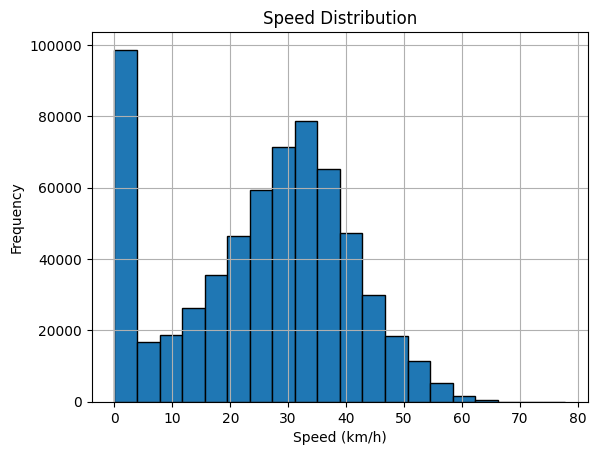

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

speeds = filtered_df['speed']

plt.hist(speeds, bins=20, edgecolor='black')
plt.title("Speed Distribution")
plt.xlabel("Speed (km/h)")
plt.ylabel("Frequency")
plt.grid()
plt.show()

In [ ]:
import sys
sys.path.append('/content/drive/MyDrive/eager_project')  # Adjust this path to your module's location


## Importing Mazi's work

In [ ]:
from geopy.distance import geodesic


segments_gdf_exploded_lengths = segments_gdf_exploded.copy()

def get_cell_length_meters(line_string):
  pt1 = line_string.coords[0]
  pt2 = line_string.coords[-1]
  return geodesic(pt1, pt2).meters

for index, row in segments_gdf_exploded_lengths.iterrows():
  for column in segments_gdf_exploded_lengths.columns[segments_gdf_exploded_lengths.columns.str.contains("cell_")]:
    if row[column] is not None:
      segments_gdf_exploded_lengths.at[index, column] = get_cell_length_meters(row[column])


# Some functions that will be used as tool, often used.
class CTMParameters:
    def __init__(self, vehicle_length=5, free_flow_speed=15, wave_speed=5, num_lanes=3):
        """
        Initialize the parameters for the Cell Transmission Model.

        Args:
            cell_length (float): Length of each cell (meters).
            free_flow_speed (float): Free flow speed (meters/second).
            wave_speed (float): Backward wave speed (meters/second).
            jam_density (float): Maximum density (vehicles/meter).
        """
        # Default parameter values
        self.num_lanes = num_lanes
        # self.cell_length = cell_length
        self.vehicle_length = vehicle_length
        self.free_flow_speed = free_flow_speed
        self.wave_speed = wave_speed
        # self.jam_density = 150/1000 * cell_length * self.num_lanes
        self.jam_density_link = 130  # jam density for the link: 130 vehicles per km
        self.jam_density_FD = 150 * self.num_lanes # jam density for the road, vehciles per km
        self.max_flow_link = 2000 / 3600 * self.num_lanes # vehicle per seconds


        self.max_flow_link = 2000 / 3600 * self.num_lanes # vehicle per seconds



    def max_flow(self, cell_length):
        """
        Calculate the maximum flow in the system based on the fundamental diagram.

        Returns:
            float: Maximum flow (vehicles/second).
        """
        return min(1800, min(self.free_flow_speed, self.wave_speed) * self.get_jam_density(cell_length) * self.num_lanes)

    def get_time_step(self, cell_length):

    # """
    # Calculate the time step for the simulation.

    # Returns:
    #     float: Time step (seconds).
    # """
        return cell_length / self.free_flow_speed

    def get_jam_density(self, cell_length):
         return 150/1000 * cell_length * self.num_lanes

import math
# Notes for Maziar:
## Do not use CTMParameters().object at all! If you use it, it will create a new object every time you call it. Instead, use the instance that you make of it!
## Try avoidng using the istance of CTMParemeters as a global object. Instead, pass it as an argument to the functions that need it.
## The docstring could be formatted for clarity: 1- Mention all parameters and their expected types! 2- Include an explanation of the function's output!
## Check for invalid or empty densities.
## Use descriptive variable names for better readability.
## Avoid magic numbers like 1 for the green light status; use constants instead.

# ctm_params = CTMParameters() # in this example, we use the default parameters

## Cell transmission model: update cell density
# arguments: densities: list of float + ctm_params: CTMParameters + entry_flow: float (flow of the first cell of the segment which comes from previous segments' outflow)
# " inflow is the number of vehicles enter from the previous cell to the current cell in one step"
# " outflow is the number of vehicles exit from the current cell to the next cell in one step"
# assumptions: jam density and max flow are constant for all cells

cell_lengths = {
  link_id:segments_gdf_exploded_lengths[segments_gdf_exploded_lengths["link_id"] == link_id].iloc[0]["cell_1"] for link_id in segments_gdf_exploded_lengths["link_id"].unique()
}

def update_cell_status(time, segment_id, densities, ctm_params, entry_flow, traffic_lights_df, traffic_lights_dict_states):
    num_cells = len(densities)
    new_densities = densities.copy()
    cell_length = cell_lengths[segment_id]
    dt = ctm_params.get_time_step(cell_length)
    for i in range(num_cells):  # iterate over all cells
        if i == 0:      # first cell
            inflow = entry_flow # no inflow
        else:           # for all other cells: minimum of max flow and the flow from the previous cell
            inflow = min(ctm_params.max_flow(cell_length), ctm_params.free_flow_speed * densities[i-1] * dt, ctm_params.wave_speed * (ctm_params.get_jam_density(cell_length) - densities[i]) * dt)

        if i == num_cells - 1:  # last cell
            # check if there is a traffic light at the end of the segment
            if is_tl(segment_id, traffic_lights_df):
                # check the status of the traffic light
                if tl_status(time, segment_id, traffic_lights_df, traffic_lights_dict_states) == 1: # green light
                    outflow = min(ctm_params.max_flow(cell_length), ctm_params.free_flow_speed * densities[i] * dt, math.inf)
                else:
                    outflow = 0
            else:
                outflow = min(ctm_params.max_flow(cell_length), ctm_params.free_flow_speed * densities[i] * dt, math.inf)
        else:               # for all other cells: minimum of max flow and the flow to the next cell
            outflow = min(ctm_params.max_flow(cell_length), ctm_params.free_flow_speed * densities[i] * dt, ctm_params.wave_speed * (ctm_params.get_jam_density(cell_length) - densities[i+1]) * dt)

        new_densities[i] = densities[i] + (inflow - outflow) / cell_length   # n(t+1) = n(t) + (y(i) - y(i+1))/dx

    return new_densities

# test the function
# Density = [0.1, 0.15, 0, 0.2, 0.1, 0.1]
# entry_flow = 0
# time = 5
# updated_density = update_cell_status(time, 1, Density, ctm_params, entry_flow)
# print(updated_density)

def traffic_light(segment_id, time):
    pass # To Kian

# # test the function
# den = [0,0 ,0 , 0, 0]
# print(veh_to_density(den, 20))
# returns whether there is a traffic light at the end of the segment or not
def is_tl(segment_id, traffic_lights_df):
    if segment_id in traffic_lights_df.nearest_link_id.values:
        return True
    return False

# returns status of the traffic light, green = 1, red = 0
# note for Amir: you probably need to add (time, segment id) arguments to this function
def tl_status(time, segment_id, traffic_lights_df, traffic_lights_dict_states):

    # Now lets find the traffic light id in that segment
    if segment_id in traffic_lights_df.nearest_link_id.values:
        tl_id = traffic_lights_df[traffic_lights_df.nearest_link_id == segment_id].index[0]
    # Extract the dataframe out of that dictionary that I made in the ctm_model.ipynb
    traffic_light_status_df = traffic_lights_dict_states[tl_id]
    # Finding the closest time to the given time
    closest_idx = (traffic_light_status_df['time'] - time).abs().idxmin()
    # Getting the status of the traffic light at that time
    status = traffic_light_status_df.loc[closest_idx, 'traffic_status']
    if status == "green":
        return 1
    else:
        return 0

def initialize_density(num_cells, initial_density=0):
    """
    Initialize densities for each cell in the segment.

    Args:
        segment_length (float): Total length of the segment (meters).
        cell_length (float): Length of each cell (meters).
        initial_density (float): Initial density for each cell (vehicles/meter).

    Returns:
        list of float: Initial densities for each cell.
    """

    # Create a list of densities for all cells
    densities = [initial_density] * num_cells

    return densities

# Initialize CTM parameters
ctm_params = CTMParameters()
ctm_params.segment_length = segments_gdf_exploded["length"].mean()

## Calculating free flow speed

In [ ]:
import numpy as np
free_flow_threshold = 25
free_flow_speeds = speeds[speeds > free_flow_threshold]

mean_speed = np.mean(free_flow_speeds)
percentile_85 = np.percentile(free_flow_speeds, 85)

print(f"Free Flow Speed (Mean): {mean_speed} km/h")
print(f"Free Flow Speed (85th Percentile): {percentile_85} km/h")
percentile_85_m_s = percentile_85/3.6
ctm_params.free_flow_speed = percentile_85_m_s


Free Flow Speed (Mean): 36.159008313885955 km/h
Free Flow Speed (85th Percentile): 44.15619 km/h


## intializing the variables

In [ ]:
def find_traffic_light_id(row, segments_gdf):
    """
    Find the nearest segment ID to a given row in a DataFrame.

    Args:
        row (pd.Series): Row in a DataFrame with columns 'lat' and 'lon'.
        segments_gdf (gpd.GeoDataFrame): GeoDataFrame with segment geometries.

    Returns:
        int: ID of the nearest segment.
    """
    # Create a GeoDataFrame for the point
    point = gpd.GeoDataFrame(
        # Make sure lat and lon is given completely right! Lat first then lon
        geometry=[loads(f"POINT ({row['lat']} {row['lon']})")], crs="EPSG:4326"
    )

    # Reproject both point and segments to a projected CRS for accurate distance calculations
    projected_crs = "EPSG:4326"  # Common projected CRS for distance calculations
    point_proj = point.to_crs(projected_crs)
    segments_gdf_proj = segments_gdf.to_crs(projected_crs)
    max_distance = float("inf")
    nearest_link_id = None
    for index, row in segments_gdf_proj.iterrows():
        distance = row.geometry.distance(point_proj.geometry[0])
        if distance < max_distance:
            max_distance = distance
            nearest_link_id = index
    return nearest_link_id

### Initialization of the density prediction container
segment_densities_predicted = {link_id: initialize_density(
                                                       segments_gdf_exploded[segments_gdf_exploded["link_id"] == link_id].iloc[0, segments_gdf_exploded.columns.str.startswith("cell_")].notna().sum())
                                                       for link_id in segments_gdf_exploded["link_id"].unique()}
# find traffic light segment id
traffic_lights_df["nearest_link_id"] = traffic_lights_df.apply(find_traffic_light_id,
                                                               axis=1,
                                                               segments_gdf=gpd.GeoDataFrame(
                                                                   segments_gdf_exploded,
                                                                   geometry="geometry",
                                                                   crs="EPSG:4326")
                                                               )
traffic_lights_df = traffic_lights_df.iloc[:5, :]


## Running the CTM model

In [ ]:
from tqdm import tqdm
def get_density_for_time(link_id, time, veh_density_flow):
    t0 = time
    density_t0 = veh_density_flow[(veh_density_flow["link_id"] == link_id) & (veh_density_flow["time"] == t0)]
    density_t0_initialized = segment_densities_predicted[link_id].copy()
    for index, row in density_t0.iterrows():
        density_t0_initialized[int(row["closest_cell"].split("_")[-1])-1] = row["density"]

    t1 = t0 + ctm_params.get_time_step(cell_lengths[link_id])

    closest_t1 = veh_density_flow[veh_density_flow["time"] >= t1].sort_values("time")
    if not closest_t1.empty:
        closest_t1 = closest_t1.iloc[0].time
        density_t1 = veh_density_flow[(veh_density_flow["link_id"] == link_id) & (veh_density_flow["time"] ==closest_t1)]
    else:
        density_t1 = pd.DataFrame(columns=["link_id", "time", "closest_cell", "density"])


    density_t1_initialized = segment_densities_predicted[link_id].copy()
    for index, row in density_t1.iterrows():
        density_t1_initialized[int(row["closest_cell"].split("_")[-1])-1] = row["density"]
    density_t1_initialized = np.array(density_t1_initialized)
    density_t0_initialized = np.array(density_t0_initialized)

    return density_t0_initialized, density_t1_initialized
actual_values_dict = {}
predicted_values_dict = {}
rmses_dict = {}
times_dict = {}
predict_mean_dict = {}
actual_mean_dict = {}

incoming = 0  # maz
heatmap_data_maz = []

for link_id in veh_density_flow["link_id"].unique():
    rmses = []
    times = []
    predict_mean = []
    actual_mean = []
    predicted_values = []
    actual_values = []
    unique_times = veh_density_flow[veh_density_flow["link_id"] == link_id]["time"].unique()
    for unique_time in tqdm(unique_times, unit="time"):
        density_t0_initialized, density_t1_initialized = get_density_for_time(link_id, unique_time, veh_density_flow)
        inflow_dt = veh_density_flow[((veh_density_flow["time"] >= unique_time) &
         (veh_density_flow["time"] <= unique_time+ctm_params.get_time_step(cell_lengths[link_id]))) &
          (veh_density_flow["link_id"] == link_id)]

        # print("inflow is " , inflow_dt["entry"].values[0] * ctm_params.time_step)
        if inflow_dt.empty:
            inflow_dt = 0
        else:
            inflow_dt = inflow_dt["entry"].sum() / ctm_params.get_time_step(cell_lengths[link_id])

        # heatmap_data_maz.append([link_id, unique_time, inflow_dt])


        predicted_den = np.array(update_cell_status(unique_time, link_id, density_t0_initialized, ctm_params, inflow_dt, traffic_lights_df, traffic_lights_dict_states))
        predict_mean.append(predicted_den[:].mean())
        predicted_value = predicted_den[:]
        actual_value = density_t1_initialized[:]

        rmse = np.sqrt(np.mean((predicted_value - actual_value)**2))
        predicted_values.append(predicted_value)
        actual_values.append(actual_value)
        actual_mean.append(density_t0_initialized[:].mean())
        rmses.append(rmse)
        times.append(unique_time)
    actual_values_dict[link_id] = actual_values
    predicted_values_dict[link_id] = predicted_values
    rmses_dict[link_id] = rmses
    times_dict[link_id] = times
    predict_mean_dict[link_id] = predict_mean
    actual_mean_dict[link_id] = actual_mean

100%|██████████| 18575/18575 [20:21<00:00, 15.21time/s]


## Saving the results

In [ ]:
import pickle

# Save the dictionaries to a pickle file
with open("drive/MyDrive/eager_project/ctm_results.pkl", "wb") as f:
    pickle.dump({
        "actual_values_dict": actual_values_dict,
        "predicted_values_dict": predicted_values_dict,
        "rmses_dict": rmses_dict,
        "times_dict": times_dict,
        "predict_mean_dict": predict_mean_dict,
        "actual_mean_dict": actual_mean_dict
    }, f)

print("Dictionaries saved to ctm_results.pkl")


Dictionaries saved to ctm_results.pkl


## Loading CTM model

In [ ]:
import pickle

# Load the dictionaries from the pickle file
with open("drive/MyDrive/eager_project/ctm_results.pkl", "rb") as f:
    data = pickle.load(f)

# Extract individual dictionaries
actual_values_dict = data["actual_values_dict"]
predicted_values_dict = data["predicted_values_dict"]
rmses_dict = data["rmses_dict"]
times_dict = data["times_dict"]
predict_mean_dict = data["predict_mean_dict"]
actual_mean_dict = data["actual_mean_dict"]

print("Dictionaries successfully loaded!")


Dictionaries successfully loaded!


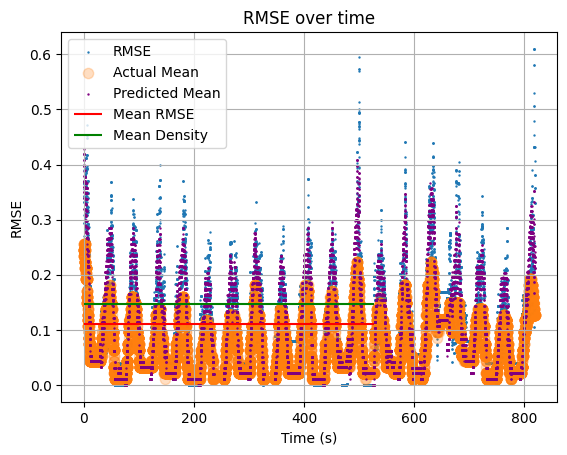

For link with id:  0  the RMSE is:  0.11027150264173102


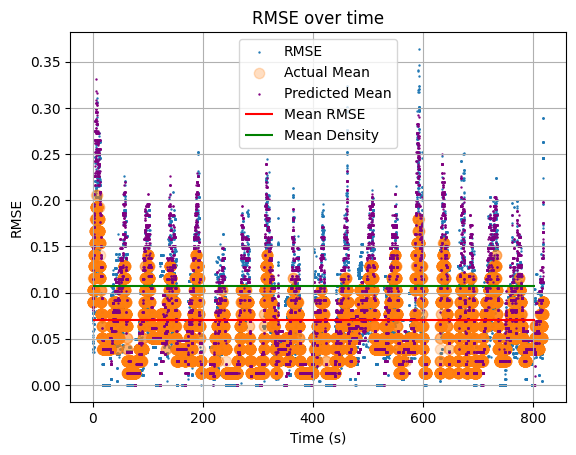

For link with id:  1  the RMSE is:  0.07068255986883643


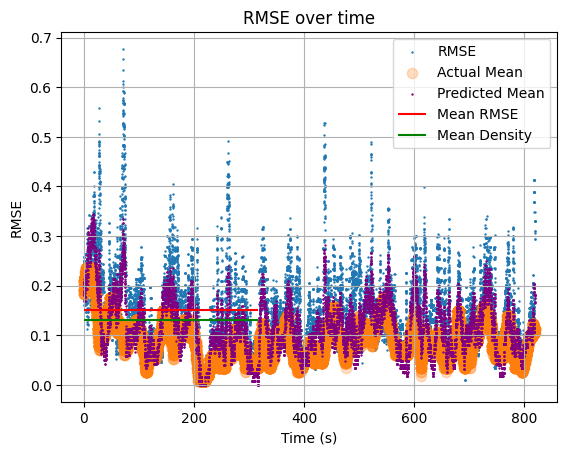

For link with id:  2  the RMSE is:  0.1517021516850761


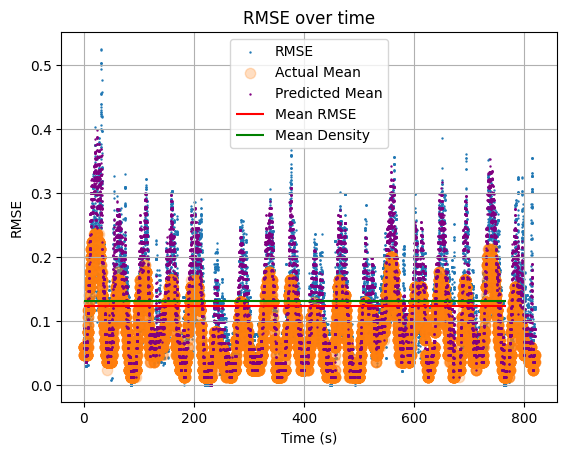

For link with id:  3  the RMSE is:  0.12407688338115505


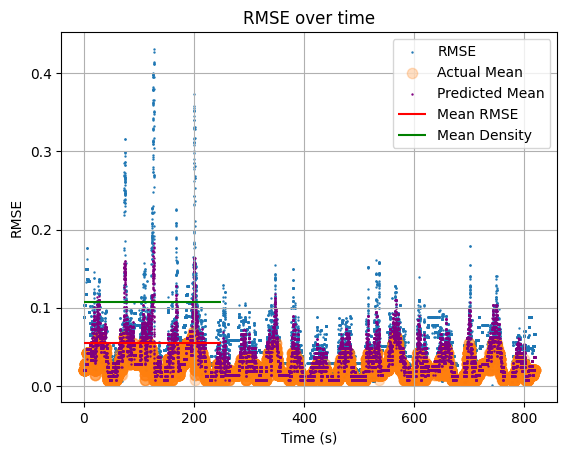

For link with id:  4  the RMSE is:  0.05506748148316247


In [ ]:
from collections import defaultdict

all_rmses = defaultdict(lambda : defaultdict(list))
for link_id in veh_density_flow["link_id"].unique():
    times = times_dict[link_id]
    rmses = rmses_dict[link_id]
    predict_mean = predict_mean_dict[link_id]
    actual_mean = actual_mean_dict[link_id]

    plt.scatter(times[:], rmses[:], label="RMSE", s=0.5)
    plt.scatter(times[:], actual_mean[:], label="Actual Mean", s=55, alpha=0.25)
    plt.scatter(times[:], predict_mean[:], label="Predicted Mean", s=0.5, color="purple", alpha=1)
    plt.xlabel("Time (s)")
    plt.ylabel("RMSE")
    plt.title("RMSE over time")
    plt.hlines(np.mean(rmses), times[0], times[-1], label="Mean RMSE", color="red")
    plt.hlines(veh_density_flow[veh_density_flow["link_id"] == link_id].density.mean(), times[0], times[-1], label="Mean Density", color="green")
    plt.grid()
    plt.legend()
    plt.show()
    print("For link with id: ", link_id, " the RMSE is: ", np.mean(rmses))

In [ ]:
from collections import defaultdict

import plotly.express as px
import plotly.graph_objects as go

heatmap_data_error = defaultdict(lambda : defaultdict(list))
heatmap_data_actual = defaultdict(lambda : defaultdict(list))
heatmap_data_precicted = defaultdict(lambda : defaultdict(list))
min_i = 0
for link_id in times_dict.keys():
    for time_index in range(len(times_dict[link_id])):
        time = times_dict[link_id][time_index]
        a = actual_values_dict[link_id][time_index]
        p = predicted_values_dict[link_id][time_index]
        e2 = abs(a-p)
        heatmap_data_error[link_id][time] = e2
        heatmap_data_actual[link_id][time] = a
        heatmap_data_precicted[link_id][time] = p

data_list_error = []
data_list_actual = []
data_list_predicted = []
for link_id, time_dict in heatmap_data_error.items():
    for time, values in time_dict.items():
        for cell_idx, value in enumerate(values):
            data_list_error.append({"link_id": link_id, "time": time, "cell": cell_idx + 1, "value": value})

for link_id, time_dict in heatmap_data_actual.items():
    for time, values in time_dict.items():
        for cell_idx, value in enumerate(values):
            data_list_actual.append({"link_id": link_id, "time": time, "cell": cell_idx + 1, "value": value})

for link_id, time_dict in heatmap_data_precicted.items():
    for time, values in time_dict.items():
        for cell_idx, value in enumerate(values):
            data_list_predicted.append({"link_id": link_id, "time": time, "cell": cell_idx + 1, "value": value})

df_error = pd.DataFrame(data_list_error)
df_actual = pd.DataFrame(data_list_actual)
df_predicted = pd.DataFrame(data_list_predicted)

## CTM Error Heatmap

In [ ]:
min_value = df_error["value"].min()
max_value = df_error["value"].max()
for name, group in df_error.groupby("link_id"):
  group = group[group["cell"] != 1]
  fig = go.Figure(data=go.Heatmap(
      z=group["value"].values,
      x=group["cell"].values,
      y=group["time"].values,
      colorscale="Reds",

  ))
  fig.update_layout(
      title=f"Error Heatmap - Link ID {name}",  # Dynamic title per link_id
      xaxis_title="Cell Index",
      yaxis_title="Time",
      font=dict(size=14)  # Adjust font size for better readability
  )

  fig.show()

## CTM Actual Heatmap

In [ ]:
min_value = df_actual["value"].min()
max_value = df_actual["value"].max()
for name, group in df_actual.groupby("link_id"):

  fig = go.Figure(data=go.Heatmap(
      z=group["value"].values,
      x=group["cell"].values,
      y=group["time"].values,
      colorscale="Reds",
      zmin=min_value,
      zmax=max_value
  ))
  fig.update_layout(
      title=f"Actual Heatmap - Link ID {name}",  # Dynamic title per link_id
      xaxis_title="Cell Index",
      yaxis_title="Time",
      font=dict(size=14)  # Adjust font size for better readability
  )

  fig.show()

## CTM Predicted Heatmap

In [ ]:
min_value = df_predicted["value"].min()
max_value = df_predicted["value"].max()
for name, group in df_predicted.groupby("link_id"):

  fig = go.Figure(data=go.Heatmap(
      z=group["value"].values,
      x=group["cell"].values,
      y=group["time"].values,
      colorscale="Reds",
      zmin=min_value,
      zmax=max_value
  ))
  fig.update_layout(
      title=f"Predicted Heatmap - Link ID {name}",  # Dynamic title per link_id
      xaxis_title="Cell Index",
      yaxis_title="Time",
      font=dict(size=14)  # Adjust font size for better readability
  )

  fig.show()

# Point Queue Model

In [ ]:
df_filtered = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_segmented_oneaxistrajectory_cell.csv")
veh_density_flow = pd.read_csv("drive/MyDrive/eager_project/20181024_d1_0830_0900_veh_density_flow.csv")

# grouped_with_veh_ids = df_filtered.groupby(["link_id", "time"]).agg({
#     "veh_id": lambda x: frozenset(x)  # Use frozenset instead of set
# }).reset_index()

# df_filtered = df_filtered.merge(grouped_with_veh_ids, on=["link_id", "time"], suffixes=('', '_list'))
# df_filtered.rename(columns={"veh_id_list": "veh_id_list"}, inplace=True)
# duplicate_dropped = df_filtered.drop_duplicates(subset=["link_id", "time", "veh_id_list"])[["veh_id_list", "link_id", "time"]]
# link_dataframes = {}
# duplicate_dropped.columns = [f"{col}_{i}" if duplicate_dropped.columns.duplicated()[i] else col for i, col in enumerate(duplicate_dropped.columns)]
# for link_id in duplicate_dropped["link_id"].unique():


#     segment_df = duplicate_dropped[duplicate_dropped["link_id"] == link_id].reset_index().drop(columns=["index"])
#     segment_df = segment_df.sort_values("time")

#     segment_df["N_down"] = segment_df["veh_id_list"] - segment_df["veh_id_list"].shift(1)
#     segment_df["N_up"] = segment_df["veh_id_list"].shift(-1) - segment_df["veh_id_list"]

#     segment_df["N_cumsum_down"] = segment_df["N_down"].iloc[1:].apply(len).cumsum()
#     segment_df["N_cumsum_up"] = segment_df["N_up"].iloc[:-1].apply(len).cumsum()

#     link_dataframes[link_id] = segment_df


In [ ]:
veh_density_flow["veh_ids"] = veh_density_flow["veh_ids"].apply(lambda x: ast.literal_eval(x))

In [ ]:
veh_density_flow["count"] = veh_density_flow["veh_ids"].apply(len)

In [ ]:
link_dataframes = {}
duplicate_dropped = veh_density_flow.groupby(["time","link_id"])[["entry", "exit", "count"]].sum().reset_index()
for link_id in duplicate_dropped["link_id"].unique():
  segment_df = duplicate_dropped[duplicate_dropped["link_id"] == link_id].reset_index().drop(columns=["index"])
  segment_df = segment_df.sort_values("time")
  segment_df["N_down"] = segment_df["exit"]
  segment_df["N_up"] = segment_df["entry"]
  segment_df["N_cumsum_down"] = segment_df["N_down"].iloc[1:].cumsum()
  segment_df["N_cumsum_up"] = segment_df["N_up"].iloc[:-1].cumsum()
  link_dataframes[link_id] = segment_df

In [ ]:
import math
def cumulativecount_up(time, link_id):
    segment_df = link_dataframes[link_id]
    closest_time = segment_df[segment_df['time'] <= time].time.max()
    if math.isnan(closest_time):
        return 0
    return segment_df[segment_df['time'] == closest_time]["N_cumsum_up"].values[0]

def cumulativecount_down(time, link_id):
    segment_df = link_dataframes[link_id]
    closest_time = segment_df[segment_df['time'] <= time].time.max()
    if math.isnan(closest_time):
        return 0
    return segment_df[segment_df['time'] == closest_time]["N_cumsum_down"].values[0]
# Notes for Maziar:
## Do not use CTMParameters().object at all! If you use it, it will create a new object every time you call it. Instead, use the instance that you make of it!
## Try avoidng using the istance of CTMParemeters as a global object. Instead, pass it as an argument to the functions that need it.
## The docstring could be formatted for clarity: 1- Mention all parameters and their expected types! 2- Include an explanation of the function's output!
## Check for invalid or empty densities.
## Use descriptive variable names for better readability.
## Avoid magic numbers like 1 for the green light status; use constants instead.


# load params
ctm_params = CTMParameters() # for now, we use same parameters we had in CTM model
segment_length = segments_gdf_exploded["length"].mean()
# define the function for finding cumulative counts
N_upstr = cumulativecount_up
N_downstr = cumulativecount_down

## Cell transmission model: update cell density
# time: current simulation time
# arguments: N_upstrs: cumulative count of vehicles in upstream at a given time. I'll pass N_downstr(t) and it should tell me the cumulative count
# N_downstr: cumulative count at link downstream at time t (current time)
# entry_flow: for now constant, entering to the link in vehicles per second
# assumptions: jam density and max flow are constant for all cells
def update_point_queue(time, link_id, entry_flow, traffic_lights_df, traffic_lights_dict_states):
    cell_length = cell_lengths[link_id]
    segment_length = segments_gdf_exploded[segments_gdf_exploded["link_id"] == link_id].iloc[0].length
    # check if there is a traffic light at the end of the segment
    if is_tl(link_id, traffic_lights_df):
        # check the status of the traffic light
        if tl_status(time, link_id, traffic_lights_df, traffic_lights_dict_states) == 1: # green light
            # find the link sending flow using point queue model
            sending_flow = min( N_upstr(time + ctm_params.get_time_step(cell_length) - (segment_length/ctm_params.free_flow_speed), link_id) - N_downstr(time , link_id), ctm_params.max_flow(cell_length)*ctm_params.get_time_step(cell_length))
        else:
            sending_flow = 0
    else: # no traffic light at the end of the link
        sending_flow = min( N_upstr(time + ctm_params.get_time_step(cell_length) - (segment_length/ctm_params.free_flow_speed), link_id) - N_downstr(time , link_id), ctm_params.max_flow(cell_length)*ctm_params.get_time_step(cell_length))

    # find the number of vehicles in the link at the next time step
    n_current =  N_upstr(time, link_id) - N_downstr(time, link_id)   # current number of vehicles

    n_updated = n_current + entry_flow * ctm_params.get_time_step(cell_length) -  sending_flow
    if n_updated < 0:
        print("n_current", n_current, "sending flow", sending_flow, "entry flow", entry_flow, "time", time)
        print("N DOWNSTR is", N_upstr(time, link_id)  ,"at this time N special is", N_upstr(time + ctm_params.get_time_step(cell_length) - (segment_length/ctm_params.free_flow_speed), link_id))

    link_outflow = sending_flow
    link_density = n_updated / segment_length
    return link_density, link_outflow    # please note the   order ## I will:)


In [ ]:
len(duplicate_dropped[duplicate_dropped["link_id"] == 4].time.unique())

18575

In [ ]:
from collections import defaultdict
from tqdm import tqdm
point_queue_data = defaultdict(dict)

for link_id in duplicate_dropped["link_id"].unique():
    segment_df = duplicate_dropped[duplicate_dropped["link_id"] == link_id].reset_index().drop(columns=["index"])
    segment_df = segment_df.sort_values("time")
    for time in tqdm(segment_df["time"].unique(), unit="time"+f" {link_id}"):

        inflow_dt = veh_density_flow[((veh_density_flow["time"] >= time) &
         (veh_density_flow["time"] <= time+ctm_params.get_time_step(cell_lengths[link_id]))) &
          (veh_density_flow["link_id"] == link_id)]

        # print("inflow is " , inflow_dt["entry"].values[0] * ctm_params.time_step)
        if inflow_dt.empty:
            inflow_dt = 0
        else:
            inflow_dt = inflow_dt["entry"].sum() / ctm_params.get_time_step(cell_lengths[link_id])

        link_density, link_outflow = update_point_queue(time, link_id, inflow_dt, traffic_lights_df, traffic_lights_dict_states)

        point_queue_data[link_id][time] = {"link_density": link_density, "link_outflow": link_outflow}
        # print(time, link_id, "done")
duplicate_dropped["point_queue_predicted_density"] = duplicate_dropped.apply(lambda x: point_queue_data[x["link_id"]][x["time"]]["link_density"], axis=1).fillna(0)

100%|██████████| 18575/18575 [01:52<00:00, 164.87time 4/s]


In [ ]:
duplicate_dropped["density"] = duplicate_dropped.reset_index().apply(lambda row: row["count"]/(segments_gdf_exploded[segments_gdf_exploded["link_id"] == row["link_id"]]["length"].values[0]), axis=1)

In [ ]:
for link_id in sorted(duplicate_dropped["link_id"].unique()):
    rmse = np.sqrt(np.mean((duplicate_dropped[duplicate_dropped["link_id"] == link_id]["density"] - duplicate_dropped[duplicate_dropped["link_id"] == link_id]["point_queue_predicted_density"])**2))
    print("For link with id: ", link_id, " the RMSE is: ", rmse)

For link with id:  0  the RMSE is:  0.19495618008416607
For link with id:  1  the RMSE is:  0.1382981217225281
For link with id:  2  the RMSE is:  0.3605649915673525
For link with id:  3  the RMSE is:  0.14352109496561286
For link with id:  4  the RMSE is:  0.12547897118931953


## Point Queue Heatmap

In [ ]:
import plotly.graph_objects as go
import pandas as pd

duplicate_dropped2 = duplicate_dropped.copy()
duplicate_dropped2["e2"] = (duplicate_dropped2["point_queue_predicted_density"] - duplicate_dropped2["density"])**2

unique_links = duplicate_dropped2["link_id"].unique()
unique_times = duplicate_dropped2["time"].unique()

full_grid = pd.MultiIndex.from_product([unique_links, unique_times], names=["link_id", "time"]).to_frame(index=False)

filled_data = full_grid.merge(duplicate_dropped2, on=["link_id", "time"], how="left").fillna({"e2": 0})

fig = go.Figure(data=go.Heatmap(
    z=filled_data["e2"].values,
    x=filled_data["link_id"].values,
    y=filled_data["time"].values,
    colorscale="Reds",
    zmin=filled_data["e2"].min(),
    zmax=filled_data["e2"].max()
))

fig.update_layout(
    title="Error Heatmap for Point Queue",
    xaxis_title="Cell Index",
    yaxis_title="Time",
    font=dict(size=14),
    coloraxis_colorbar=dict(title="Value")
)

fig.show()


In [ ]:
# prompt: store0 duplicated_dropped dataframe  for point queue

import pandas as pd
import pickle
# Assuming 'duplicate_dropped' DataFrame is already defined and populated as in your provided code

# Save the dataframe to a pickle file
with open("drive/MyDrive/eager_project/duplicated_dropped_dataframe_pq.pkl", "wb") as f:
    pickle.dump(duplicate_dropped, f)

print("DataFrame saved to duplicated_dropped_dataframe_pq.pkl")


DataFrame saved to duplicated_dropped_dataframe_pq.pkl


In [ ]:
# prompt: load duplicated_dropped dataframe for point queue

import pickle

# Load the dataframe from the pickle file
with open("drive/MyDrive/eager_project/duplicated_dropped_dataframe_pq.pkl", "rb") as f:
    duplicate_dropped = pickle.load(f)

print("DataFrame successfully loaded!")


DataFrame successfully loaded!


# Spatial Queue

In [ ]:
# from constants import CTMParameters
import math

# Notes for Maziar:
## Do not use CTMParameters().object at all! If you use it, it will create a new object every time you call it. Instead, use the instance that you make of it!
## Try avoidng using the istance of CTMParemeters as a global object. Instead, pass it as an argument to the functions that need it.
## The docstring could be formatted for clarity: 1- Mention all parameters and their expected types! 2- Include an explanation of the function's output!
## Check for invalid or empty densities.
## Use descriptive variable names for better readability.
## Avoid magic numbers like 1 for the green light status; use constants instead.


# load params
ctm_params = CTMParameters() # for now, we use same parameters we had in CTM model

# define the function for finding cumulative counts
N_upstr = cumulativecount_up
N_downstr = cumulativecount_down

## spatial queue model: update number of vehicles in the link
# time: current simulation time
# arguments: N_upstrs: cumulative count of vehicles in upstream at a given time. I'll pass N_downstr(t) and it should tell me the cumulative count
# N_downstr: cumulative count at link downstream at time t (current time)
# entry_flow: for now constant, average number of vehicles entering to the link in vehicles per second
# assumptions: queue forms at the link downstream
def update_spatial_queue(time, link_id, entry_flow, traffic_lights_df, traffic_lights_dict_states):
    cell_length = cell_lengths[link_id]
    segment_length = segments_gdf_exploded[segments_gdf_exploded["link_id"] == link_id].iloc[0].length
    #find the receiving flow, including the entry flow
    receceiving_flow = min( entry_flow*ctm_params.get_time_step(cell_length), segment_length*ctm_params.get_jam_density(cell_length) - (N_upstr(time,link_id) - N_downstr(time,link_id)), ctm_params.max_flow(cell_length)*ctm_params.get_time_step(cell_length))

    # check if there is a traffic light at the end of the segment
    if is_tl(link_id, traffic_lights_df):
        # check the status of the traffic light
        if tl_status(time, link_id, traffic_lights_df, traffic_lights_dict_states) == 1: # green light
            # find the link sending flow using point queue model
            sending_flow = min( N_upstr(time + ctm_params.get_time_step(cell_length) - (segment_length/ctm_params.free_flow_speed), link_id) - N_downstr(time, link_id), ctm_params.max_flow(cell_length)*ctm_params.get_time_step(cell_length))
        else:
            sending_flow = 0
    else: # no traffic light at the end of the link
        sending_flow = min( N_upstr(time + ctm_params.get_time_step(cell_length) - (segment_length/ctm_params.free_flow_speed), link_id) - N_downstr(time, link_id), ctm_params.max_flow(cell_length)*ctm_params.get_time_step(cell_length))

    # find the number of vehicles in the link at the next time step
    n_current = N_downstr(time, link_id) - N_upstr(time, link_id)   # current number of vehicles
    n_updated = n_current + receceiving_flow - sending_flow

    link_outflow = sending_flow
    link_density = n_updated / segment_length
    return link_density, link_outflow    # please note the order

# # test the function
# Density = [0.1, 0.15, 0, 0.2, 0.1, 0.1]
# entry_flow = 0.1
# time = 5
# updated_density = update_point_queue(time, 1, Density, ctm_params, entry_flow)
# print(updated_density)

In [ ]:
from collections import defaultdict

spatial_queue_data = defaultdict(dict)

for link_id in duplicate_dropped["link_id"].unique():
    segment_df = duplicate_dropped[duplicate_dropped["link_id"] == link_id].reset_index().drop(columns=["index"])
    segment_df = segment_df.sort_values("time")
    for time in segment_df["time"].unique():

        inflow_dt = veh_density_flow[((veh_density_flow["time"] >= time) &
         (veh_density_flow["time"] <= time+ctm_params.get_time_step(cell_lengths[link_id]))) &
          (veh_density_flow["link_id"] == link_id)]

        # print("inflow is " , inflow_dt["entry"].values[0] * ctm_params.time_step)
        if inflow_dt.empty:
            inflow_dt = 0
        else:
            inflow_dt = inflow_dt["entry"].sum() / ctm_params.get_time_step(cell_lengths[link_id])

        link_density, link_outflow = update_spatial_queue(time, link_id, inflow_dt, traffic_lights_df, traffic_lights_dict_states)

        spatial_queue_data[link_id][time] = {"link_density": link_density, "link_outflow": link_outflow}
        # print(time, link_id, "done")


In [ ]:
duplicate_dropped["spatial_queue_predicted_density"] = duplicate_dropped.apply(lambda x: spatial_queue_data[x["link_id"]][x["time"]]["link_density"], axis=1).fillna(0)
# duplicate_dropped["density"] = duplicate_dropped.reset_index().apply(lambda row: row["count"]/(segments_gdf_exploded[segments_gdf_exploded["link_id"] == row["link_id"]]["length"].values[0]), axis=1)

In [ ]:
for link_id in sorted(duplicate_dropped["link_id"].unique()):
    rmse = np.sqrt(np.mean((duplicate_dropped[duplicate_dropped["link_id"] == link_id]["density"] - duplicate_dropped[duplicate_dropped["link_id"] == link_id]["spatial_queue_predicted_density"])**2))
    print("For link with id: ", link_id, " the RMSE is: ", rmse)

For link with id:  0  the RMSE is:  0.19235083603912656
For link with id:  1  the RMSE is:  0.1333119799348853
For link with id:  2  the RMSE is:  0.32727294353842484
For link with id:  3  the RMSE is:  0.14287703424451903
For link with id:  4  the RMSE is:  0.10804911677743817


In [ ]:
# prompt: store0 duplicated_dropped dataframe  for point queue

import pandas as pd
import pickle
# Assuming 'duplicate_dropped' DataFrame is already defined and populated as in your provided code

# Save the dataframe to a pickle file
with open("drive/MyDrive/eager_project/duplicated_dropped_dataframe_pq_sq.pkl", "wb") as f:
    pickle.dump(duplicate_dropped, f)

print("DataFrame saved to duplicated_dropped_dataframe_pq_sq.pkl")


DataFrame saved to duplicated_dropped_dataframe_pq_sq.pkl


In [ ]:

# prompt: load duplicated_dropped dataframe for point queue

import pickle

# Load the dataframe from the pickle file
with open("drive/MyDrive/eager_project/duplicated_dropped_dataframe_pq_sq.pkl", "rb") as f:
    duplicate_dropped = pickle.load(f)

print("DataFrame successfully loaded!")


DataFrame successfully loaded!


## Spatial Queue Heatmap

In [ ]:
import plotly.graph_objects as go
duplicate_dropped3 = duplicate_dropped.copy()
duplicate_dropped3["e2"] = (duplicate_dropped3["spatial_queue_predicted_density"] - duplicate_dropped3["density"])**2

unique_links = duplicate_dropped3["link_id"].unique()
unique_times = duplicate_dropped3["time"].unique()

full_grid = pd.MultiIndex.from_product([unique_links, unique_times], names=["link_id", "time"]).to_frame(index=False)

filled_data = full_grid.merge(duplicate_dropped3, on=["link_id", "time"], how="left").fillna({"e2": 0})
fig = go.Figure(data=go.Heatmap(
    z=duplicate_dropped3["e2"].values,
    x=duplicate_dropped3["link_id"].values,
    y=duplicate_dropped3["time"].values,
    colorscale="Reds",
    zmin=duplicate_dropped3["e2"].min(),
    zmax=duplicate_dropped3["e2"].max()
))

fig.update_layout(
    title=f"Error Heatmap for Spatial Queue",
    xaxis_title="Cell Index",
    yaxis_title="Time",
    font=dict(size=14),
    coloraxis_colorbar=dict(title="Value")  # Add colorbar title
)

fig.show()

# Comparison

In [ ]:
ctm_actual = pd.DataFrame(data_list_actual)
ctm_predicted = pd.DataFrame(data_list_predicted)

In [ ]:
ctm_merged = ctm_actual.merge(ctm_predicted, on=["link_id", "cell", "time"], suffixes=('_actual', '_predicted'))
ctm_merged["sq_error"] = (ctm_merged["value_actual"] - ctm_merged["value_predicted"])**2

In [ ]:
ctm_merged_rmse = ctm_merged.groupby(by=["link_id", "cell"]).agg({"sq_error": "mean"}).reset_index()
ctm_merged_rmse["rmse"] = np.sqrt(ctm_merged_rmse["sq_error"])
ctm_merged_rmse

,link_id,cell,sq_error,rmse
0,0,1,0.101126,0.318004
1,0,2,0.016777,0.129524
2,0,3,0.001815,0.042607
3,0,4,0.001700,0.041236
4,0,5,0.001564,0.039552
5,0,6,0.003738,0.061138
6,0,7,0.006703,0.081874
7,1,1,0.031261,0.176809
8,1,2,0.001956,0.044223
9,1,3,0.001330,0.036465


In [ ]:
duplicate_dropped["point_queue_sq_error"] = (duplicate_dropped["point_queue_predicted_density"] - duplicate_dropped["density"])**2
duplicate_dropped["spatial_queue_sq_error"] = (duplicate_dropped["spatial_queue_predicted_density"] - duplicate_dropped["density"])**2

In [ ]:
pq_sq_rmse = duplicate_dropped.groupby("link_id").agg({"point_queue_sq_error": "mean", "spatial_queue_sq_error": "mean"}).reset_index()
pq_sq_rmse["pq_rmse"] = np.sqrt(pq_sq_rmse["point_queue_sq_error"])
pq_sq_rmse["sq_rmse"] = np.sqrt(pq_sq_rmse["spatial_queue_sq_error"])
pq_sq_rmse

,link_id,point_queue_sq_error,spatial_queue_sq_error,pq_rmse,sq_rmse
0,0,0.038008,0.036999,0.194956,0.192351
1,1,0.019126,0.017772,0.138298,0.133312
2,2,0.130007,0.107108,0.360565,0.327273
3,3,0.020598,0.020414,0.143521,0.142877
4,4,0.015745,0.011675,0.125479,0.108049


## Comparison Plot

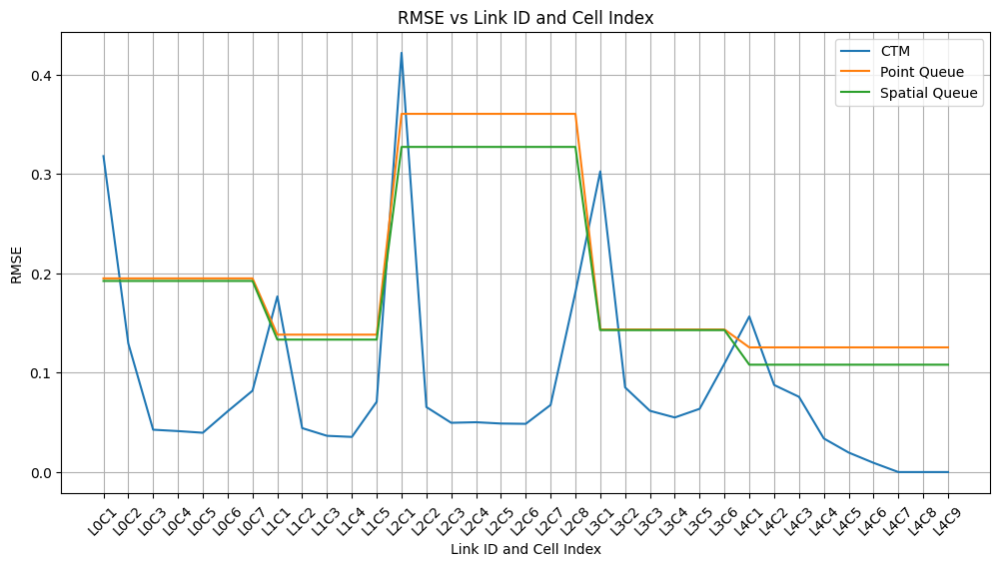

In [ ]:
import matplotlib.pyplot as plt
import re
x = ctm_merged_rmse.apply(lambda row: "L" + str(int(row["link_id"])) + "C" + str(int(row["cell"])), axis=1)
y = ctm_merged_rmse["rmse"]
plt.figure(figsize=(12, 6))
plt.plot(x, y, label="CTM")

plt.xticks(rotation=45)
plt.xlabel("Link ID and Cell Index")
plt.ylabel("RMSE")
plt.title("RMSE vs Link ID and Cell Index")

x_pq_sq = [int(re.findall(r"L(?P<link_id>\d)", l)[0]) for l in x]
y_pq = [pq_sq_rmse[pq_sq_rmse["link_id"] == l]["pq_rmse"].values[0] for l in x_pq_sq]
x_sq = [pq_sq_rmse[pq_sq_rmse["link_id"] == l]["sq_rmse"].values[0] for l in x_pq_sq]
plt.plot(x, y_pq, label="Point Queue")
plt.plot(x, x_sq, label="Spatial Queue")
plt.grid()
plt.legend()
plt.show()
